## Setup

In [1]:
%run setup.ipynb
%aimport peakfit
rcParams['figure.dpi'] = 120

In [2]:
df_h12 = phase1_selection.hstats_windowed
df_h12.head(10)

AOM       BFM       BFS       CMS  GAS       GNS  \
chrom start  stop                                                       
2L    1      20000   NaN       NaN       NaN       NaN  NaN       NaN   
      20001  40000   NaN       NaN       NaN       NaN  NaN       NaN   
      40001  60000   NaN       NaN       NaN       NaN  NaN       NaN   
      60001  80000   NaN       NaN       NaN       NaN  NaN       NaN   
      80001  100000  NaN       NaN       NaN       NaN  NaN       NaN   
      100001 120000  NaN       NaN       NaN       NaN  NaN       NaN   
      120001 140000  NaN       NaN       NaN       NaN  NaN       NaN   
      140001 160000  NaN       NaN       NaN       NaN  NaN       NaN   
      160001 180000  NaN  0.431632  0.769395  0.093488  NaN  0.817898   
      180001 200000  NaN  0.481516  0.769242  0.106883  NaN  0.846514   

                          GWA       UGS  
chrom start  stop                        
2L    1      20000        NaN       NaN  
      20001  40000        NaN       NaN  
      40001  60000        NaN       NaN  
      60001  80000        NaN       NaN  
      80001  100000       NaN       NaN  
      100001 120000       NaN       NaN  
      120001 140000       NaN       NaN  
      140001 160000       NaN       NaN  
      160001 180000  0.049386  0.706240  
      180001 200000  0.049386  0.706146

## Check signals

In [3]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df_h12, seqid=('2R', '2L'), genome=genome, values_col='BFS', seqid_col='chrom', starts_col='start', ends_col='stop')

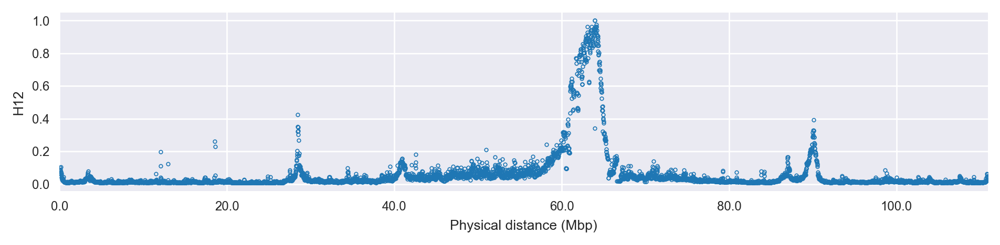

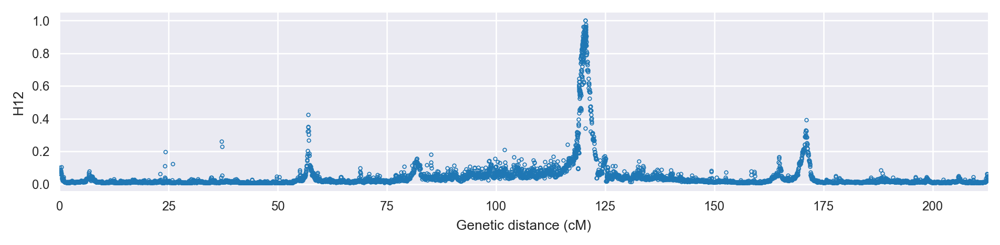

In [4]:
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12');
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12', gmap=gmap['2']);

## Check peak fitters

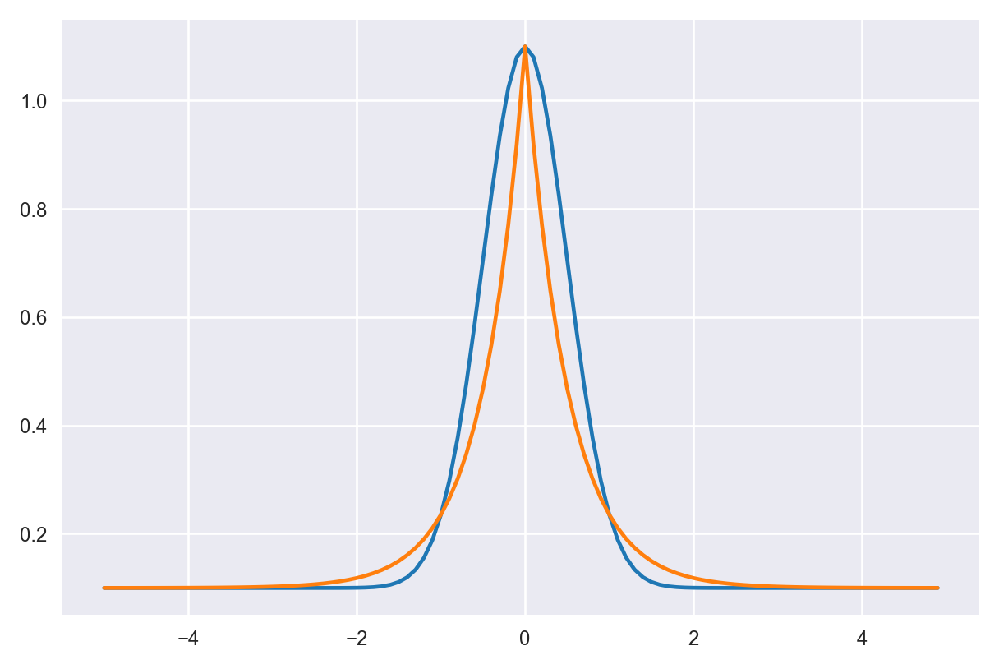

In [5]:
x = np.arange(-5, 5, .1)
y1 = peakfit.gaussian(x, center=0, amplitude=1, sigma=.5, baseline=.1, floor=0, ceiling=100)
y2 = peakfit.exponential_peak(x, center=0, amplitude=1, decay=.5, baseline=.1, floor=0, ceiling=100)
plt.plot(x, y1)
plt.plot(x, y2);


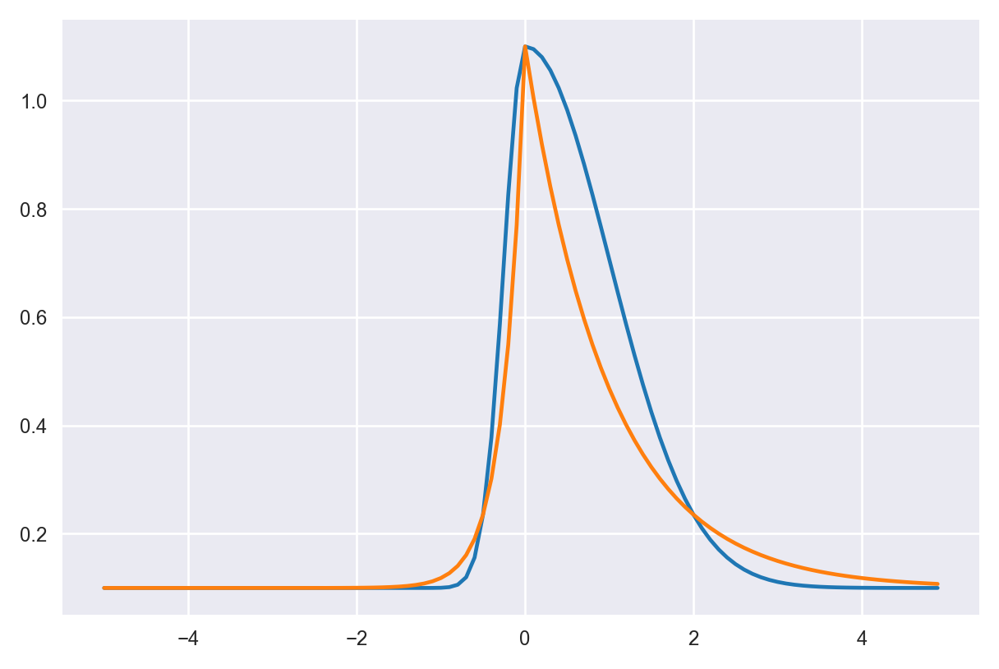

In [6]:
x = np.arange(-5, 5, .1)
skew = -1
y1 = peakfit.skewed_gaussian(x, center=0, amplitude=1, sigma=.5, baseline=.1, floor=0, ceiling=100, skew=skew)
y2 = peakfit.skewed_exponential_peak(x, center=0, amplitude=1, decay=.5, baseline=.1, floor=0, ceiling=100, skew=skew)
plt.plot(x, y1)
plt.plot(x, y2);


In [11]:
amplitude = lmfit.Parameter(value=.5, vary=True, min=0)
decay = lmfit.Parameter(value=.5, vary=True, min=0.15, max=2)
sigma = lmfit.Parameter(value=.5, vary=True, min=0.15, max=2)
skew = lmfit.Parameter(value=0, vary=True, min=-1, max=1)
baseline = lmfit.Parameter(value=.05, vary=True, min=0, max=.1)
ceiling = lmfit.Parameter(value=1, vary=False)
floor = lmfit.Parameter(value=0, vary=False)
null = lmfit.Parameter(value=.05, vary=True, min=0)
peak_limit_frc = .2


exp_fitter = peakfit.ExponentialPeakFitter(
    amplitude=amplitude,
    decay=decay,
    baseline=baseline,
    ceiling=ceiling,
    floor=floor,
    null=null,
    peak_limit_frc=peak_limit_frc,
)


skewed_exp_fitter = peakfit.SkewedExponentialPeakFitter(
    amplitude=amplitude,
    decay=decay,
    skew=skew,
    baseline=baseline,
    ceiling=ceiling,
    floor=floor,
    null=null,
    peak_limit_frc=peak_limit_frc,
)


gauss_fitter = peakfit.GaussianPeakFitter(
    amplitude=amplitude,
    sigma=sigma,
    baseline=baseline,
    ceiling=ceiling,
    floor=floor,
    null=null,
    peak_limit_frc=peak_limit_frc,
)


skewed_gauss_fitter = peakfit.SkewedGaussianPeakFitter(
    amplitude=amplitude,
    sigma=sigma,
    skew=skew,
    baseline=baseline,
    ceiling=ceiling,
    floor=floor,
    null=null,
    peak_limit_frc=peak_limit_frc,
)


def inspect_peak_fits(center, flank):

    x = ((starts + ends) / 2).astype(int)
    x = gmap['2'].take(x - 1)
    y = values

    fit = exp_fitter.fit(x, y, center, flank)
    fig = peakfit.plot_peak_fit(fit, ylabel='H12')
    fig.suptitle('Exponential', fontsize=12, fontweight='bold', y=1.03)
    plt.show()
    print(fit.peak_result.fit_report())
    print(fit.null_result.fit_report())

    fit = skewed_exp_fitter.fit(x, y, center, flank)
    fig = peakfit.plot_peak_fit(fit, ylabel='H12')
    fig.suptitle('Skewed Exponential', fontsize=12, fontweight='bold', y=1.03)
    plt.show()
    print(fit.peak_result.fit_report())
    print(fit.null_result.fit_report())
    
    fit = gauss_fitter.fit(x, y, center, flank)
    fig = peakfit.plot_peak_fit(fit, ylabel='H12')
    fig.suptitle('Gaussian', fontsize=12, fontweight='bold', y=1.03)
    plt.show()
    print(fit.peak_result.fit_report())
    print(fit.null_result.fit_report())

    fit = skewed_gauss_fitter.fit(x, y, center, flank)
    fig = peakfit.plot_peak_fit(fit, ylabel='H12')
    fig.suptitle('Skewed Gaussian', fontsize=12, fontweight='bold', y=1.03)
    plt.show()
    print(fit.peak_result.fit_report())
    print(fit.null_result.fit_report())

    

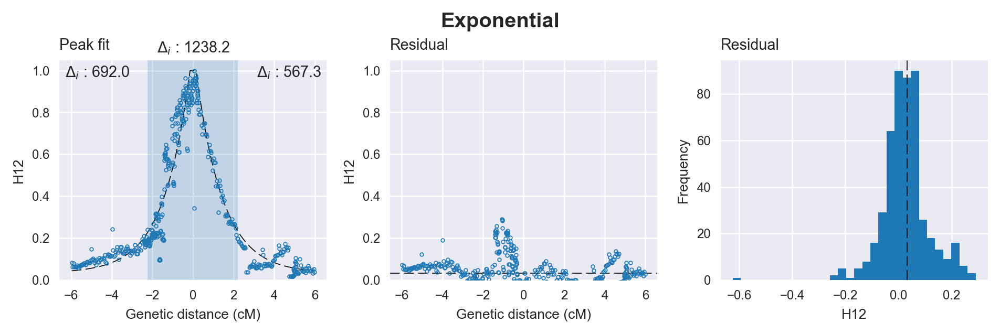

[[Model]]
    Model(exponential_peak)
[[Fit Statistics]]
    # function evals   = 52
    # data points      = 489
    # variables        = 3
    chi-square         = 3.804
    reduced chi-square = 0.008
    Akaike info crit   = -2368.755
    Bayesian info crit = -2356.178
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.08420174 +/- 0.017260 (1.59%) (init= 0.5)
    decay:       1.30289672 +/- 0.049158 (3.77%) (init= 0.5)
    baseline:    0.03281383 +/- 0.009870 (30.08%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.790 
    C(amplitude, decay)          = -0.376 
    C(amplitude, baseline)       = -0.119 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 12
    # data points      = 488
    # variables        = 1
    chi-square         = 47.917
    reduced chi-square = 0.098
    Akaike info crit   = -1130.576
    Bayesian info crit = -1126

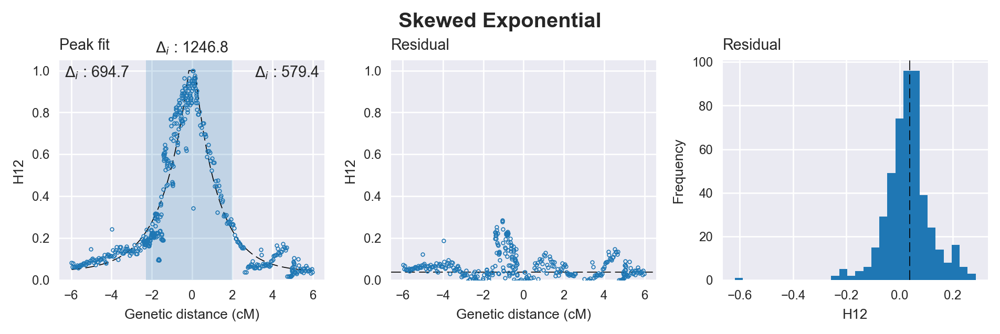

[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 64
    # data points      = 489
    # variables        = 4
    chi-square         = 3.722
    reduced chi-square = 0.008
    Akaike info crit   = -2377.397
    Bayesian info crit = -2360.628
[[Variables]]
    center:      0 (fixed)
    amplitude:   1.08421626 +/- 0.017356 (1.60%) (init= 0.5)
    decay:       1.24575213 +/- 0.048459 (3.89%) (init= 0.5)
    skew:        0.08054564 +/- 0.024945 (30.97%) (init= 0)
    baseline:    0.03837992 +/- 0.009430 (24.57%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.771 
    C(amplitude, decay)          = -0.375 
    C(decay, skew)               = -0.343 
    C(skew, baseline)            =  0.174 
    C(amplitude, baseline)       = -0.109 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 12
    # data points      = 488
  

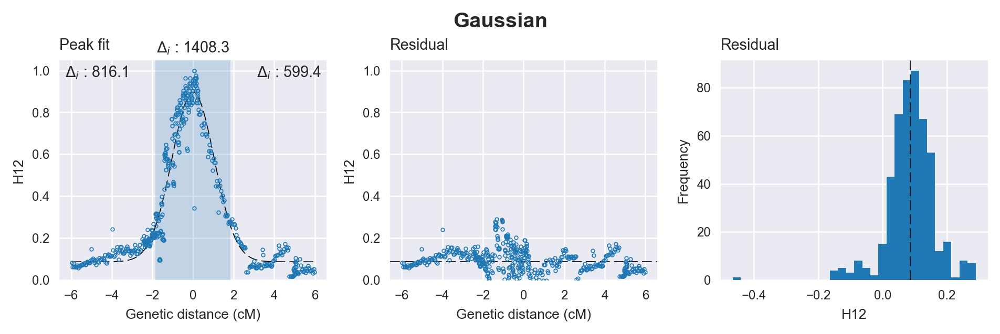

[[Model]]
    Model(gaussian)
[[Fit Statistics]]
    # function evals   = 23
    # data points      = 489
    # variables        = 3
    chi-square         = 2.686
    reduced chi-square = 0.006
    Akaike info crit   = -2538.920
    Bayesian info crit = -2526.343
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.81039991 +/- 0.008958 (1.11%) (init= 0.5)
    sigma:       1.04317882 +/- 0.015718 (1.51%) (init= 0.5)
    baseline:    0.08704566 +/- 0.005486 (6.30%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, baseline)           = -0.556 
    C(amplitude, baseline)       = -0.506 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 12
    # data points      = 488
    # variables        = 1
    chi-square         = 47.917
    reduced chi-square = 0.098
    Akaike info crit   = -1130.576
    Bayesian info crit = -1126.386
[[Variables]]
    c:   0.36550321 +/- 0.014199 

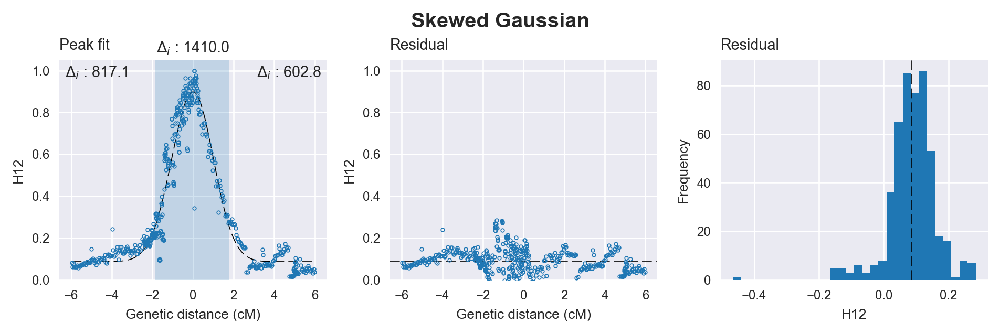

[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 28
    # data points      = 489
    # variables        = 4
    chi-square         = 2.666
    reduced chi-square = 0.005
    Akaike info crit   = -2540.618
    Bayesian info crit = -2523.848
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.81044130 +/- 0.008937 (1.10%) (init= 0.5)
    sigma:       1.02705159 +/- 0.017134 (1.67%) (init= 0.5)
    skew:        0.03621192 +/- 0.018406 (50.83%) (init= 0)
    baseline:    0.08758973 +/- 0.005449 (6.22%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, baseline)           = -0.509 
    C(amplitude, baseline)       = -0.505 
    C(sigma, skew)               = -0.438 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 12
    # data points      = 488
    # variables        = 1
    chi-square         = 47.917
    reduced chi-square = 0.098
    Aka

In [12]:
inspect_peak_fits(center=120.4, flank=6)

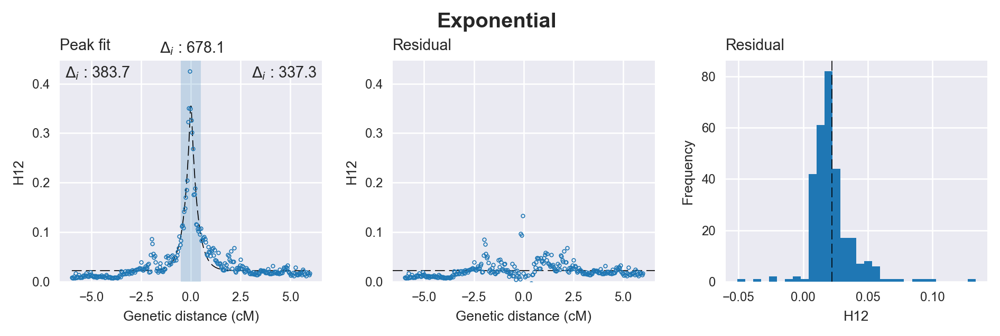

[[Model]]
    Model(exponential_peak)
[[Fit Statistics]]
    # function evals   = 35
    # data points      = 299
    # variables        = 3
    chi-square         = 0.085
    reduced chi-square = 0.000
    Akaike info crit   = -2436.460
    Bayesian info crit = -2425.359
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.35407752 +/- 0.008607 (2.43%) (init= 0.5)
    decay:       0.31242682 +/- 0.011415 (3.65%) (init= 0.5)
    baseline:    0.02217792 +/- 0.001100 (4.96%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.668 
    C(decay, baseline)           = -0.342 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 298
    # variables        = 1
    chi-square         = 0.811
    reduced chi-square = 0.003
    Akaike info crit   = -1758.332
    Bayesian info crit = -1754.635
[[Variables]]
    c:   0.03937288 +/- 0.0

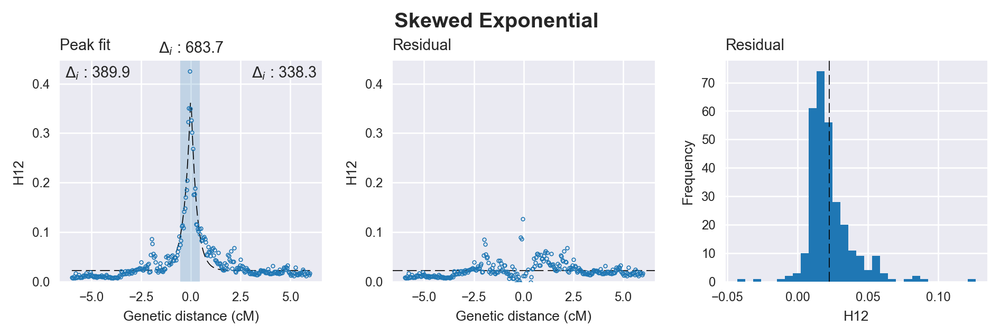

[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 58
    # data points      = 299
    # variables        = 4
    chi-square         = 0.083
    reduced chi-square = 0.000
    Akaike info crit   = -2442.074
    Bayesian info crit = -2427.272
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.35955049 +/- 0.008652 (2.41%) (init= 0.5)
    decay:       0.30187216 +/- 0.010905 (3.61%) (init= 0.5)
    skew:        0.10587104 +/- 0.034609 (32.69%) (init= 0)
    baseline:    0.02247837 +/- 0.001083 (4.82%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.669 
    C(decay, baseline)           = -0.335 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 298
    # variables        = 1
    chi-square         = 0.811
    reduced chi-square = 0.003
    Akaike info crit   = -1758.332
    Bayes

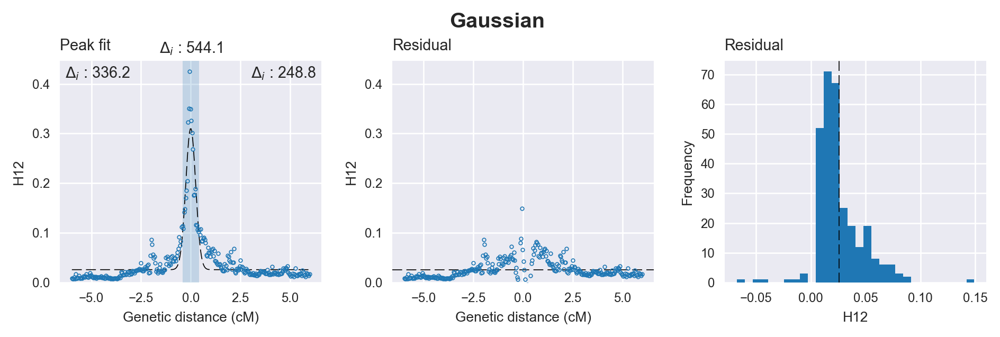

[[Model]]
    Model(gaussian)
[[Fit Statistics]]
    # function evals   = 67
    # data points      = 299
    # variables        = 3
    chi-square         = 0.133
    reduced chi-square = 0.000
    Akaike info crit   = -2302.407
    Bayesian info crit = -2291.306
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.28459396 +/- 0.007865 (2.76%) (init= 0.5)
    sigma:       0.24859353 +/- 0.008041 (3.23%) (init= 0.5)
    baseline:    0.02583645 +/- 0.001298 (5.02%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.539 
    C(sigma, baseline)           = -0.199 
    C(amplitude, baseline)       = -0.117 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 298
    # variables        = 1
    chi-square         = 0.811
    reduced chi-square = 0.003
    Akaike info crit   = -1758.332
    Bayesian info crit = -1754.635
[[Vari

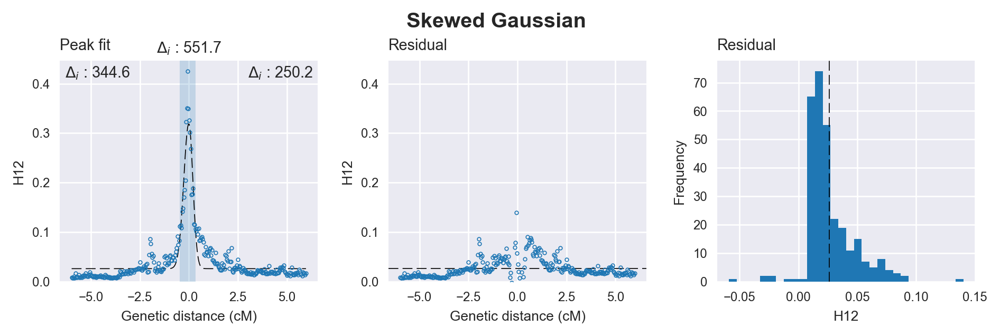

[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 108
    # data points      = 299
    # variables        = 4
    chi-square         = 0.128
    reduced chi-square = 0.000
    Akaike info crit   = -2310.046
    Bayesian info crit = -2295.244
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.29316088 +/- 0.007980 (2.72%) (init= 0.5)
    sigma:       0.23304302 +/- 0.007446 (3.20%) (init= 0.5)
    skew:        0.15593058 +/- 0.037006 (23.73%) (init= 0)
    baseline:    0.02626184 +/- 0.001275 (4.86%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.539 
    C(sigma, baseline)           = -0.193 
    C(amplitude, baseline)       = -0.113 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 298
    # variables        = 1
    chi-square         = 0.811
    reduced chi-square = 0.003
    Akai

In [13]:
inspect_peak_fits(center=57, flank=6)

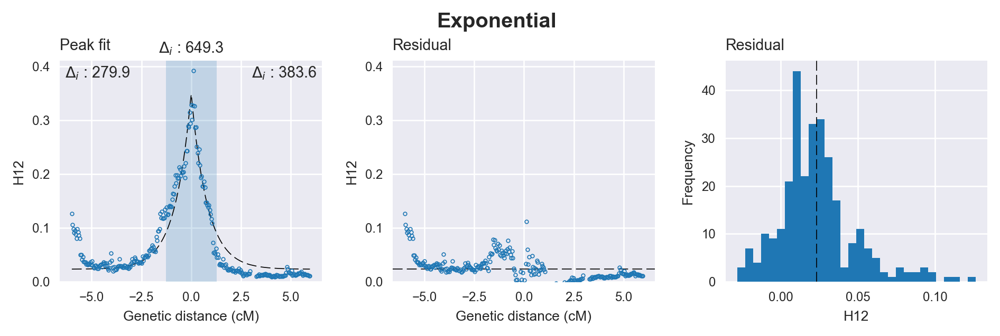

[[Model]]
    Model(exponential_peak)
[[Fit Statistics]]
    # function evals   = 31
    # data points      = 293
    # variables        = 3
    chi-square         = 0.181
    reduced chi-square = 0.001
    Akaike info crit   = -2159.517
    Bayesian info crit = -2148.477
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.32708613 +/- 0.007865 (2.40%) (init= 0.5)
    decay:       0.80715378 +/- 0.034313 (4.25%) (init= 0.5)
    baseline:    0.02313761 +/- 0.002133 (9.22%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.598 
    C(amplitude, decay)          = -0.560 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 292
    # variables        = 1
    chi-square         = 1.645
    reduced chi-square = 0.006
    Akaike info crit   = -1510.262
    Bayesian info crit = -1506.586
[[Variables]]
    c:   0.06689539 +/- 0.0

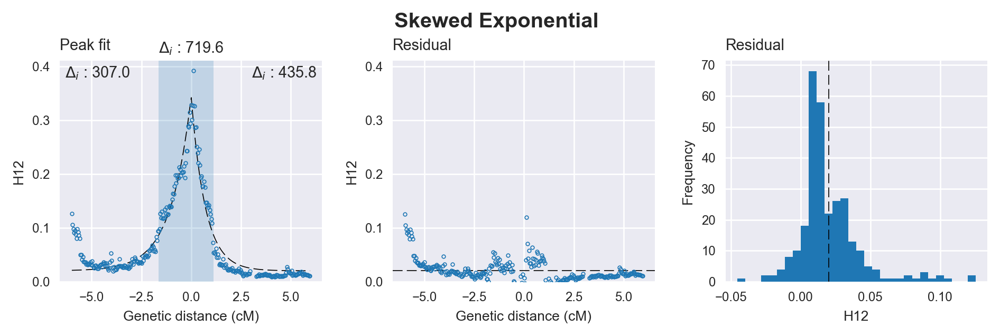

[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 43
    # data points      = 293
    # variables        = 4
    chi-square         = 0.141
    reduced chi-square = 0.000
    Akaike info crit   = -2229.865
    Bayesian info crit = -2215.145
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.32403249 +/- 0.006713 (2.07%) (init= 0.5)
    decay:       0.85316114 +/- 0.032203 (3.77%) (init= 0.5)
    skew:        0.26862809 +/- 0.030443 (11.33%) (init= 0)
    baseline:    0.02018431 +/- 0.001966 (9.74%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.621 
    C(amplitude, decay)          = -0.538 
    C(decay, skew)               = -0.105 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 292
    # variables        = 1
    chi-square         = 1.645
    reduced chi-square = 0.006
 

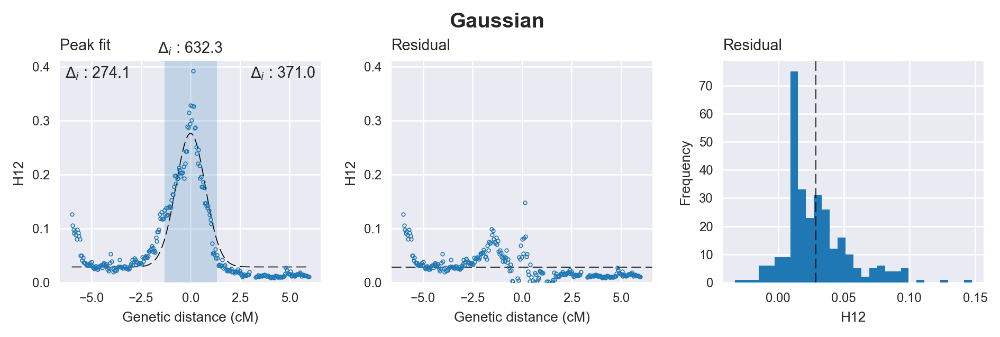

[[Model]]
    Model(gaussian)
[[Fit Statistics]]
    # function evals   = 31
    # data points      = 293
    # variables        = 3
    chi-square         = 0.191
    reduced chi-square = 0.001
    Akaike info crit   = -2142.606
    Bayesian info crit = -2131.566
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.24753789 +/- 0.005650 (2.28%) (init= 0.5)
    sigma:       0.73938696 +/- 0.020493 (2.77%) (init= 0.5)
    baseline:    0.02885935 +/- 0.001841 (6.38%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.432 
    C(sigma, baseline)           = -0.379 
    C(amplitude, baseline)       = -0.231 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 292
    # variables        = 1
    chi-square         = 1.645
    reduced chi-square = 0.006
    Akaike info crit   = -1510.262
    Bayesian info crit = -1506.586
[[Vari

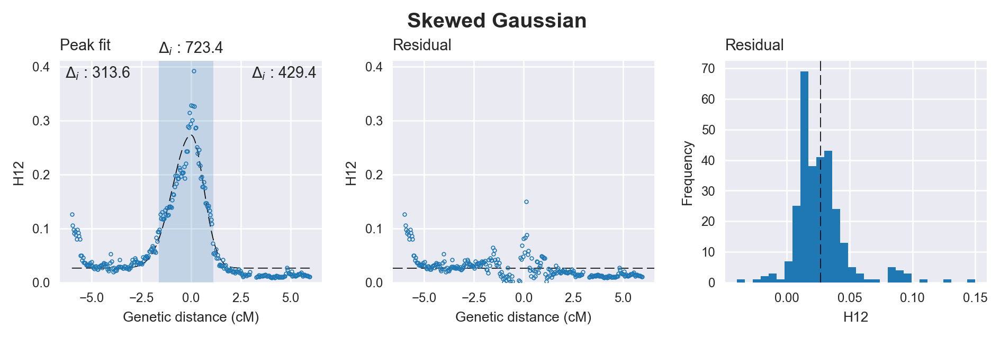

[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 43
    # data points      = 293
    # variables        = 4
    chi-square         = 0.139
    reduced chi-square = 0.000
    Akaike info crit   = -2233.646
    Bayesian info crit = -2218.926
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.24655533 +/- 0.004702 (1.91%) (init= 0.5)
    sigma:       0.76967615 +/- 0.018085 (2.35%) (init= 0.5)
    skew:        0.27558212 +/- 0.025639 (9.30%) (init= 0)
    baseline:    0.02667396 +/- 0.001598 (5.99%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.416 
    C(sigma, baseline)           = -0.390 
    C(amplitude, baseline)       = -0.240 
    C(sigma, skew)               = -0.143 

[[Model]]
    Model(constant)
[[Fit Statistics]]
    # function evals   = 9
    # data points      = 292
    # variables        = 1
    chi-square         = 1.64

In [14]:
inspect_peak_fits(center=170.9, flank=6)

## Check peak-finding

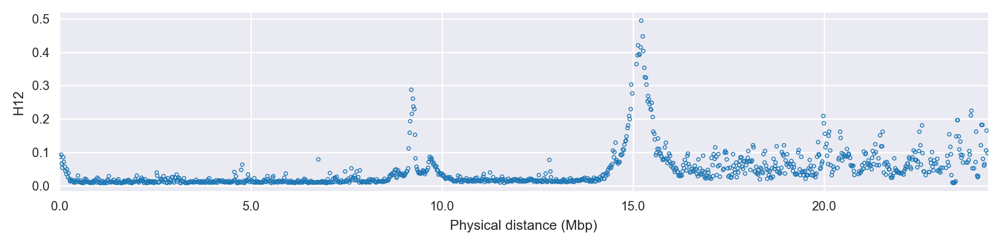

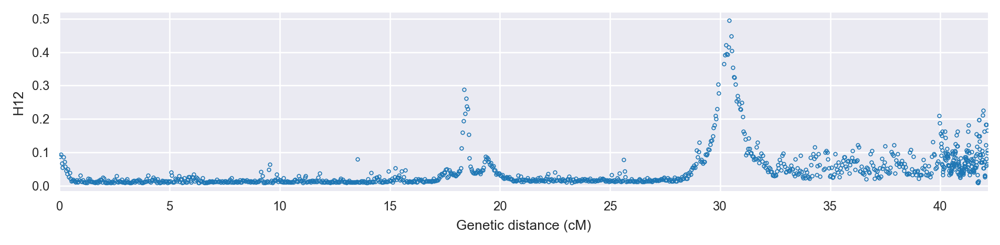

In [15]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df_h12, seqid='X', genome=genome, values_col='BFS', seqid_col='chrom', starts_col='start', ends_col='stop')
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12');
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12', gmap=gmap['X']);
centers = np.arange(1, ends[-1], 20000)

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 41.0146449953
scan progress 1200 42.0146449928
first peak: 760 677.802
Iteration 1
Peak center (index, location): 760, 15200001.0
Delta AIC: 677.8
Flank delta AICs: 396.1, 308.3
find limits of peak
peak limits: 14740001 15660000 737 784
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 28
    # data points      = 291
    # variables        = 4
    chi-square         = 0.197
    reduced chi-square = 0.001
    Akaike info crit   = -2115.679
    Bayesian info crit = -2100.985
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.45787987 +/- 0.0107

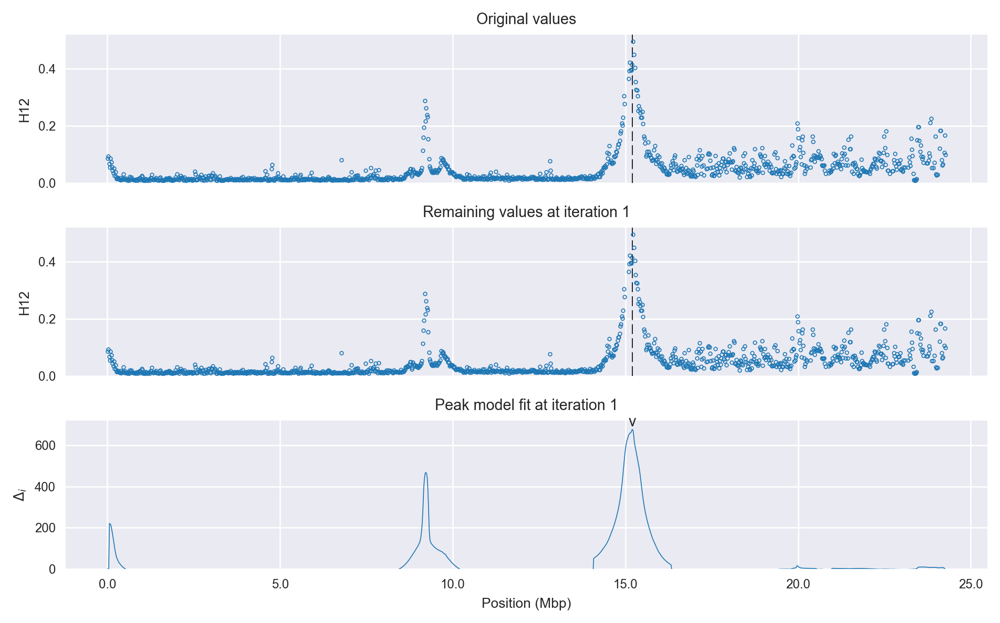

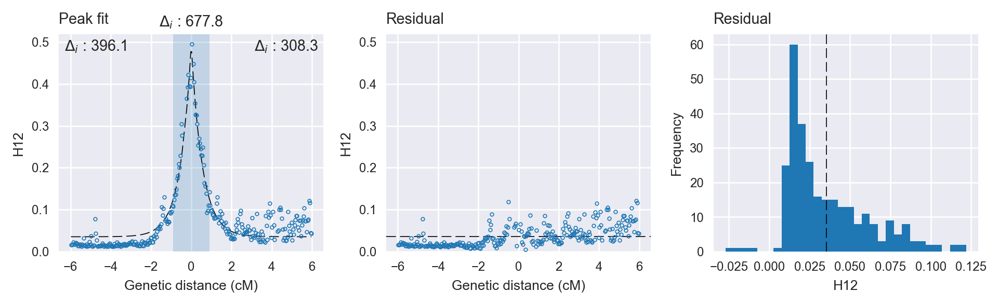

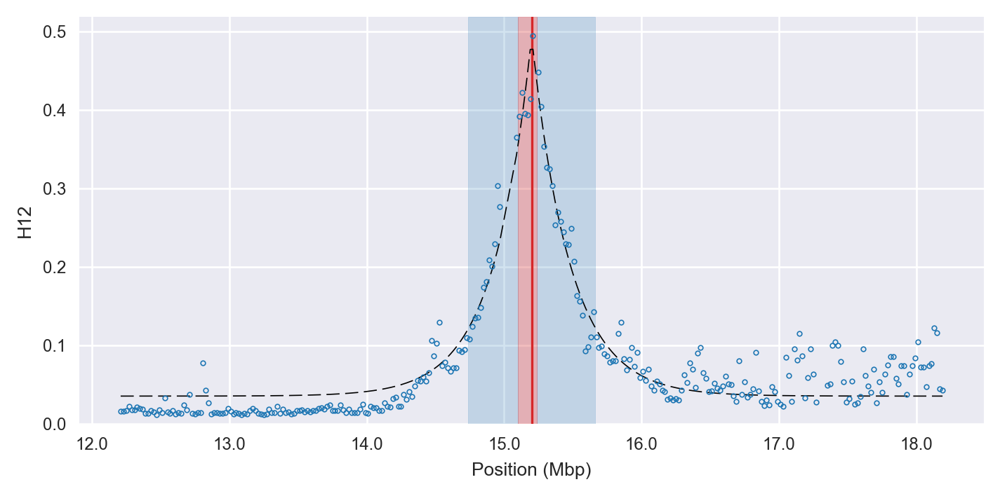

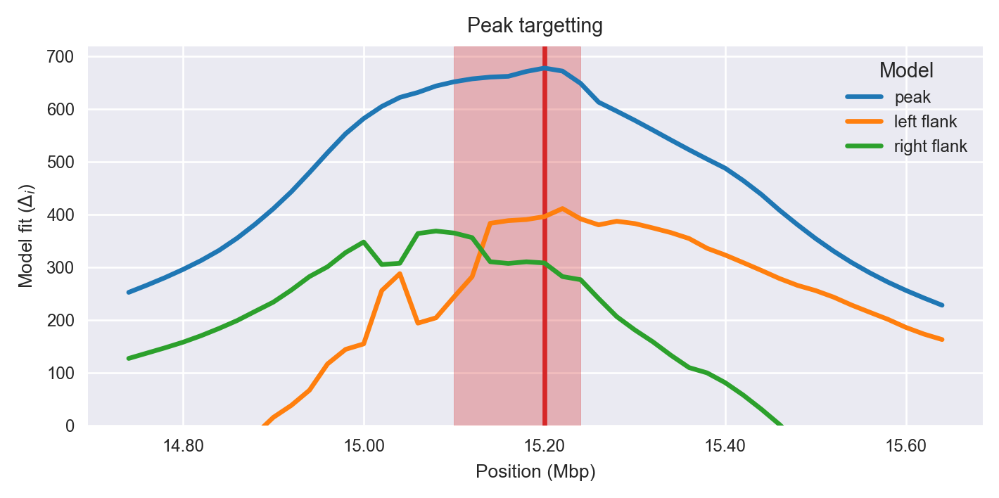

find the next peak
next peak: 461 469.003
Iteration 2
Peak center (index, location): 461, 9220001.0
Delta AIC: 469.0
Flank delta AICs: 301.2, 234.7
find limits of peak
peak limits: 9100001 9340000 455 468
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 43
    # data points      = 299
    # variables        = 4
    chi-square         = 0.066
    reduced chi-square = 0.000
    Akaike info crit   = -2506.927
    Bayesian info crit = -2492.126
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.24549122 +/- 0.007881 (3.21%) (init= 0.5)
    sigma:       0.12362431 +/- 0.004612 (3.73%) (init= 0.5)
    skew:        0.01665628 +/- 0.043529 (261.34%) (init= 0)
    baseline:    0.02247509 +/- 0.000893 (3.97%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.559 
    C(sigma, baseline)           = -0.138

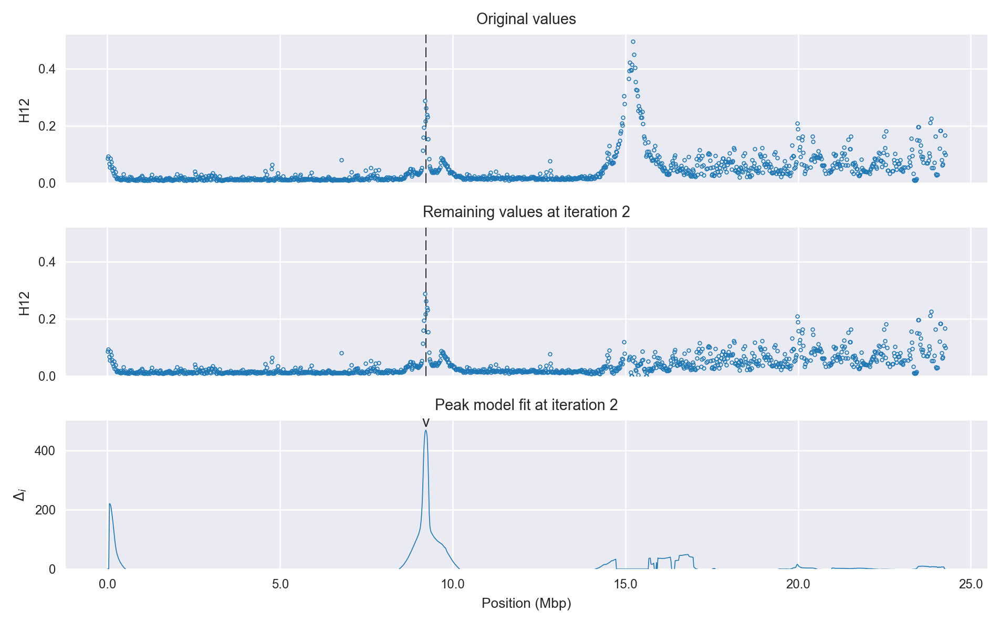

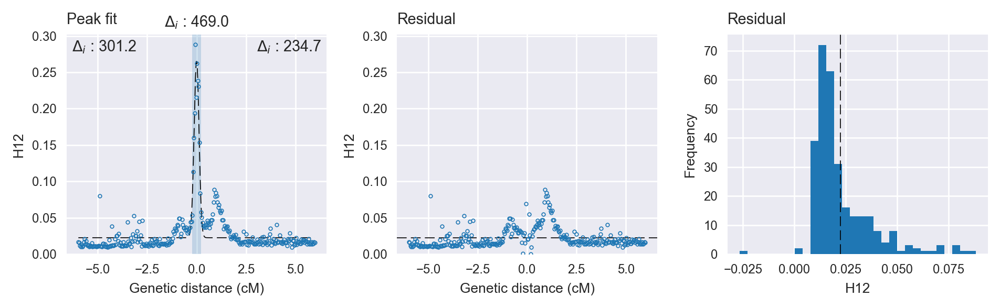

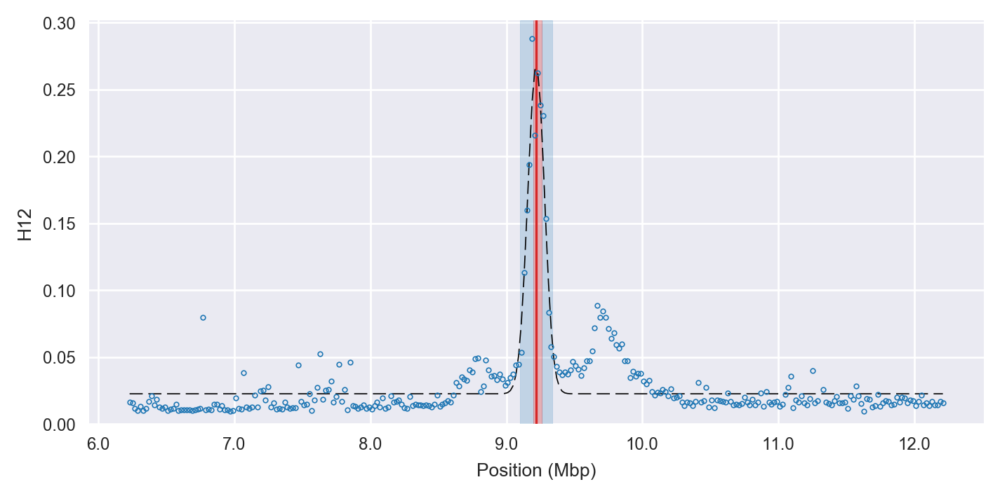

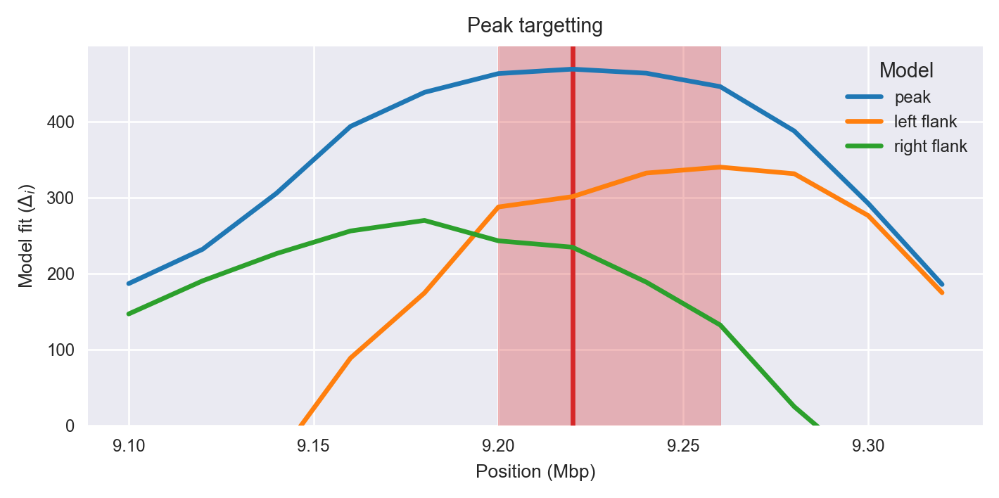

find the next peak
next peak: 489 266.995
Iteration 3
Peak center (index, location): 489, 9780001.0
Delta AIC: 267.0
Flank delta AICs: 123.5, 211.0
find limits of peak
peak limits: 9180001 10020000 459 502
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 48
    # data points      = 299
    # variables        = 4
    chi-square         = 0.023
    reduced chi-square = 0.000
    Akaike info crit   = -2823.503
    Bayesian info crit = -2808.702
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.05904812 +/- 0.003506 (5.94%) (init= 0.5)
    decay:       0.46329227 +/- 0.045460 (9.81%) (init= 0.5)
    skew:        0.65084317 +/- 0.094294 (14.49%) (init= 0)
    baseline:    0.01776362 +/- 0.000629 (3.55%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.606 
    C(decay, baseline)           

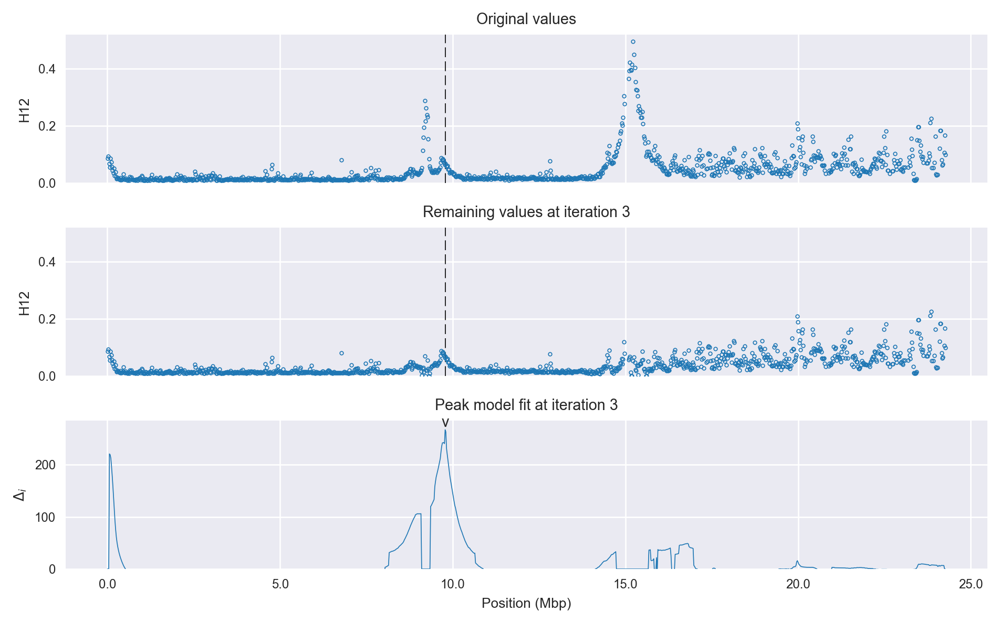

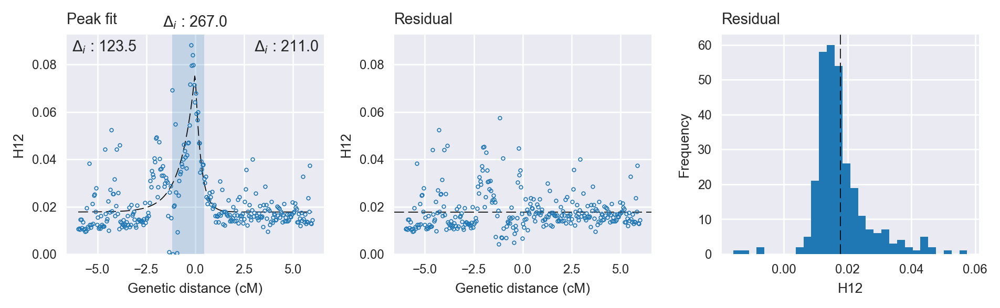

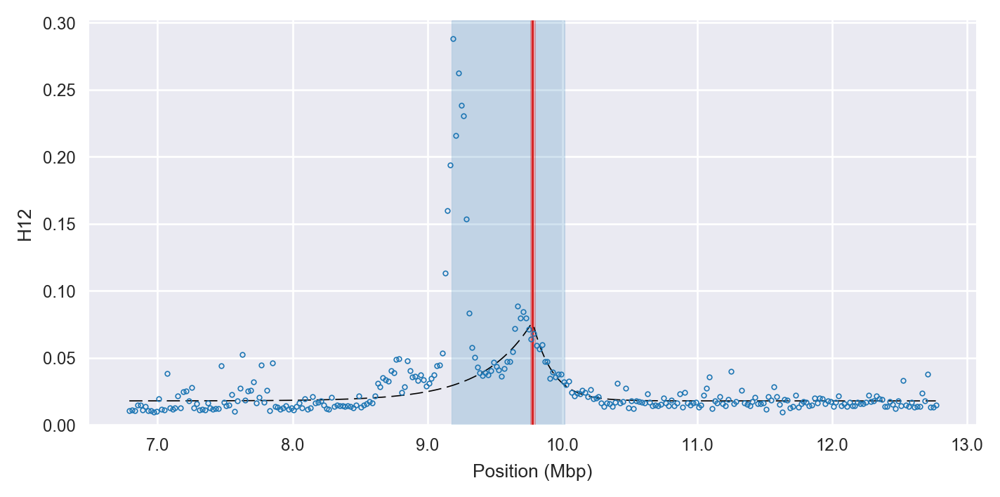

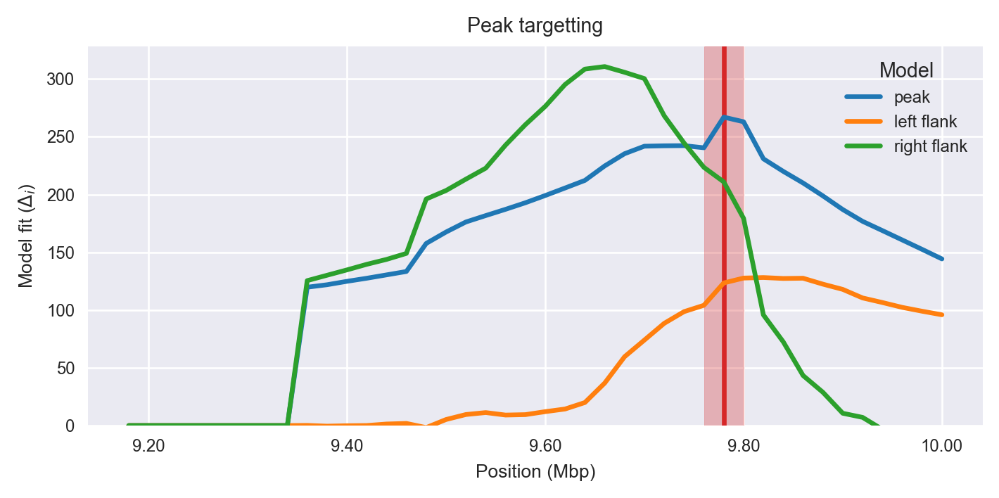

find the next peak
next peak: 3 220.723
Iteration 4
Peak center (index, location): 3, 60001.0
Delta AIC: 220.7
Flank delta AICs: 1.3, 177.6
find limits of peak
peak limits: 1 220000 0 12
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 80
    # data points      = 153
    # variables        = 4
    chi-square         = 0.006
    reduced chi-square = 0.000
    Akaike info crit   = -1533.580
    Bayesian info crit = -1521.458
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.06305129 +/- 0.003337 (5.29%) (init= 0.5)
    sigma:       0.36425872 +/- 1.147694 (315.08%) (init= 0.5)
    skew:        0.99999986 +/- 16.99387 (1699.39%) (init= 0)
    baseline:    0.01475352 +/- 0.000559 (3.79%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -1.000 
    C(amplitude, 

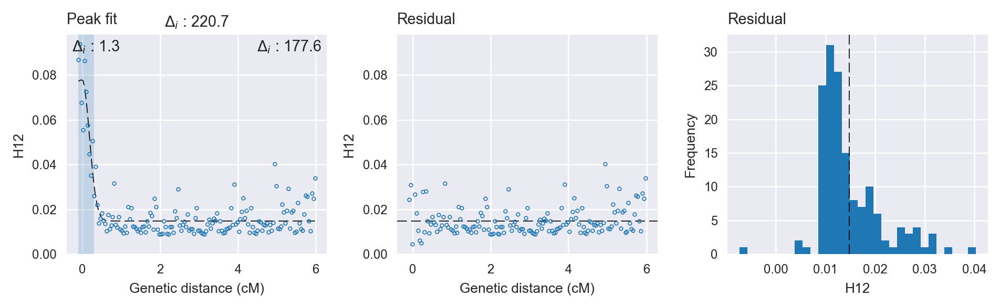

find the next peak
next peak: 12 75.181
all done


In [16]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=6, gmap=gmap['X'], fitters=[skewed_gauss_fitter, skewed_exp_fitter], show_plots=True, 
                           statistic_label='H12', log_file=None)
peaks = list(peaks)

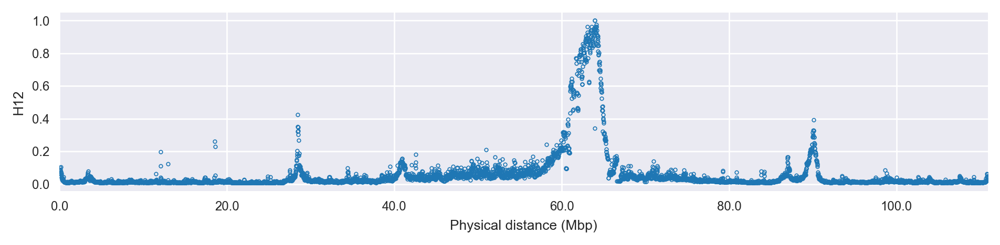

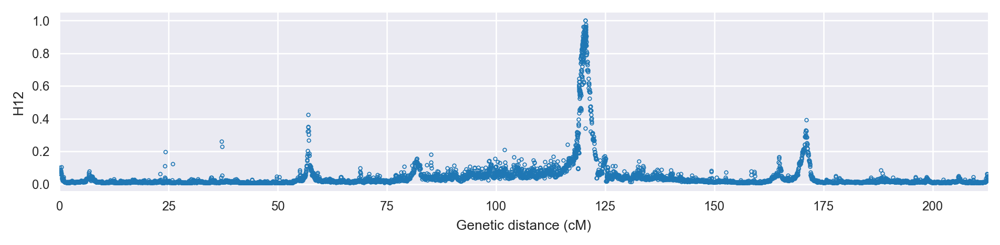

In [17]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df_h12, seqid=('2R', '2L'), genome=genome, values_col='BFS', seqid_col='chrom', starts_col='start', ends_col='stop')
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12');
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12', gmap=gmap['2']);
centers = np.arange(1, ends[-1], 20000)

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 44.0000020019
scan progress 1200 48.000002006
scan progress 1300 52.0000020101
scan progress 1400 56.0000020142
scan progress 1500 60.0000020183
scan progress 1600 64.0000020224
scan progress 1700 68.0000020123
scan progress 1800 72.0000020023
scan progress 1900 76.0000019922
scan progress 2000 80.0000019821
scan progress 2100 84.000001972
scan progress 2200 88.0000019619
scan progress 2300 92.0000019518
scan progress 2400 96.0000019417
scan progress 2500 100.000001932
scan progress 2600 104.000001921
scan progress 2700 108.000001911
scan progress 2800 112.000001901
scan progress 2900 116.000001891
scan progress 3000 118.477165885


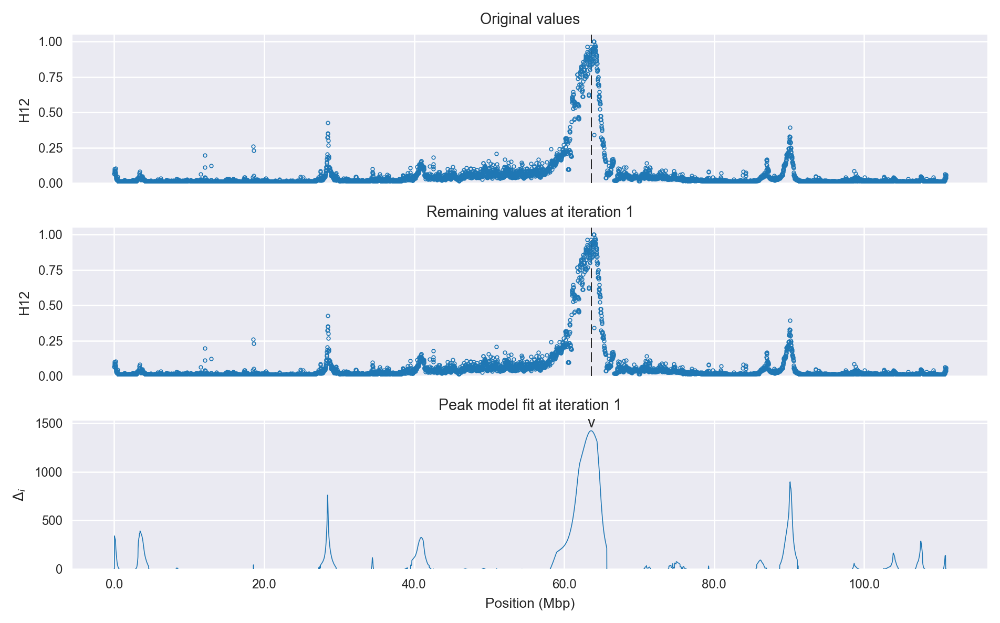

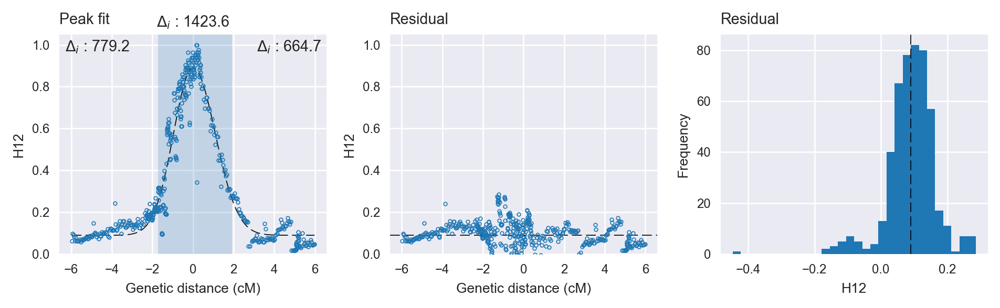

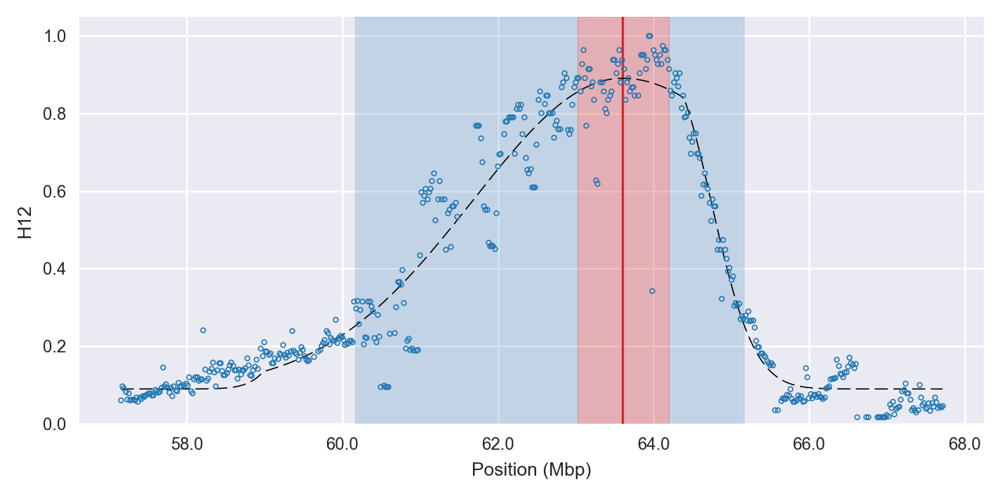

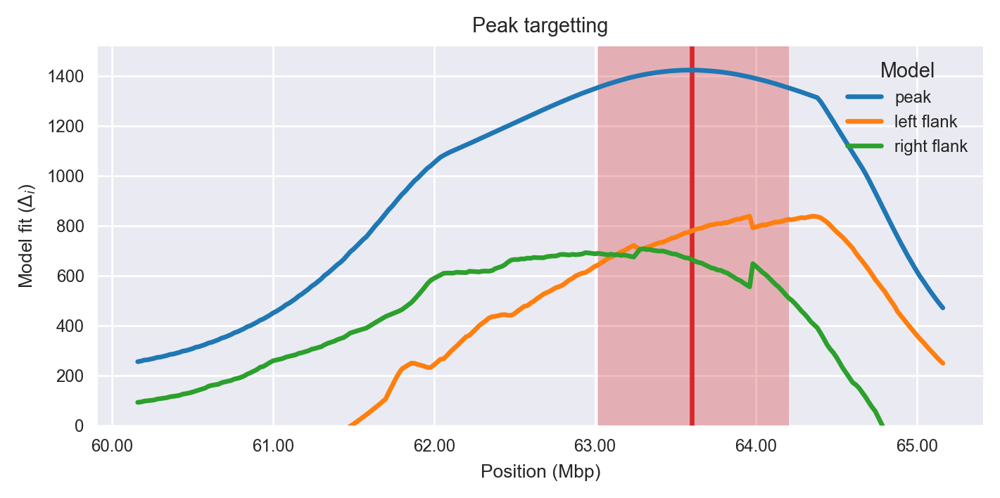

find the next peak
next peak: 4506 897.338
Iteration 2
Peak center (index, location): 4506, 90120001.0
Delta AIC: 897.3
Flank delta AICs: 432.5, 493.9
find limits of peak
peak limits: 89125106 90565105 4457 4530
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 28
    # data points      = 293
    # variables        = 4
    chi-square         = 0.077
    reduced chi-square = 0.000
    Akaike info crit   = -2406.216
    Bayesian info crit = -2391.496
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.32821307 +/- 0.004901 (1.49%) (init= 0.5)
    decay:       0.82876713 +/- 0.022931 (2.77%) (init= 0.5)
    skew:        0.56860661 +/- 0.023229 (4.09%) (init= 0)
    baseline:    0.01665124 +/- 0.001457 (8.76%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.608 
    C(amplitude, decay)     

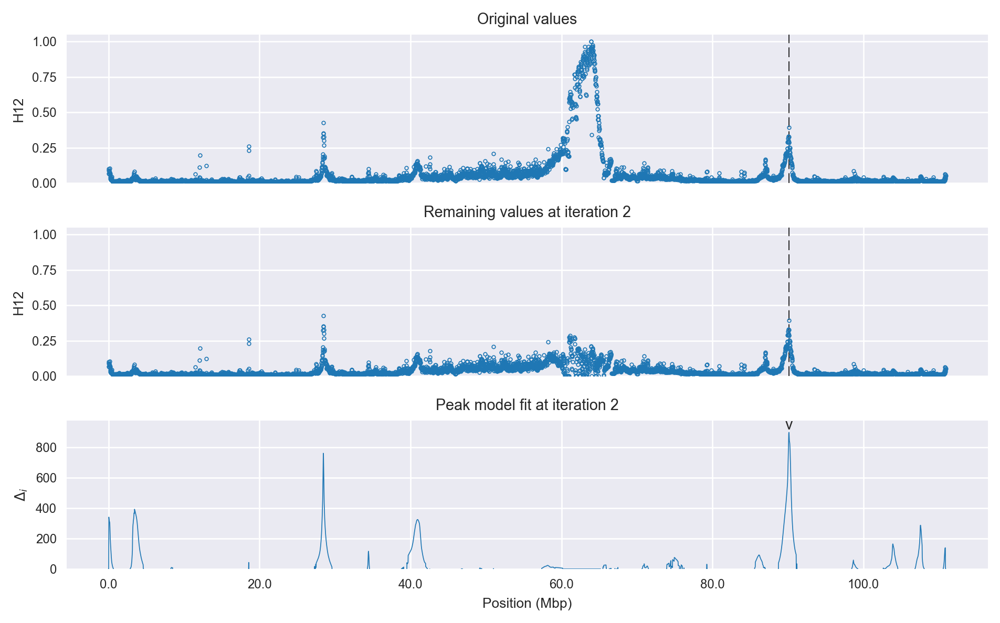

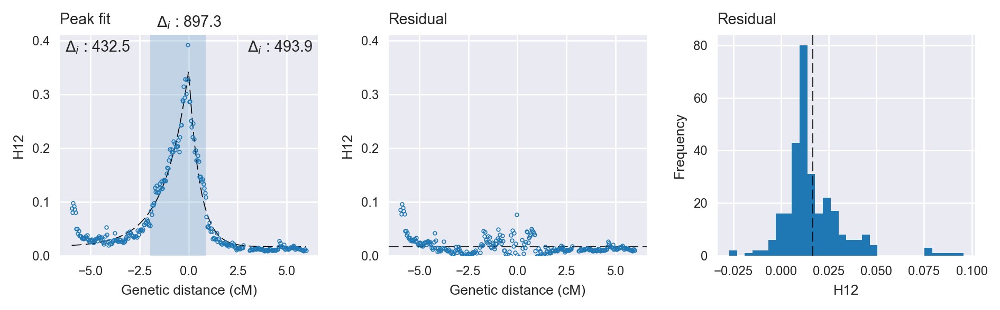

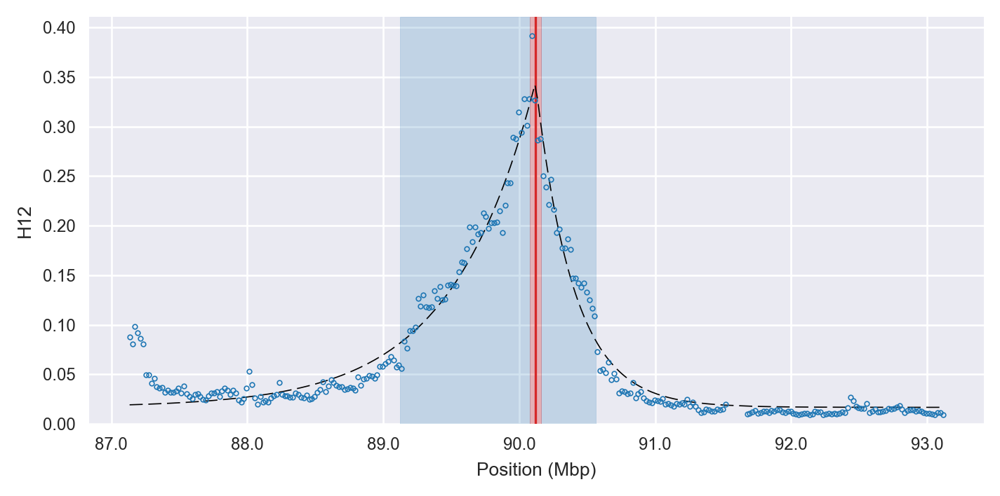

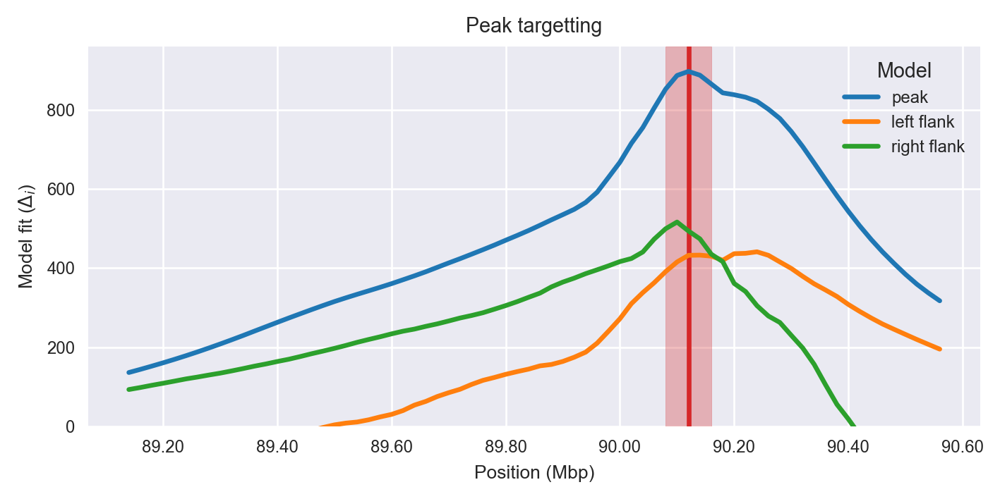

find the next peak
next peak: 1423 760.646
Iteration 3
Peak center (index, location): 1423, 28460001.0
Delta AIC: 760.6
Flank delta AICs: 361.1, 439.8
find limits of peak
peak limits: 28280001 28760000 1414 1439
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 48
    # data points      = 299
    # variables        = 4
    chi-square         = 0.064
    reduced chi-square = 0.000
    Akaike info crit   = -2518.796
    Bayesian info crit = -2503.994
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.36761258 +/- 0.007711 (2.10%) (init= 0.5)
    decay:       0.28707053 +/- 0.009126 (3.18%) (init= 0.5)
    skew:       -0.34191685 +/- 0.030918 (9.04%) (init= 0)
    baseline:    0.02250202 +/- 0.000950 (4.22%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.663 
    C(decay, baseline)      

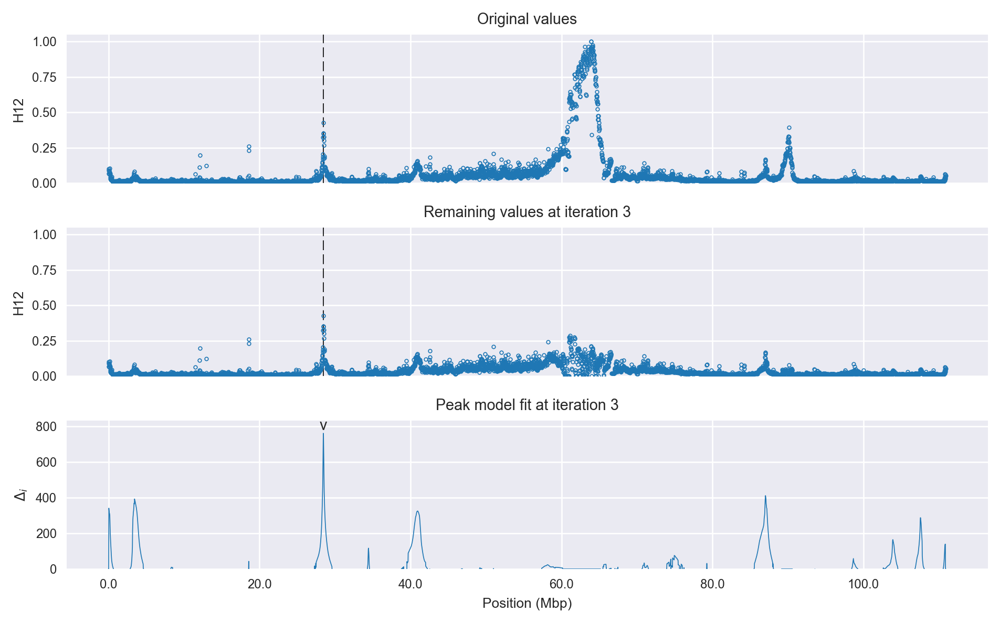

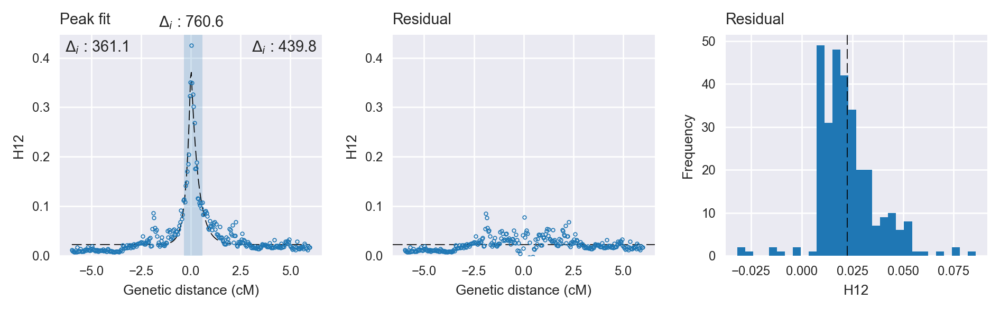

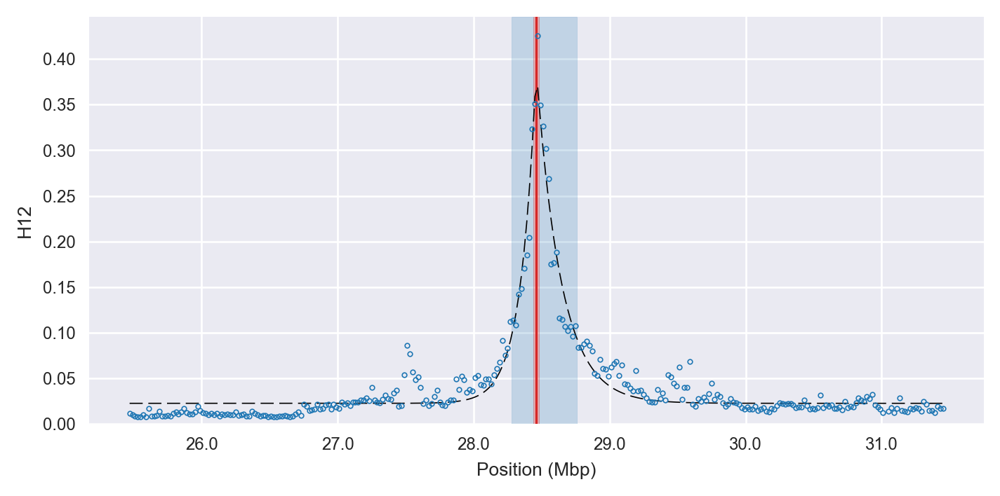

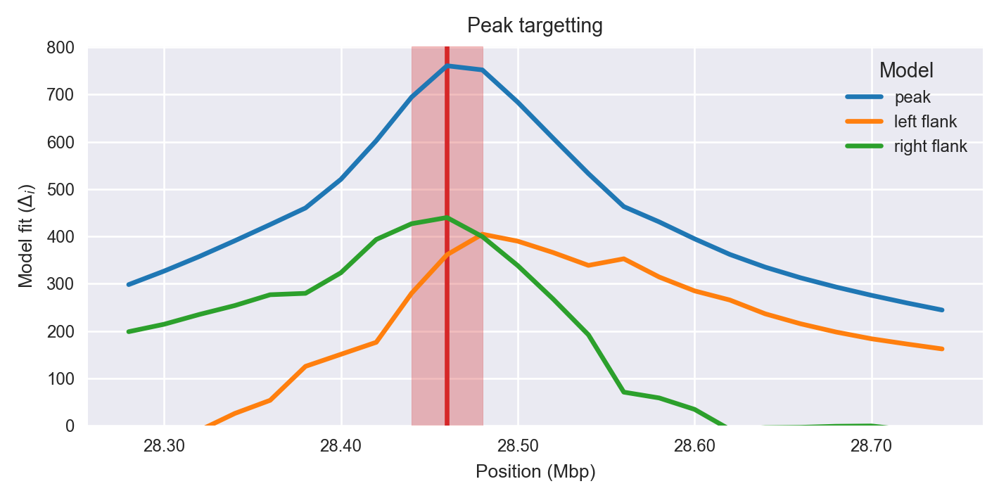

find the next peak
next peak: 4351 411.148
Iteration 4
Peak center (index, location): 4351, 87020001.0
Delta AIC: 411.1
Flank delta AICs: 219.6, 219.5
find limits of peak
peak limits: 86425106 87405105 4322 4372
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 48
    # data points      = 300
    # variables        = 4
    chi-square         = 0.046
    reduced chi-square = 0.000
    Akaike info crit   = -2626.540
    Bayesian info crit = -2611.725
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.11308990 +/- 0.004562 (4.03%) (init= 0.5)
    decay:       0.58317966 +/- 0.038730 (6.64%) (init= 0.5)
    skew:        0.32834517 +/- 0.059692 (18.18%) (init= 0)
    baseline:    0.01513600 +/- 0.000928 (6.13%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.607 
    C(decay, baseline)     

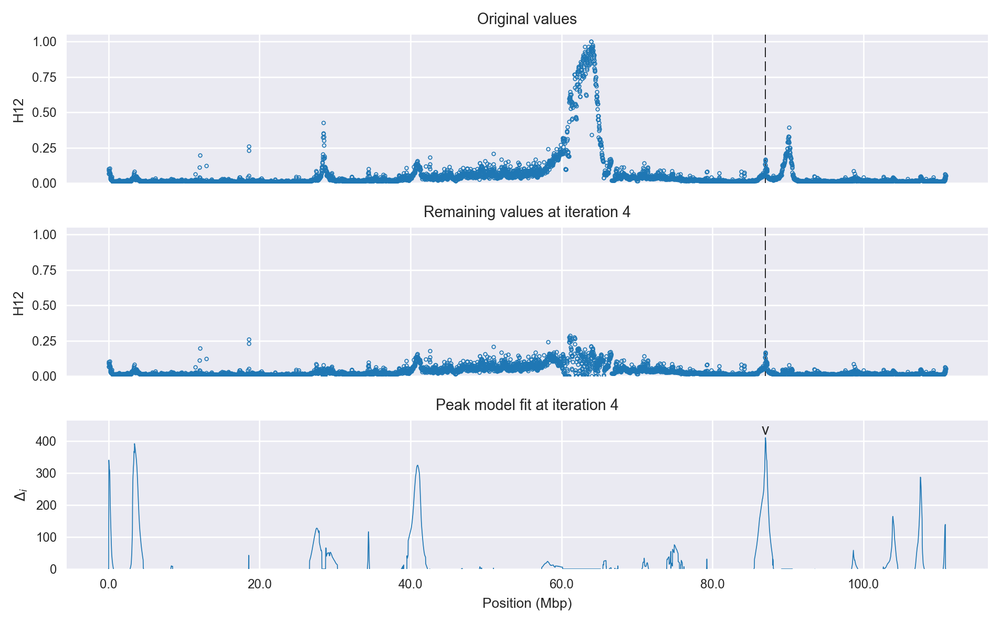

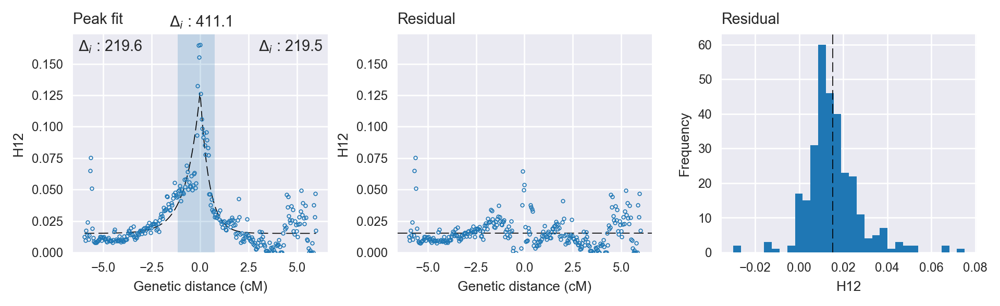

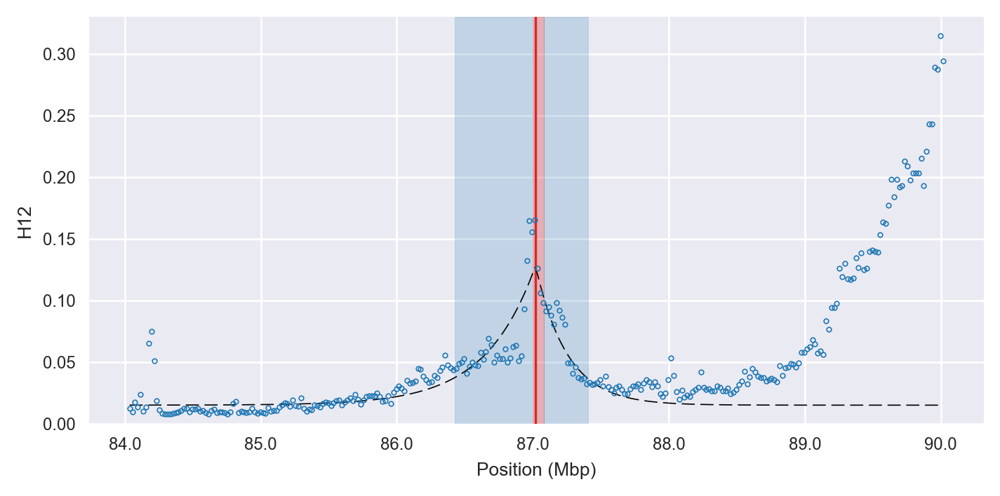

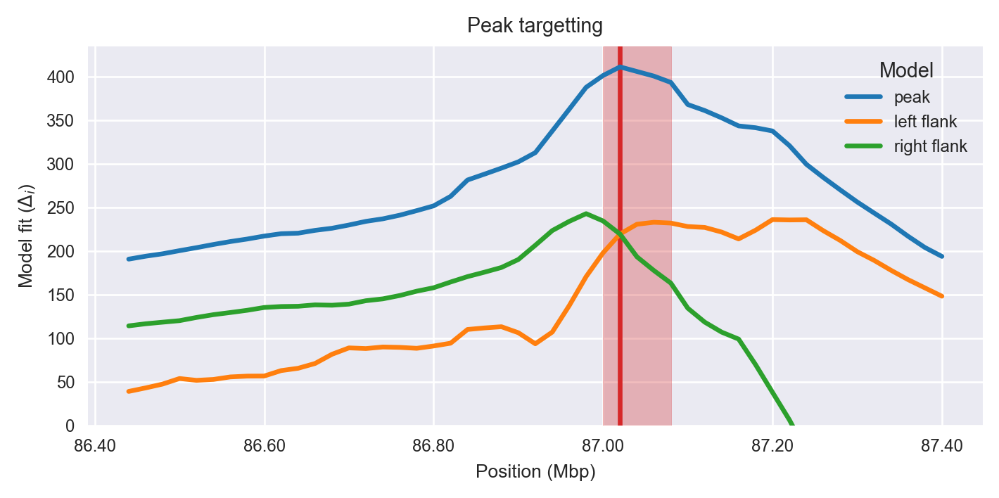

find the next peak
next peak: 173 392.47
Iteration 5
Peak center (index, location): 173, 3460001.0
Delta AIC: 392.5
Flank delta AICs: 233.9, 192.7
find limits of peak
peak limits: 2940001 4060000 147 204
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 33
    # data points      = 298
    # variables        = 4
    chi-square         = 0.008
    reduced chi-square = 0.000
    Akaike info crit   = -3146.708
    Bayesian info crit = -3131.919
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.03320360 +/- 0.001212 (3.65%) (init= 0.5)
    sigma:       0.62367254 +/- 0.027223 (4.37%) (init= 0.5)
    skew:       -0.11188969 +/- 0.049058 (43.85%) (init= 0)
    baseline:    0.01223851 +/- 0.000344 (2.81%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.450 
    C(sigma, baseline)           = -0.337 


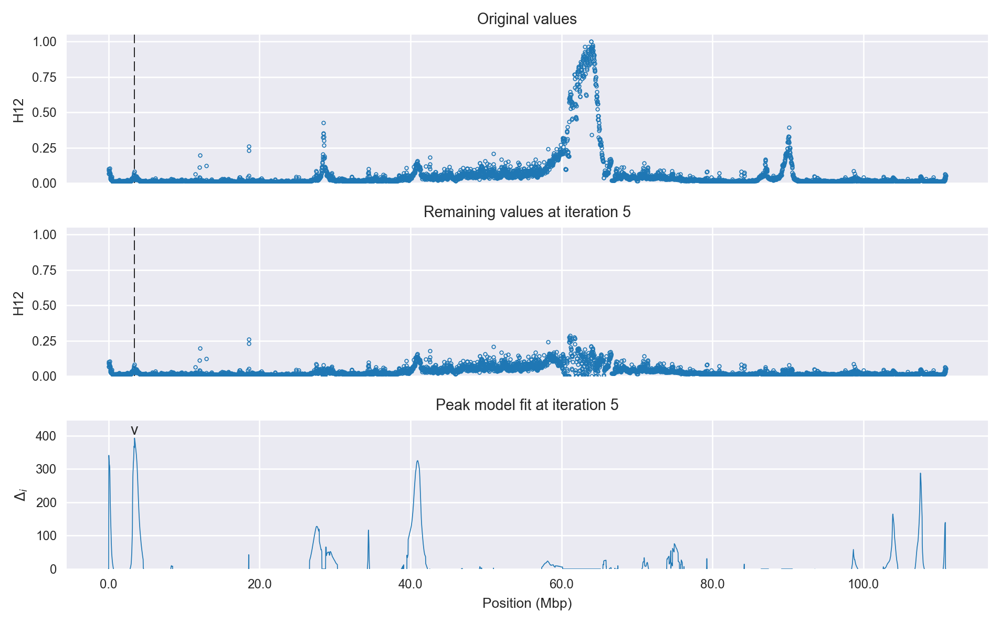

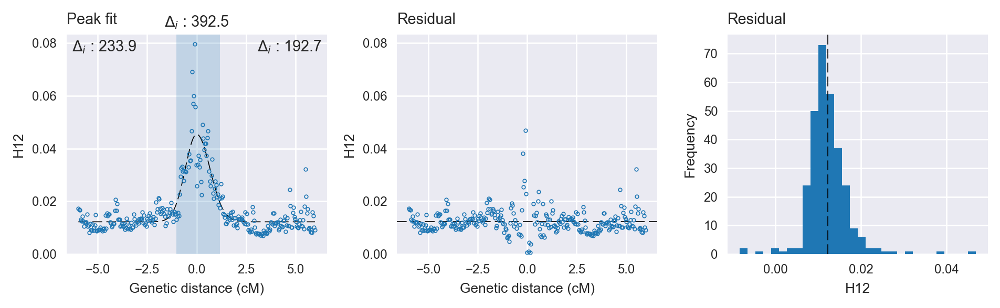

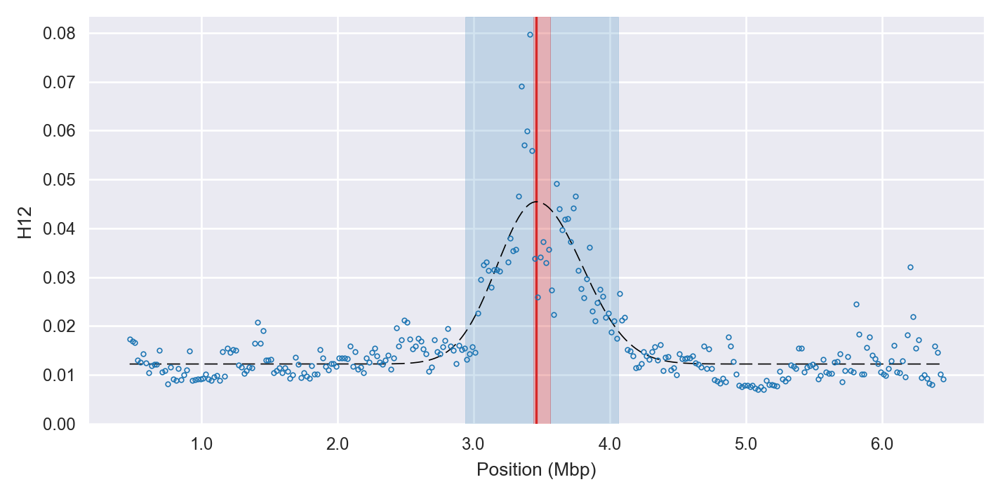

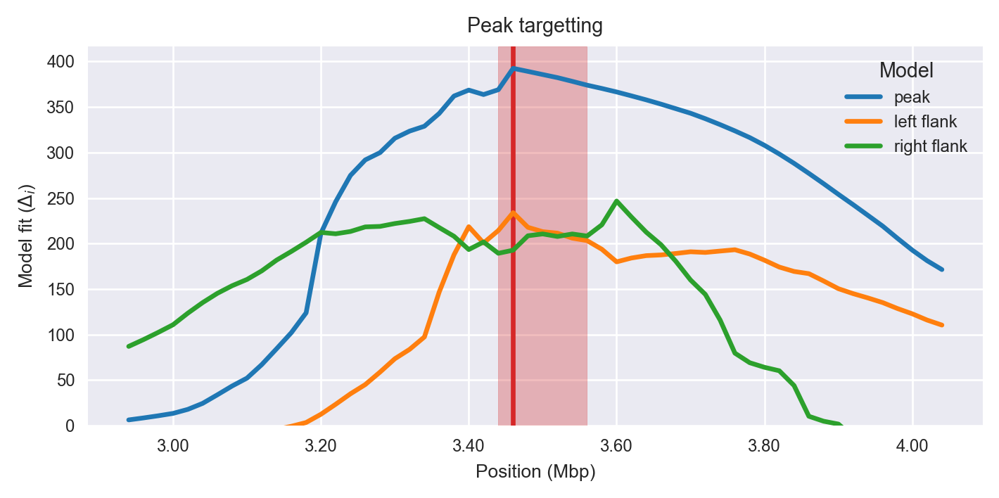

find the next peak
next peak: 8 357.738
Iteration 6
Peak center (index, location): 8, 160001.0
Delta AIC: 357.7
Flank delta AICs: -0.5, 272.0
find limits of peak
peak limits: 1 360000 0 19
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 59
    # data points      = 158
    # variables        = 4
    chi-square         = 0.005
    reduced chi-square = 0.000
    Akaike info crit   = -1627.824
    Bayesian info crit = -1615.574
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.07903317 +/- 0.003192 (4.04%) (init= 0.5)
    decay:       0.50054426 +/- 0.076858 (15.35%) (init= 0.5)
    skew:        0.99999998 +/- 0.176283 (17.63%) (init= 0)
    baseline:    0.01241810 +/- 0.000510 (4.11%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, skew)               =  0.880 
    C(ampl

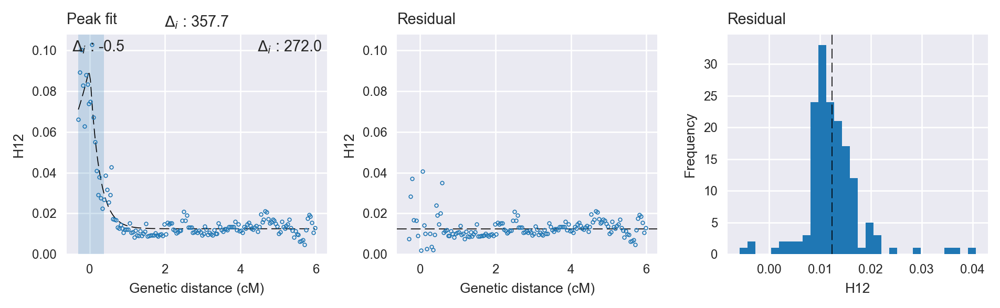

find the next peak
next peak: 2048 324.918
Iteration 6
Peak center (index, location): 2048, 40960001.0
Delta AIC: 324.9
Flank delta AICs: 247.6, 106.9
find limits of peak
peak limits: 40320001 41460000 2016 2074
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 28
    # data points      = 298
    # variables        = 4
    chi-square         = 0.100
    reduced chi-square = 0.000
    Akaike info crit   = -2377.269
    Bayesian info crit = -2362.480
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.09639405 +/- 0.004353 (4.52%) (init= 0.5)
    sigma:       0.62794265 +/- 0.034271 (5.46%) (init= 0.5)
    skew:        0.16944906 +/- 0.060685 (35.81%) (init= 0)
    baseline:    0.03763252 +/- 0.001255 (3.34%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.462 
    C(sigma, baseline)           = 

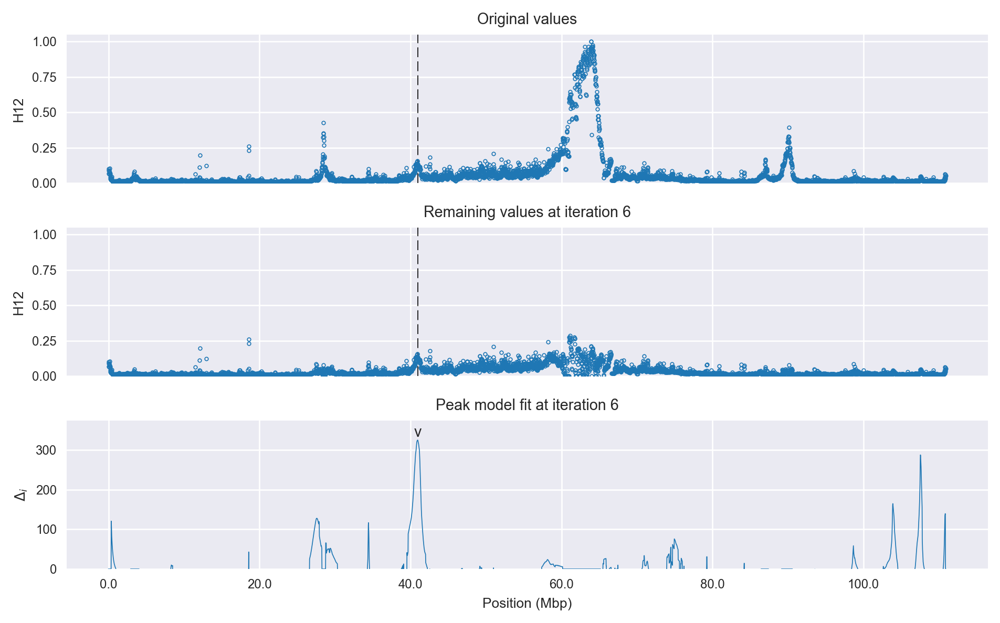

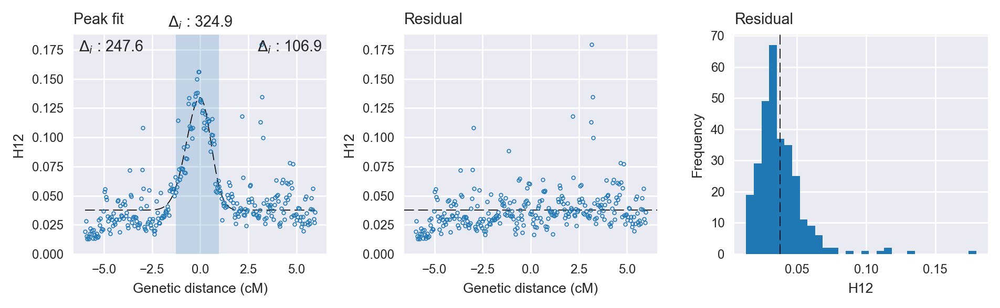

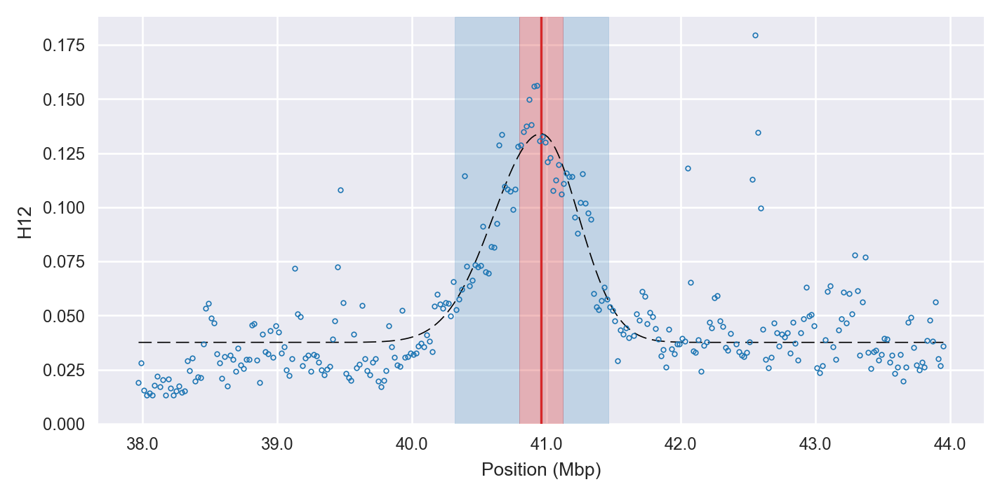

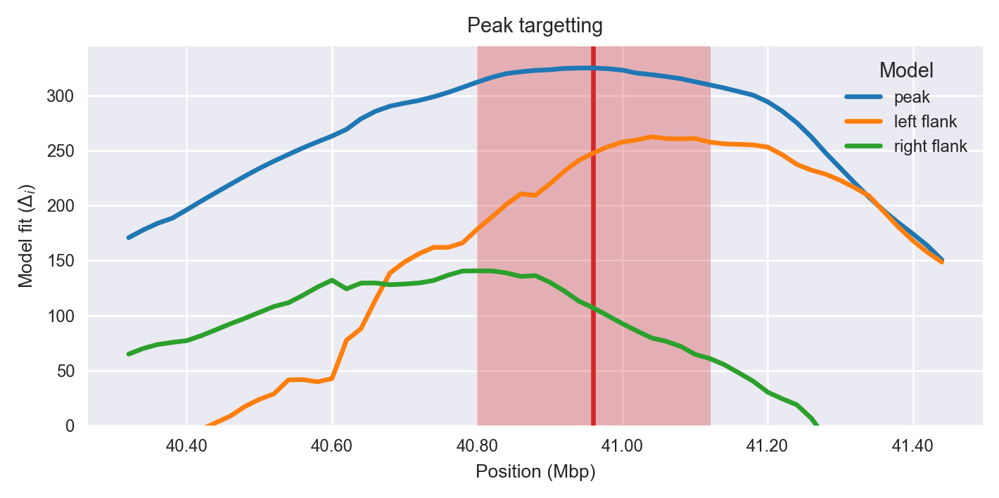

find the next peak
next peak: 5377 287.602
Iteration 7
Peak center (index, location): 5377, 107540001.0
Delta AIC: 287.6
Flank delta AICs: 146.9, 168.7
find limits of peak
peak limits: 107425106 107825105 5372 5393
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 63
    # data points      = 300
    # variables        = 4
    chi-square         = 0.004
    reduced chi-square = 0.000
    Akaike info crit   = -3366.468
    Bayesian info crit = -3351.653
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.03657117 +/- 0.002093 (5.72%) (init= 0.5)
    decay:       0.21868004 +/- 0.019501 (8.92%) (init= 0.5)
    skew:       -0.67231977 +/- 0.091382 (13.59%) (init= 0)
    baseline:    0.01155281 +/- 0.000229 (1.98%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.645 
    C(decay, skew)      

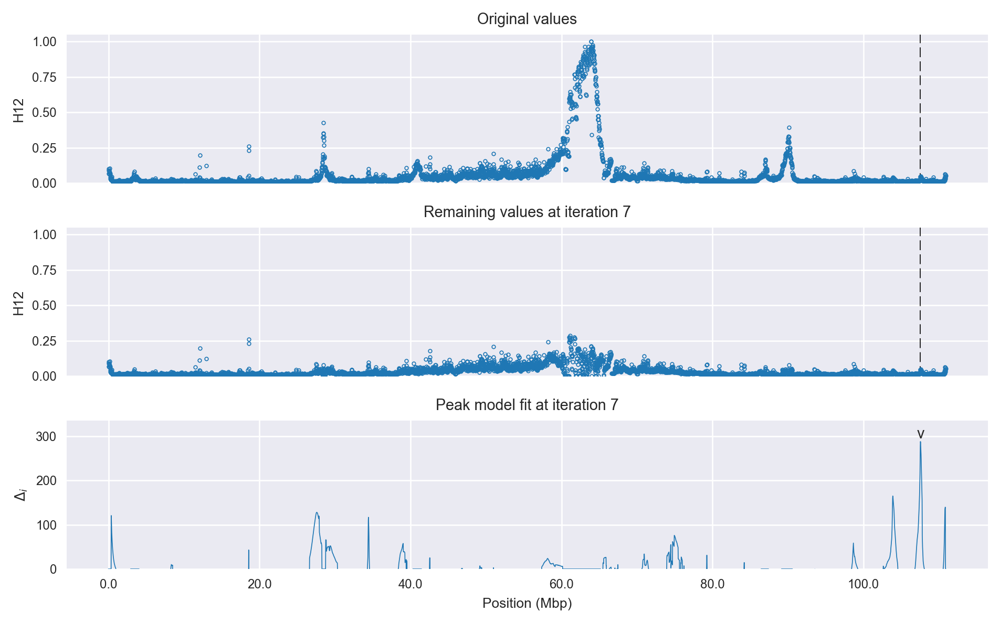

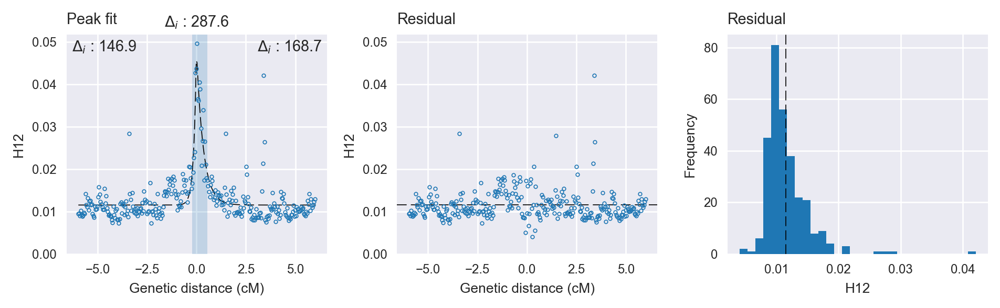

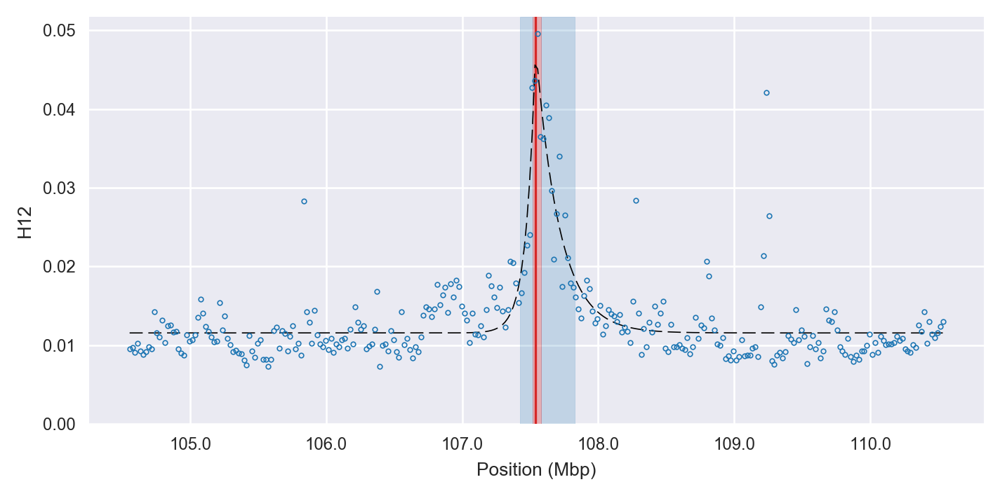

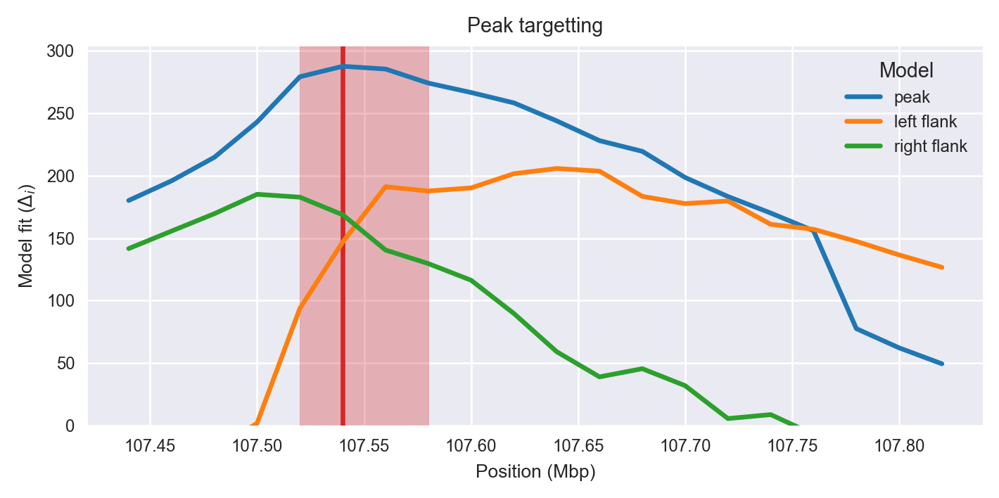

find the next peak
next peak: 5194 164.69
Iteration 8
Peak center (index, location): 5194, 103880001.0
Delta AIC: 164.7
Flank delta AICs: 36.7, 194.5
find limits of peak
peak limits: 103805106 104165105 5191 5210
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 58
    # data points      = 300
    # variables        = 4
    chi-square         = 0.006
    reduced chi-square = 0.000
    Akaike info crit   = -3250.287
    Bayesian info crit = -3235.472
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.02449015 +/- 0.001840 (7.52%) (init= 0.5)
    sigma:       0.16026391 +/- 0.016153 (10.08%) (init= 0.5)
    skew:       -0.94757127 +/- 0.124395 (13.13%) (init= 0)
    baseline:    0.01266914 +/- 0.000266 (2.10%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               =  0.493 
    C(amplitude, sigma)          

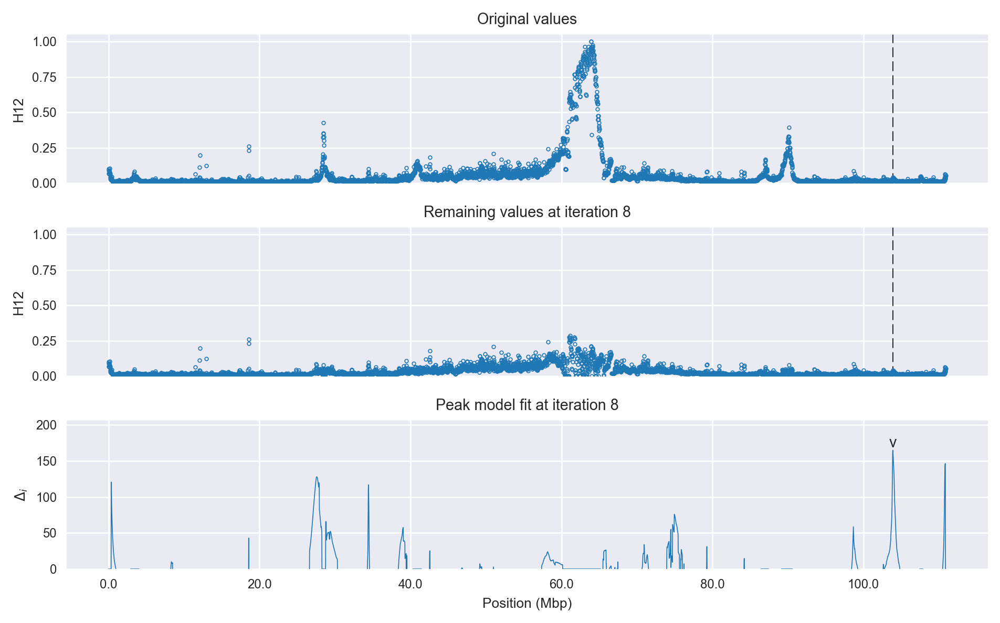

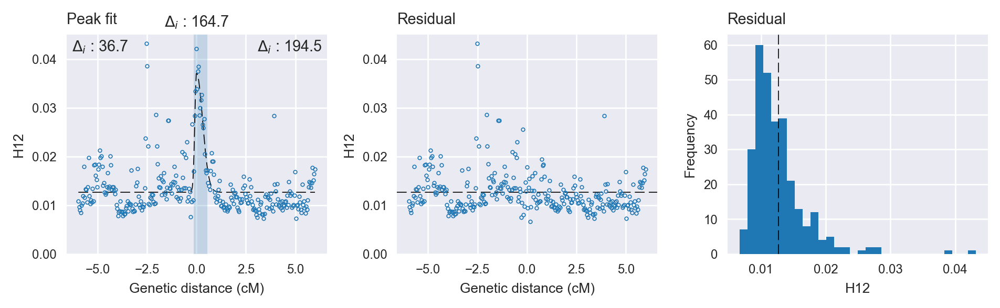

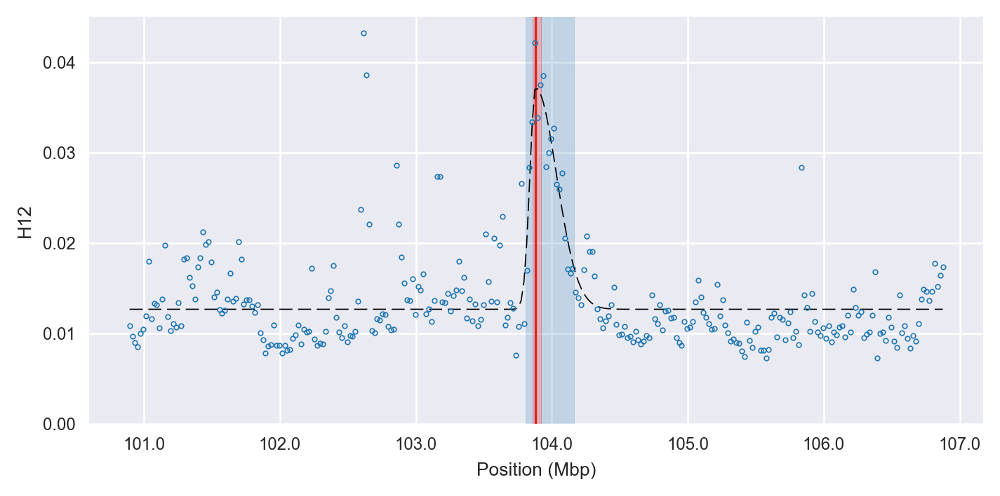

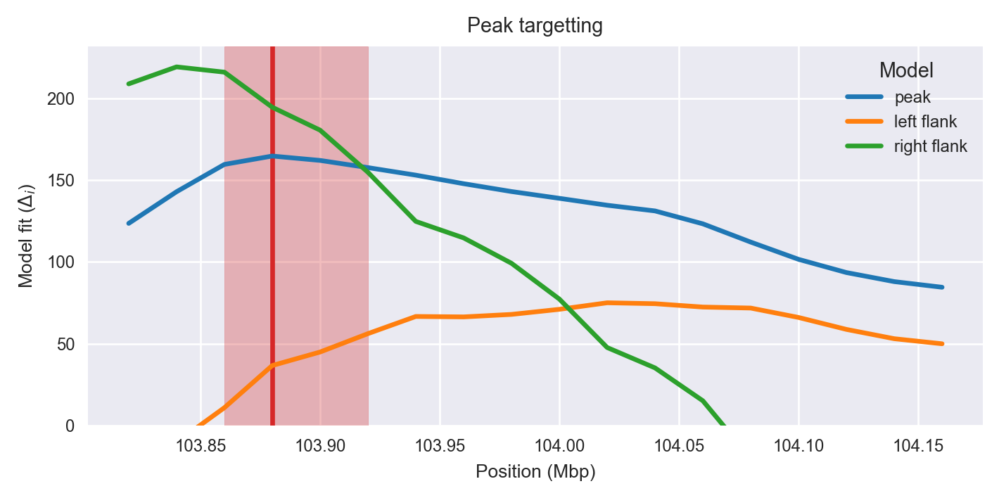

find the next peak
next peak: 5541 146.259
Iteration 9
Peak center (index, location): 5541, 110820001.0
Delta AIC: 146.3
Flank delta AICs: 128.9, 1.8
find limits of peak
peak limits: 110685106 110905105 5535 5547
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 93
    # data points      = 154
    # variables        = 4
    chi-square         = 0.004
    reduced chi-square = 0.000
    Akaike info crit   = -1622.715
    Bayesian info crit = -1610.567
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.03466745 +/- 0.002550 (7.36%) (init= 0.5)
    sigma:       0.30215782 +/- 0.404149 (133.75%) (init= 0.5)
    skew:       -0.99999999 +/- 0.500790 (50.08%) (init= 0)
    baseline:    0.01135741 +/- 0.000430 (3.79%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               =  

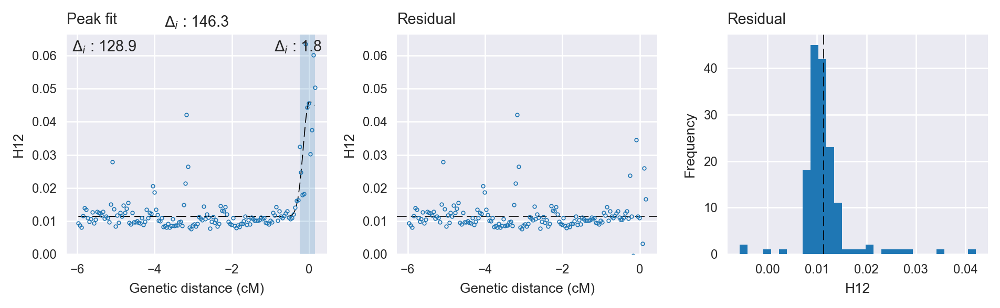

find the next peak
next peak: 1380 127.832
Iteration 9
Peak center (index, location): 1380, 27600001.0
Delta AIC: 127.8
Flank delta AICs: 120.3, 5.1
find limits of peak
peak limits: 26700001 30600000 1335 1531
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 333
    # data points      = 300
    # variables        = 4
    chi-square         = 0.038
    reduced chi-square = 0.000
    Akaike info crit   = -2684.124
    Bayesian info crit = -2669.308
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.02355989 +/- 0.001788 (7.59%) (init= 0.5)
    sigma:       1.99997482 +/- 0.196659 (9.83%) (init= 0.5)
    skew:       -0.99999992 +/- 0.113543 (11.35%) (init= 0)
    baseline:    0.01086621 +/- 0.001232 (11.34%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, baseline)       = -0.6

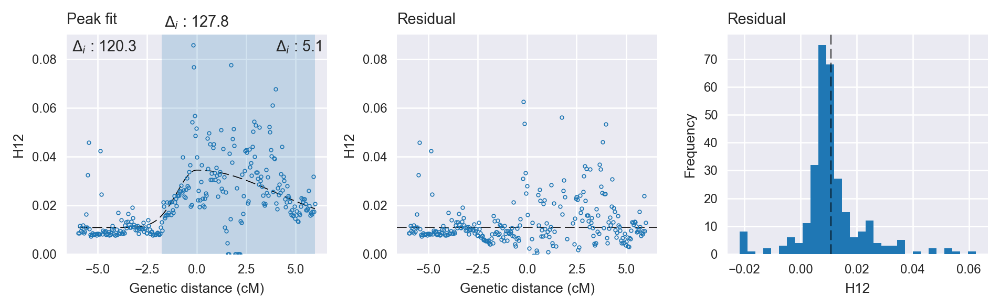

find the next peak
next peak: 19 120.616
Iteration 9
Peak center (index, location): 19, 380001.0
Delta AIC: 120.6
Flank delta AICs: -4.2, -80.1
find limits of peak
peak limits: 1 600000 0 31
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 65
    # data points      = 167
    # variables        = 4
    chi-square         = 0.024
    reduced chi-square = 0.000
    Akaike info crit   = -1469.452
    Bayesian info crit = -1456.980
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.04259828 +/- 0.003728 (8.75%) (init= 0.5)
    sigma:       0.48583777 +/- 0.109627 (22.56%) (init= 0.5)
    skew:        1          +/- 0.118485 (11.85%) (init= 0)
    baseline:    0.01241616 +/- 0.001056 (8.51%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               =  0.732 
    C(amplitude,

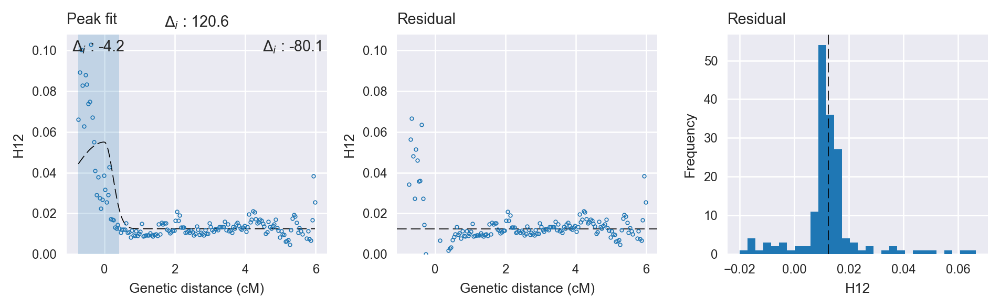

find the next peak
next peak: 1722 116.689
Iteration 9
Peak center (index, location): 1722, 34440001.0
Delta AIC: 116.7
Flank delta AICs: 123.2, 52.2
find limits of peak
peak limits: 34360001 34540000 1718 1728
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 54
    # data points      = 299
    # variables        = 4
    chi-square         = 0.019
    reduced chi-square = 0.000
    Akaike info crit   = -2876.006
    Bayesian info crit = -2861.205
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.07992131 +/- 0.007638 (9.56%) (init= 0.5)
    decay:       0.10000005 +/- 0.013576 (13.58%) (init= 0.5)
    skew:       -0.07897187 +/- 0.130763 (165.58%) (init= 0)
    baseline:    0.01813323 +/- 0.000485 (2.68%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.723 
    C(decay, baseline)    

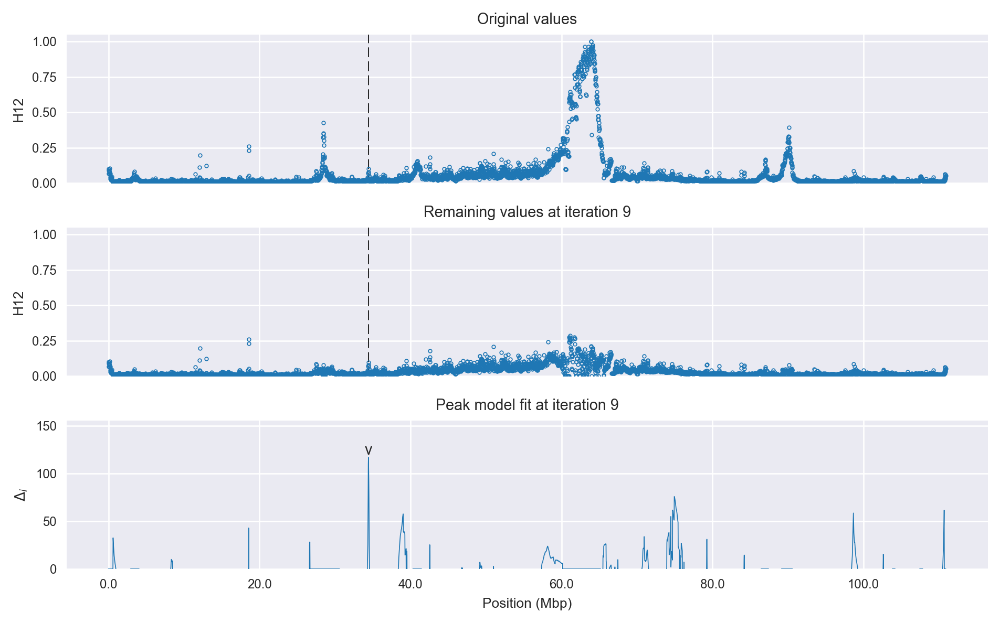

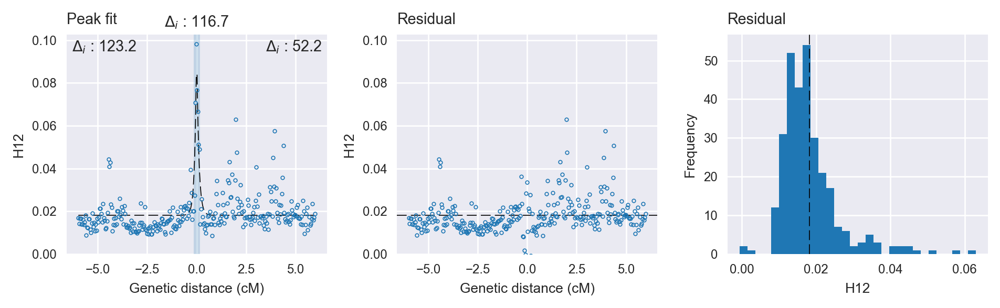

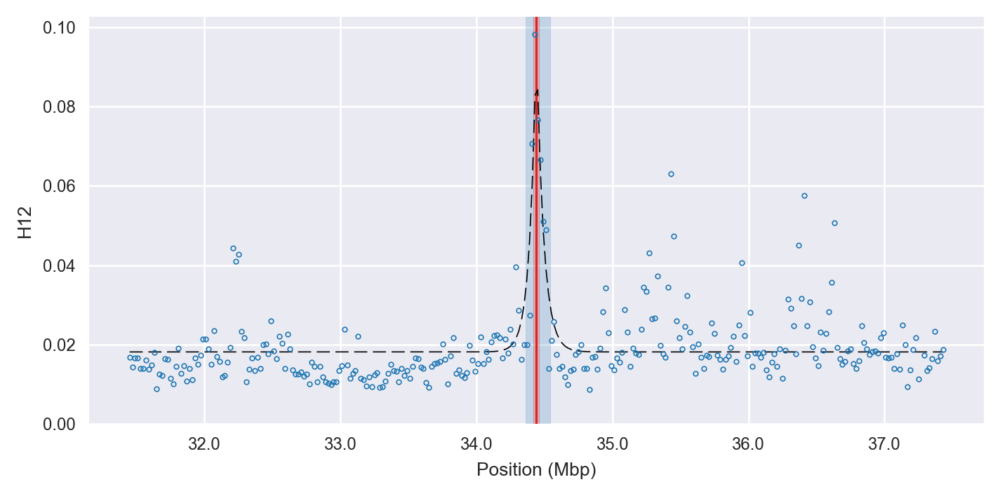

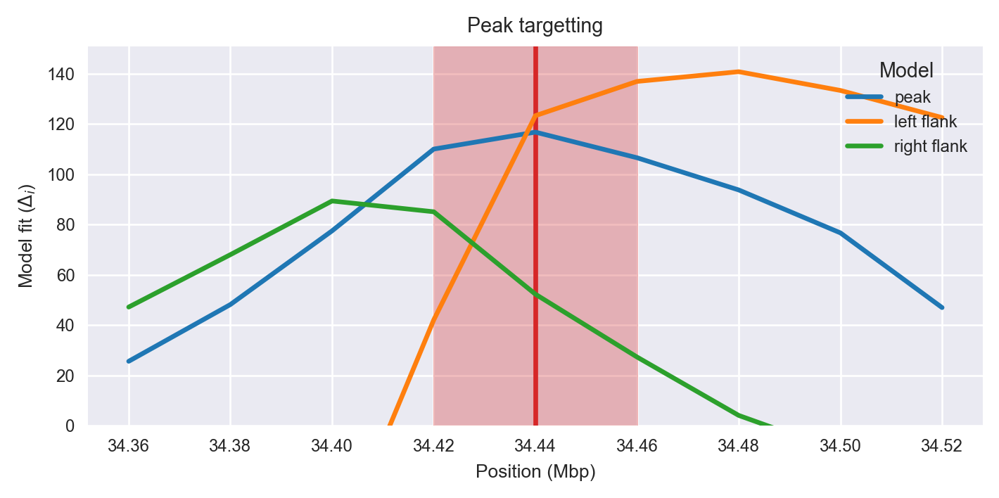

find the next peak
next peak: 3747 75.8722
all done


In [18]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=6, gmap=gmap['2'], fitters=[skewed_gauss_fitter, skewed_exp_fitter], show_plots=True, 
                           statistic_label='H12', log_file=None)
peaks = list(peaks)

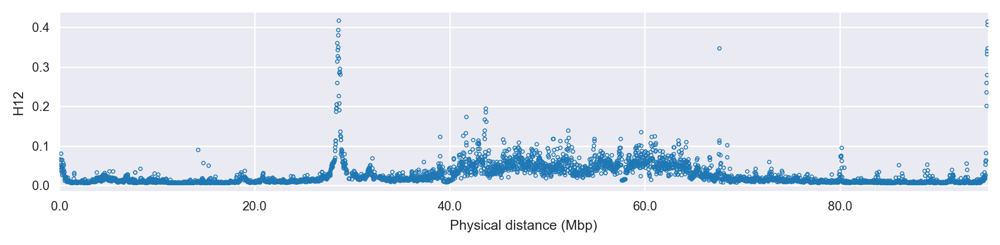

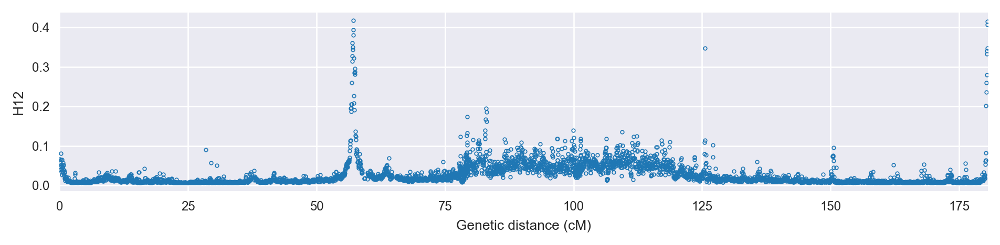

In [19]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df_h12, seqid=('3R', '3L'), genome=genome, values_col='BFS', seqid_col='chrom', starts_col='start', ends_col='stop')
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12');
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12', gmap=gmap['3']);
centers = np.arange(1, ends[-1], 20000)

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 44.0000020019
scan progress 1200 48.000002006
scan progress 1300 52.0000020101
scan progress 1400 56.0000020142
scan progress 1500 60.0000020183
scan progress 1600 64.0000020224
scan progress 1700 68.0000020123
scan progress 1800 72.0000020023
scan progress 1900 76.0000019922
scan progress 2000 78.4831344859
scan progress 2100 79.6928389828
scan progress 2200 83.6928389727
scan progress 2300 87.6928389626
scan progress 2400 91.6928389525
scan progress 2500 95.6928389424
scan progress 2600 99.6928389323
scan progress 2700 100.93565143
scan progress 2800 103.41194843
scan progress 2900 106.61004093
scan progress 3000 110.26147843
sca

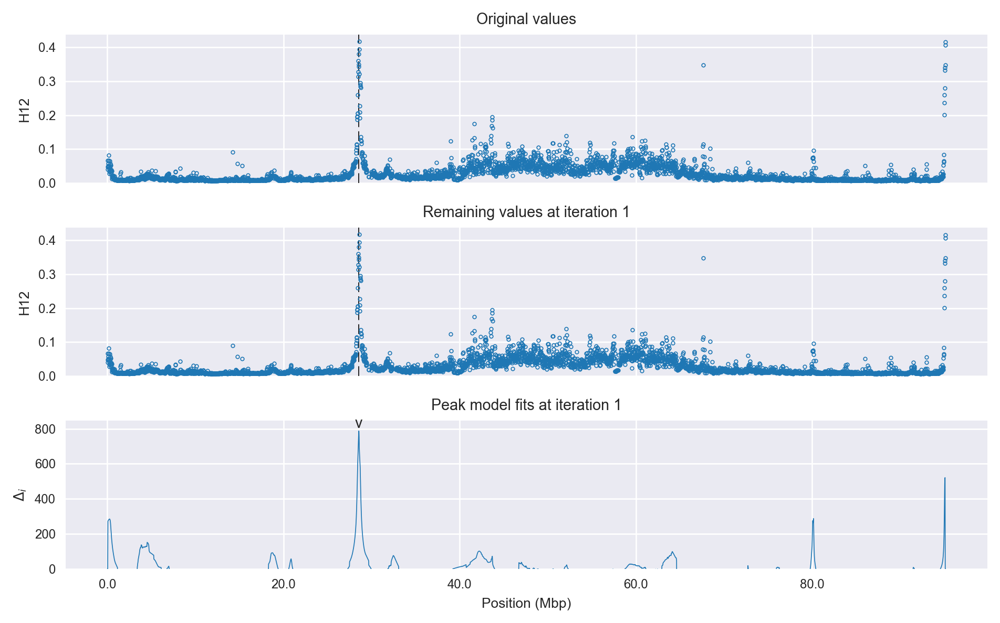

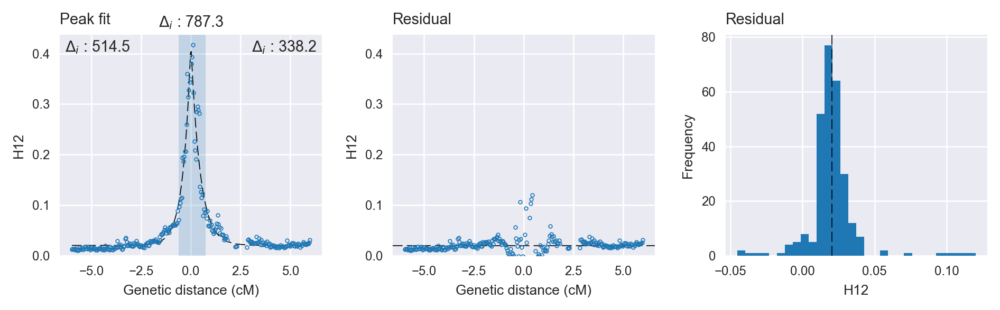

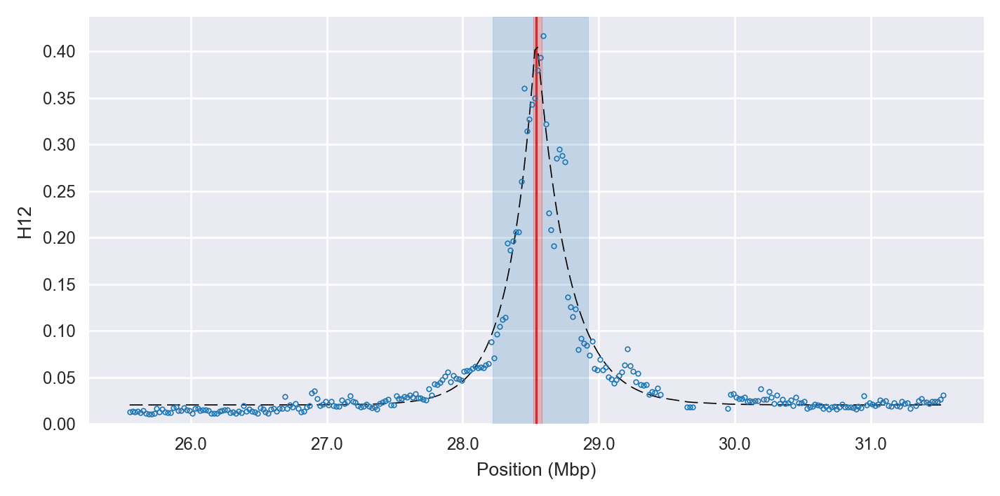

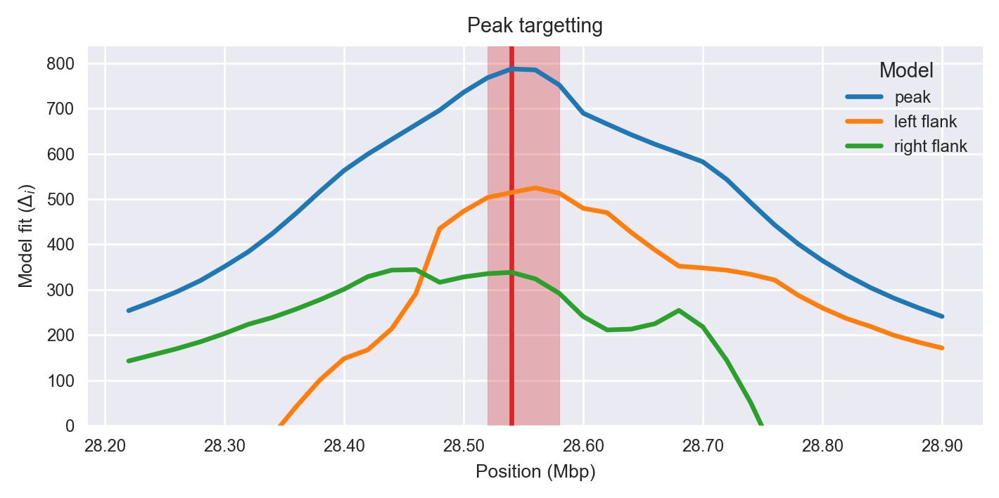

find the next peak
next peak: 4755 521.048
Iteration 2
Peak center (index, location): 4755, 95100001.0
Delta AIC: 521.0
Flank delta AICs: 479.2, 0.4
find limits of peak
peak limits: 94940685 95160684 4748 4760
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 60
    # data points      = 153
    # variables        = 4
    chi-square         = 0.023
    reduced chi-square = 0.000
    Akaike info crit   = -1341.461
    Bayesian info crit = -1329.339
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.35673020 +/- 0.006372 (1.79%) (init= 0.5)
    sigma:       0.34180033 +/- 0.307882 (90.08%) (init= 0.5)
    skew:       -1          +/- 0.001888 (0.19%) (init= 0)
    baseline:    0.01058352 +/- 0.001045 (9.88%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               =  1.000

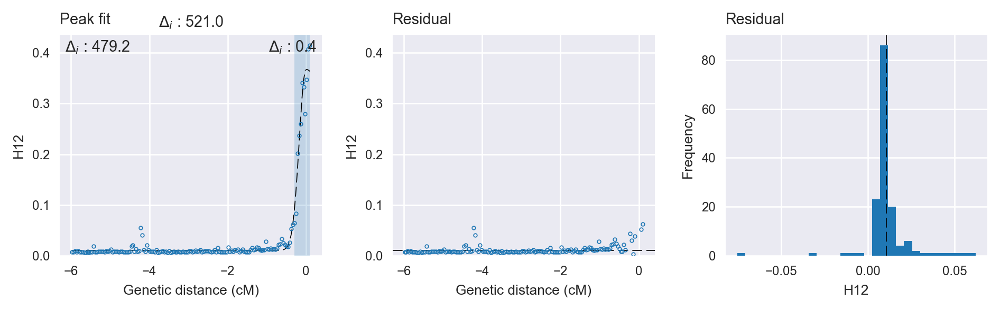

find the next peak
next peak: 4008 287.623
Iteration 2
Peak center (index, location): 4008, 80160001.0
Delta AIC: 287.6
Flank delta AICs: 171.3, 197.1
find limits of peak
peak limits: 79960685 80220684 3999 4013
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 48
    # data points      = 298
    # variables        = 4
    chi-square         = 0.009
    reduced chi-square = 0.000
    Akaike info crit   = -3081.276
    Bayesian info crit = -3066.488
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.05987529 +/- 0.002740 (4.58%) (init= 0.5)
    sigma:       0.11647163 +/- 0.007230 (6.21%) (init= 0.5)
    skew:        0.98945568 +/- 0.076450 (7.73%) (init= 0)
    baseline:    0.00998900 +/- 0.000338 (3.39%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.513 
    C(amplitude, sigma)          = -

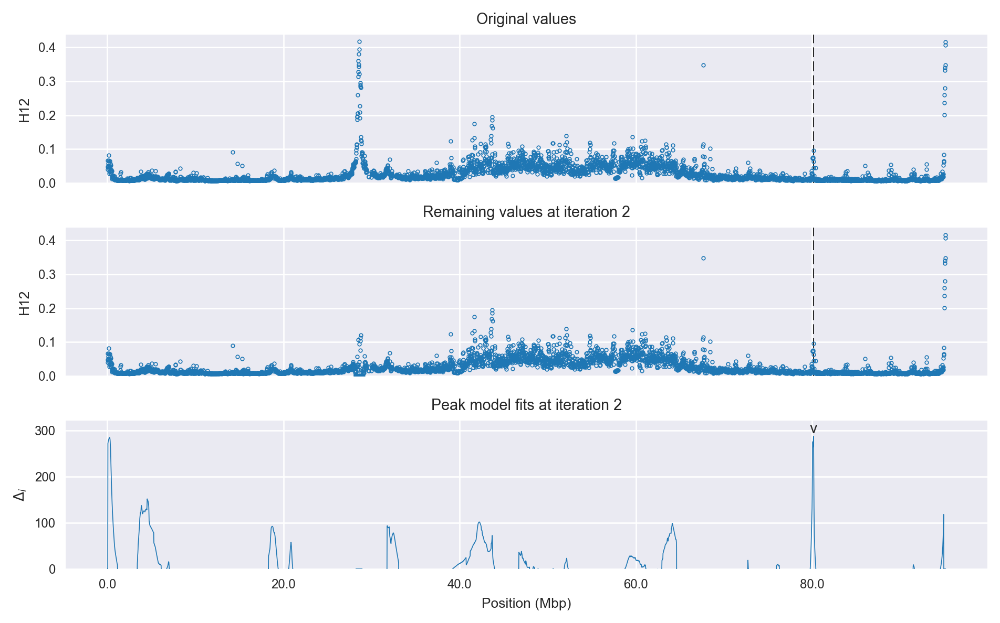

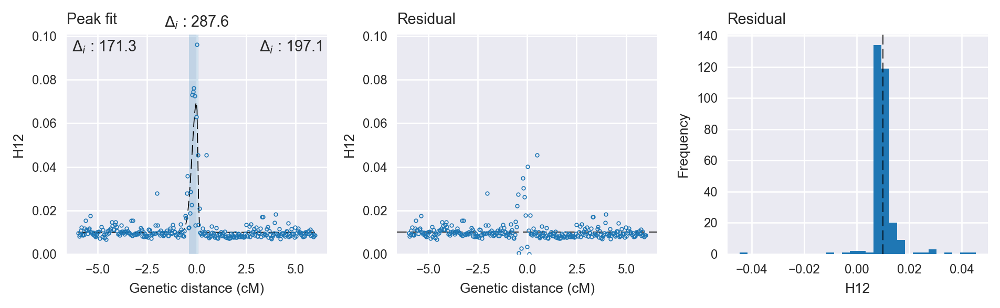

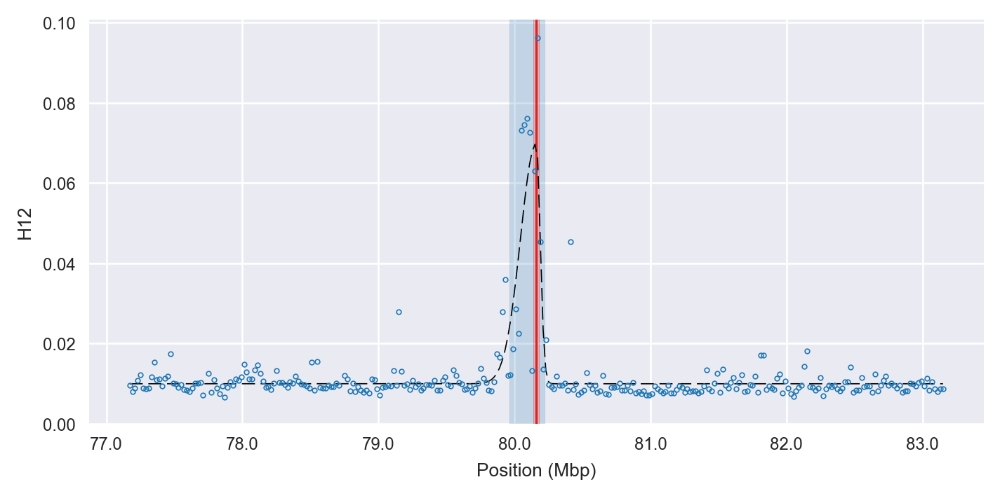

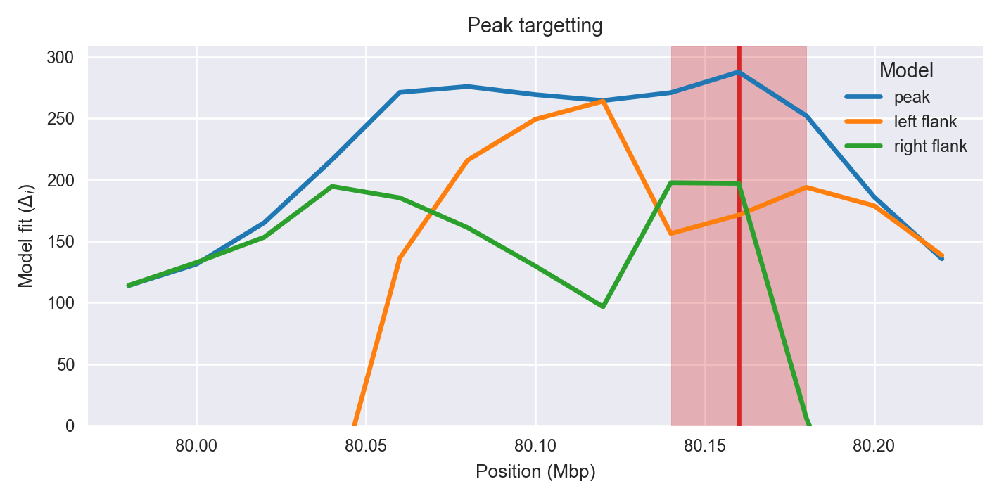

find the next peak
next peak: 12 285.144
Iteration 3
Peak center (index, location): 12, 240001.0
Delta AIC: 285.1
Flank delta AICs: 1.7, 270.3
find limits of peak
peak limits: 1 600000 0 31
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 54
    # data points      = 162
    # variables        = 4
    chi-square         = 0.005
    reduced chi-square = 0.000
    Akaike info crit   = -1663.658
    Bayesian info crit = -1651.307
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.04191131 +/- 0.001803 (4.30%) (init= 0.5)
    sigma:       0.78839262 +/- 0.503886 (63.91%) (init= 0.5)
    skew:        0.99999997 +/- 0.166125 (16.61%) (init= 0)
    baseline:    0.00933221 +/- 0.000522 (5.60%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.995 
    C(amplitude, 

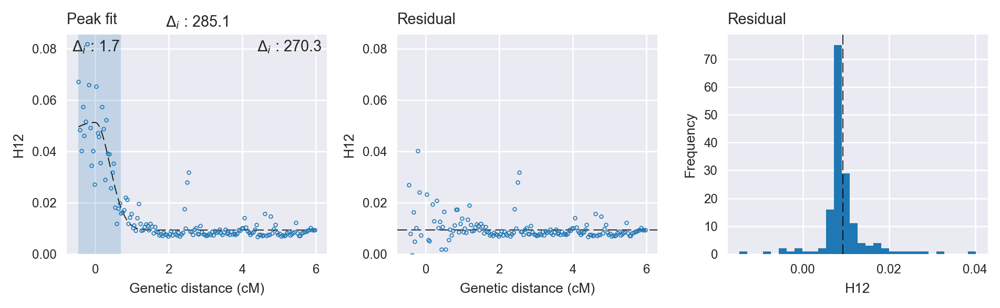

find the next peak
next peak: 226 151.949
Iteration 3
Peak center (index, location): 226, 4520001.0
Delta AIC: 151.9
Flank delta AICs: 135.9, 27.8
find limits of peak
peak limits: 3560001 7220000 178 362
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 52
    # data points      = 300
    # variables        = 4
    chi-square         = 0.005
    reduced chi-square = 0.000
    Akaike info crit   = -3278.837
    Bayesian info crit = -3264.022
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.01301763 +/- 0.000915 (7.03%) (init= 0.5)
    decay:       1.99999818 +/- 0.345384 (17.27%) (init= 0.5)
    skew:       -0.73889095 +/- 0.110428 (14.95%) (init= 0)
    baseline:    0.00907073 +/- 0.000640 (7.06%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(decay, baseline)           = -0.803 
    C(amplitude, baseline)       =

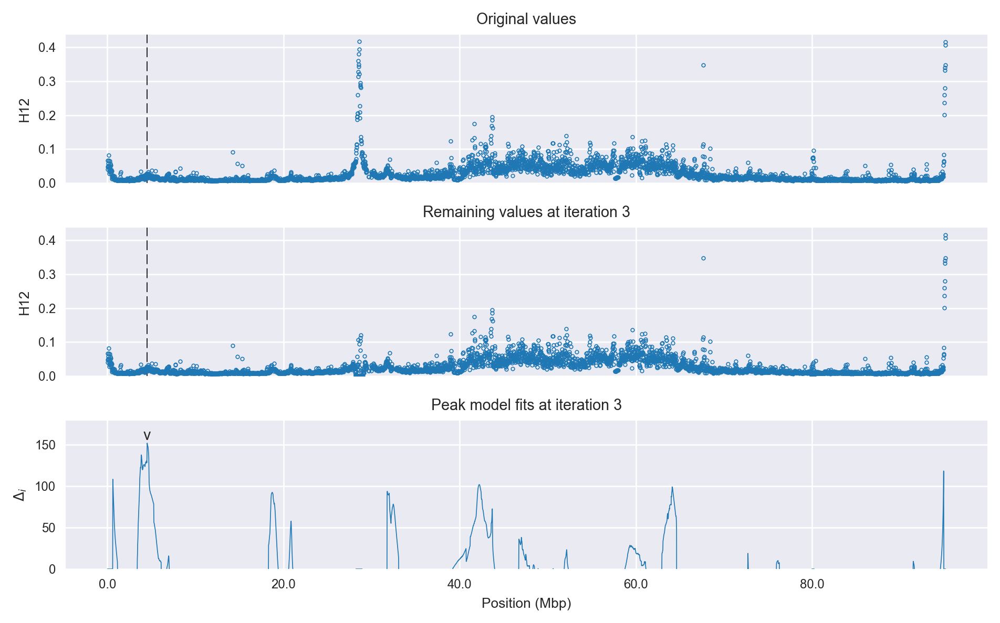

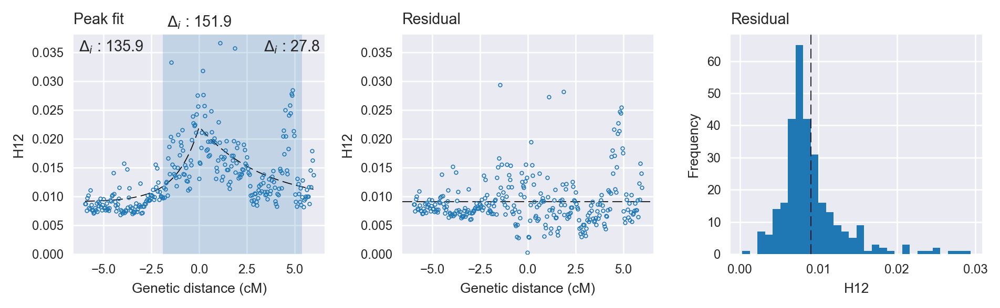

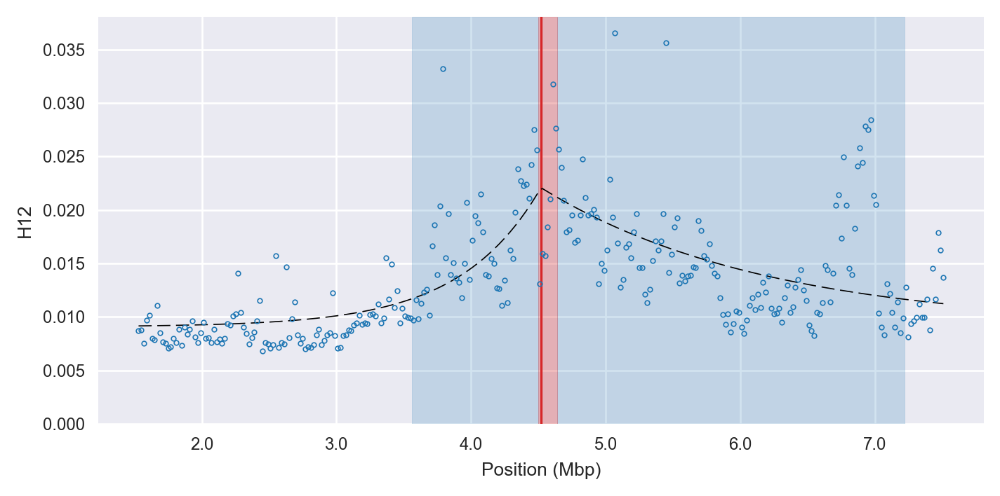

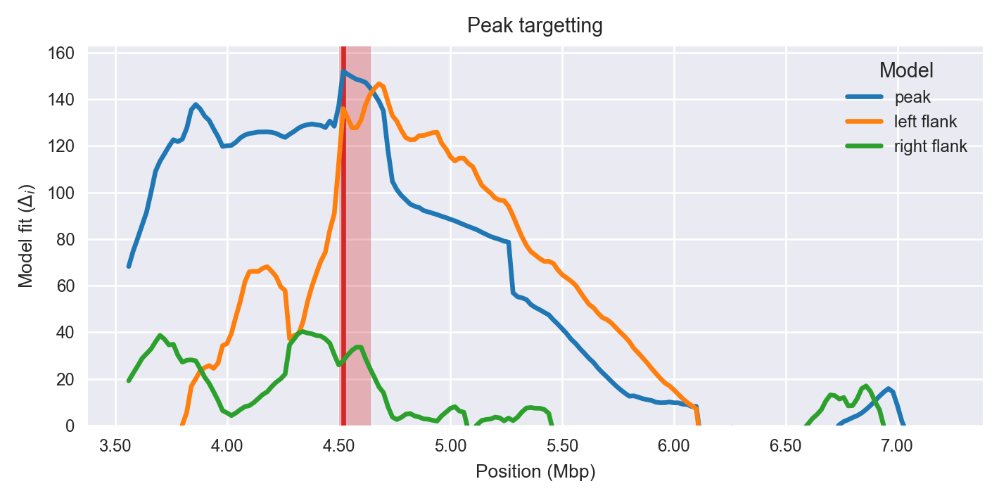

find the next peak
next peak: 4747 118.268
Iteration 4
Peak center (index, location): 4747, 94940001.0
Delta AIC: 118.3
Flank delta AICs: -347.2, -3.3
find limits of peak
peak limits: 94800685 95160684 4741 4760
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 61
    # data points      = 161
    # variables        = 4
    chi-square         = 0.328
    reduced chi-square = 0.002
    Akaike info crit   = -989.562
    Bayesian info crit = -977.236
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.21211821 +/- 0.018005 (8.49%) (init= 0.5)
    sigma:       0.29420063 +/- 0.069387 (23.59%) (init= 0.5)
    skew:       -1          +/- 0.150445 (15.04%) (init= 0)
    baseline:    0.00970935 +/- 0.003858 (39.74%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.7

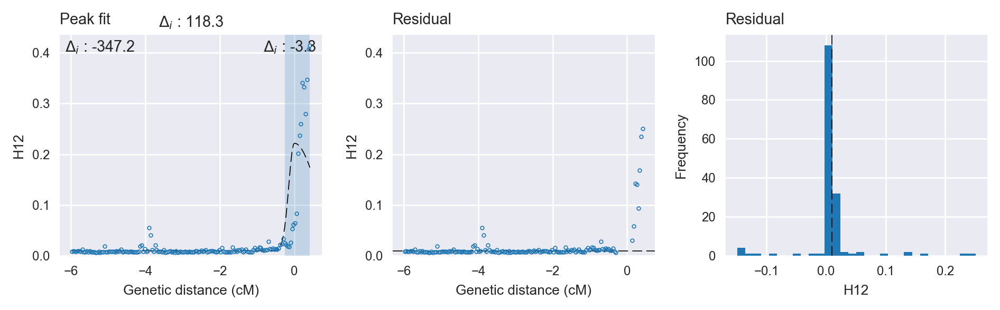

find the next peak
next peak: 31 114.058
Iteration 4
Peak center (index, location): 31, 620001.0
Delta AIC: 114.1
Flank delta AICs: -7.7, -137.0
find limits of peak
peak limits: 1 980000 0 50
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 63
    # data points      = 181
    # variables        = 4
    chi-square         = 0.017
    reduced chi-square = 0.000
    Akaike info crit   = -1668.171
    Bayesian info crit = -1655.377
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.02717508 +/- 0.002412 (8.88%) (init= 0.5)
    sigma:       0.81935289 +/- 0.192843 (23.54%) (init= 0.5)
    skew:        0.99999999 +/- 0.245482 (24.55%) (init= 0)
    baseline:    0.00845906 +/- 0.000889 (10.51%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.756 
    C(amplitud

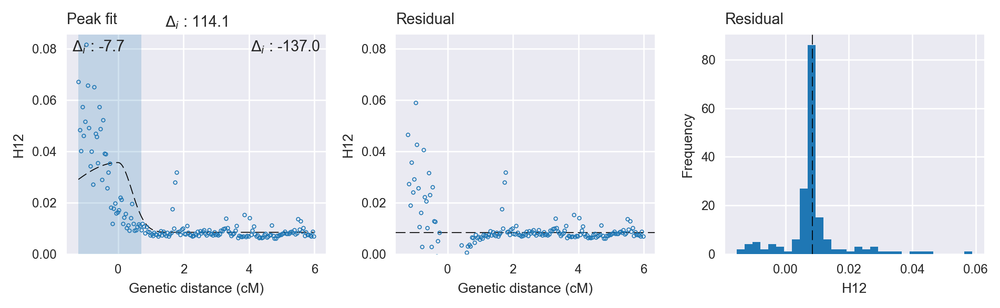

find the next peak
next peak: 2110 101.928
Iteration 4
Peak center (index, location): 2110, 42200001.0
Delta AIC: 101.9
Flank delta AICs: 81.4, 14.4
find limits of peak
peak limits: 39640001 45200000 1982 2261
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 72
    # data points      = 389
    # variables        = 4
    chi-square         = 0.210
    reduced chi-square = 0.001
    Akaike info crit   = -2918.763
    Bayesian info crit = -2902.908
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.04300435 +/- 0.003539 (8.23%) (init= 0.5)
    sigma:       1.99987563 +/- 0.214865 (10.74%) (init= 0.5)
    skew:       -0.99999997 +/- 1.026015 (102.60%) (init= 0)
    baseline:    0.02313471 +/- 0.002479 (10.72%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, baseline)       = -0.

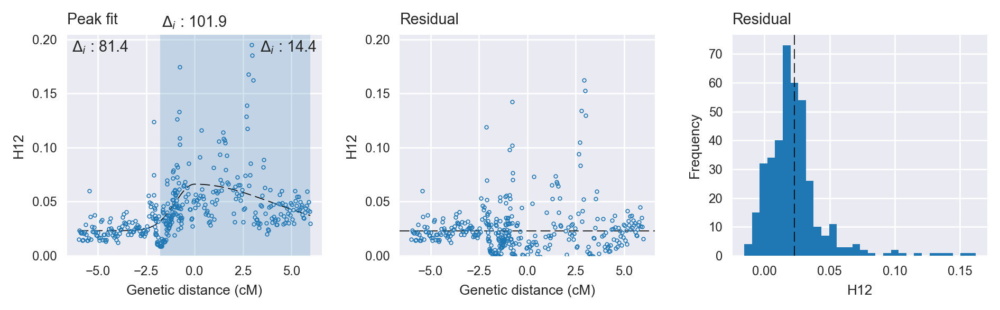

find the next peak
next peak: 3206 99.1631
Iteration 4
Peak center (index, location): 3206, 64120001.0
Delta AIC: 99.2
Flank delta AICs: -10.9, 28.0
find limits of peak
peak limits: 61120685 65020684 3057 3253
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 297
    # data points      = 293
    # variables        = 4
    chi-square         = 0.074
    reduced chi-square = 0.000
    Akaike info crit   = -2419.204
    Bayesian info crit = -2404.483
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.02850336 +/- 0.002553 (8.96%) (init= 0.5)
    sigma:       1.99999603 +/- 0.237556 (11.88%) (init= 0.5)
    skew:        0.99999999 +/- 0.008346 (0.83%) (init= 0)
    baseline:    0.03027837 +/- 0.001752 (5.79%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, baseline)       = -0.61

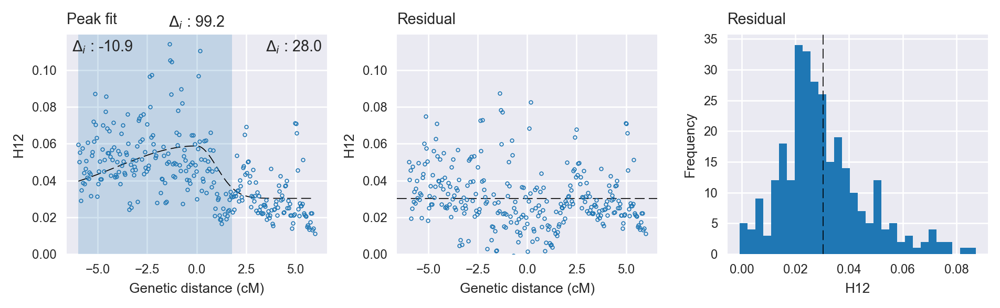

find the next peak
next peak: 1589 93.8074
Iteration 4
Peak center (index, location): 1589, 31780001.0
Delta AIC: 93.8
Flank delta AICs: 36.3, 92.3
find limits of peak
peak limits: 31340001 32220000 1567 1612
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 33
    # data points      = 257
    # variables        = 4
    chi-square         = 0.015
    reduced chi-square = 0.000
    Akaike info crit   = -2501.107
    Bayesian info crit = -2486.911
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.02838520 +/- 0.003056 (10.77%) (init= 0.5)
    decay:       0.53467951 +/- 0.093942 (17.57%) (init= 0.5)
    skew:       -0.02687900 +/- 0.159233 (592.41%) (init= 0)
    baseline:    0.01868241 +/- 0.000590 (3.16%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.632 
    C(decay, baseline)     

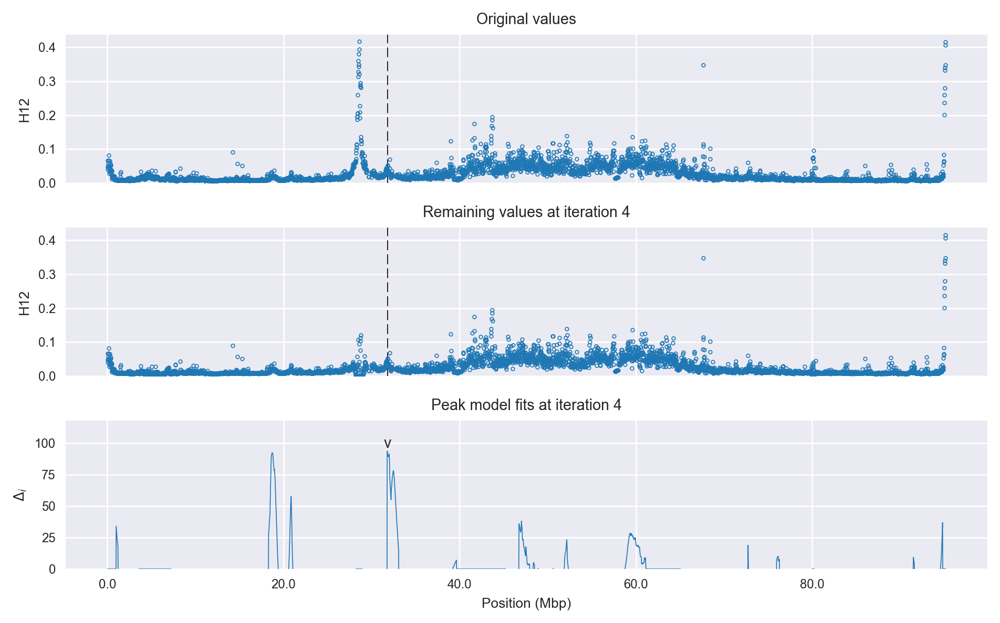

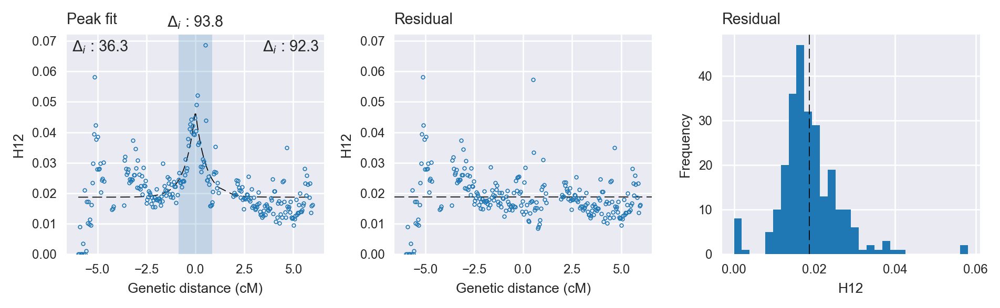

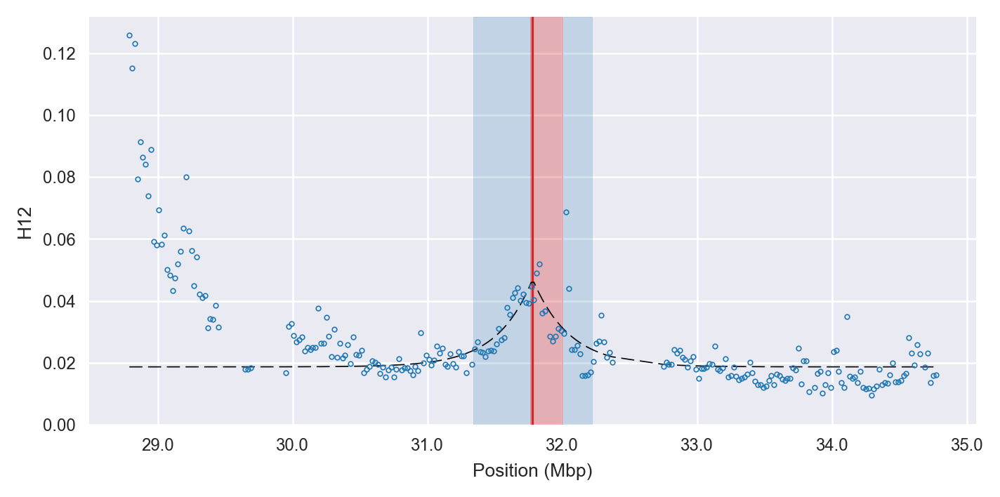

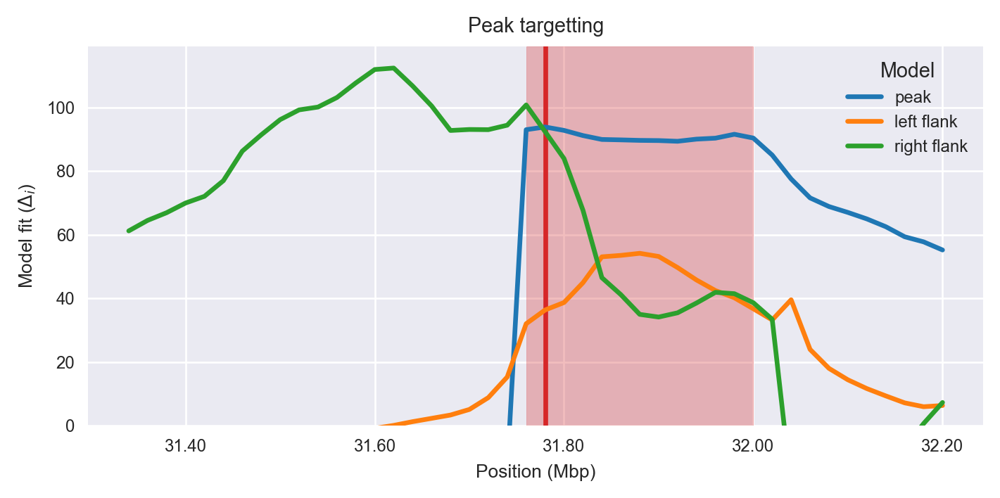

find the next peak
next peak: 936 92.4504
Iteration 5
Peak center (index, location): 936, 18720001.0
Delta AIC: 92.5
Flank delta AICs: 92.5, 24.5
find limits of peak
peak limits: 18440001 19220000 922 962
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 48
    # data points      = 287
    # variables        = 4
    chi-square         = 0.004
    reduced chi-square = 0.000
    Akaike info crit   = -3169.964
    Bayesian info crit = -3155.326
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.01728498 +/- 0.002091 (12.10%) (init= 0.5)
    sigma:       0.40713320 +/- 0.041163 (10.11%) (init= 0.5)
    skew:       -0.40743292 +/- 0.093828 (23.03%) (init= 0)
    baseline:    0.01010989 +/- 0.000255 (2.52%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.720 
    C(sigma, baseline)           = -0.25

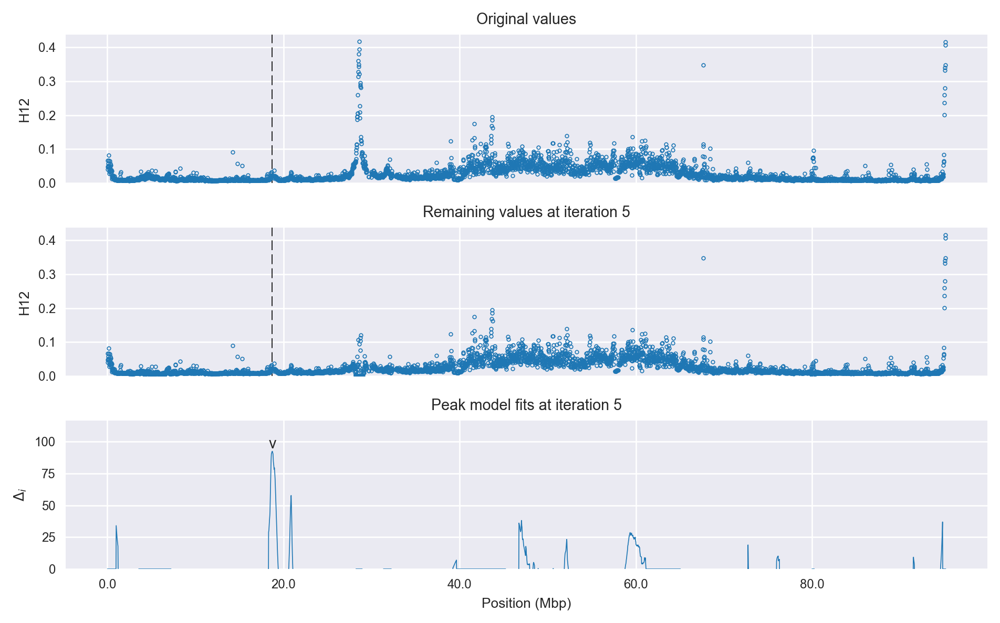

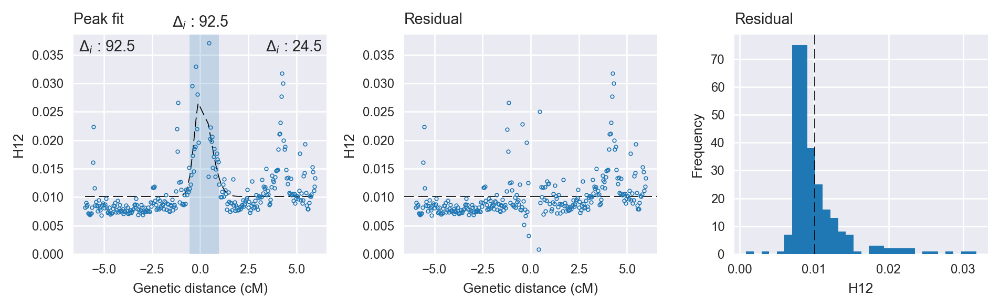

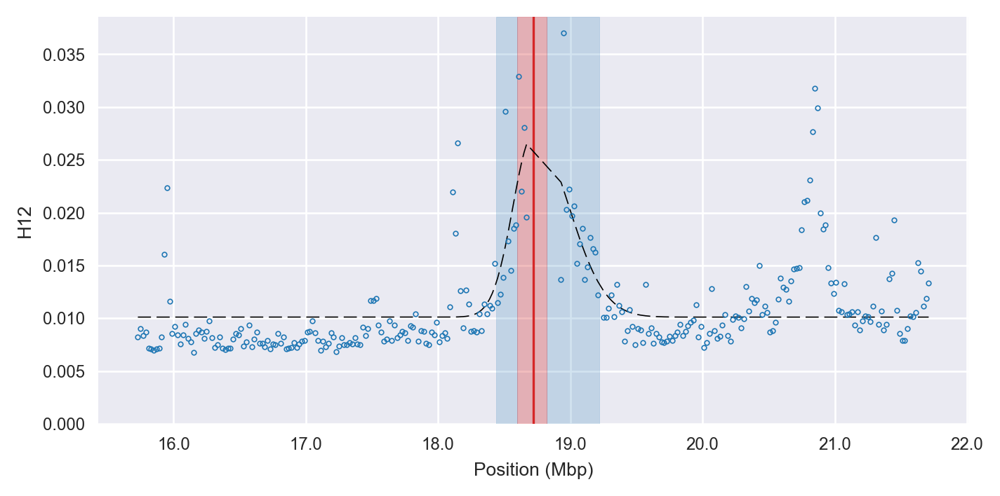

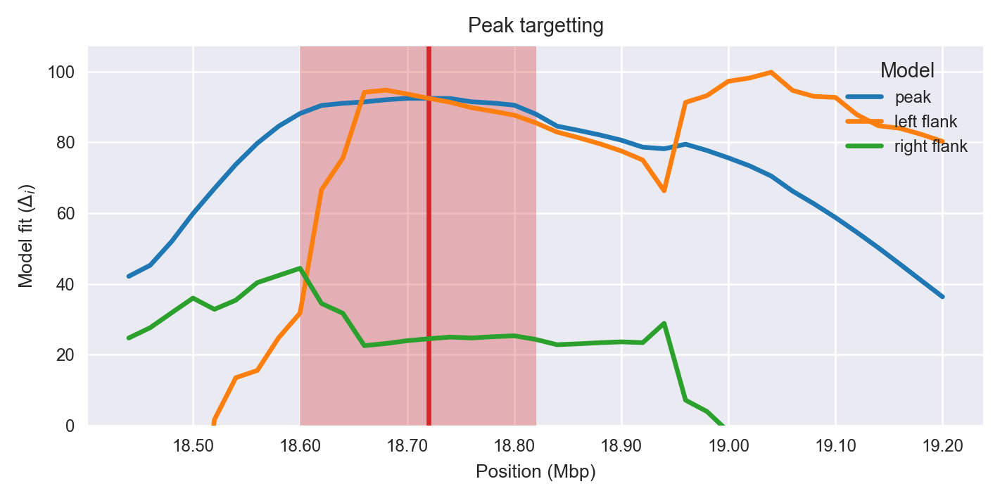

find the next peak
next peak: 1043 135.487
Iteration 6
Peak center (index, location): 1043, 20860001.0
Delta AIC: 135.5
Flank delta AICs: 86.3, 70.5
find limits of peak
peak limits: 20700001 20960000 1035 1049
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 43
    # data points      = 284
    # variables        = 4
    chi-square         = 0.002
    reduced chi-square = 0.000
    Akaike info crit   = -3305.380
    Bayesian info crit = -3290.784
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.02285557 +/- 0.002203 (9.64%) (init= 0.5)
    decay:       0.14423906 +/- 0.020544 (14.24%) (init= 0.5)
    skew:        0.43359087 +/- 0.141656 (32.67%) (init= 0)
    baseline:    0.01030949 +/- 0.000185 (1.80%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.688 
    C(decay, baseline)      

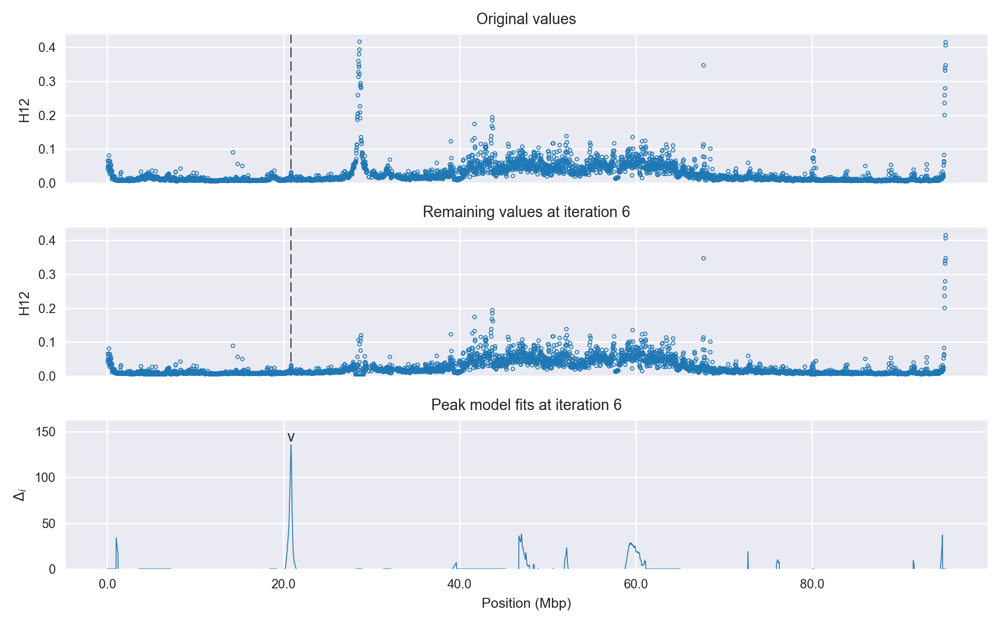

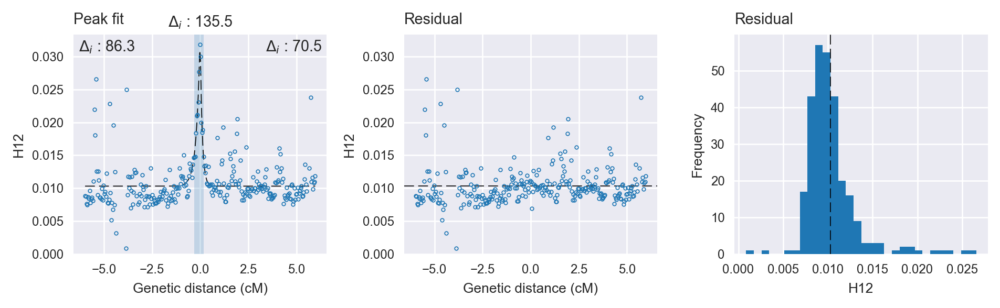

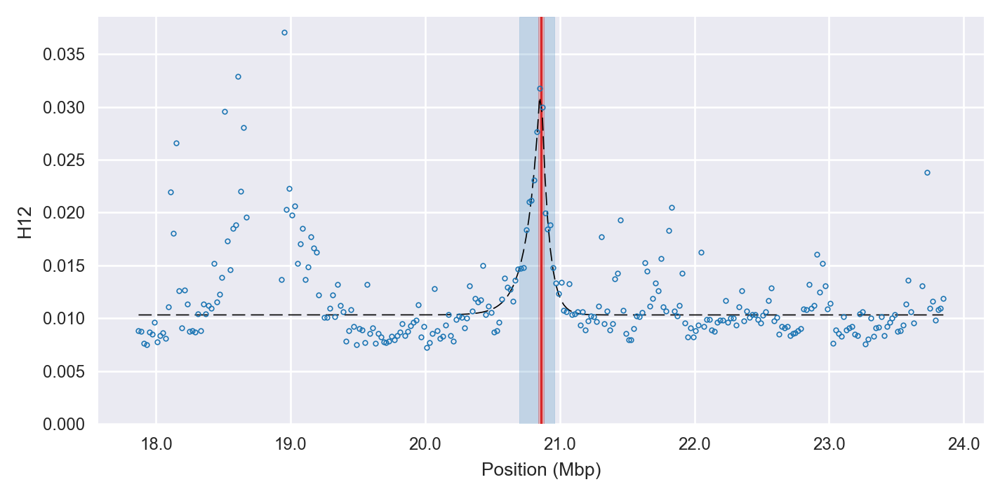

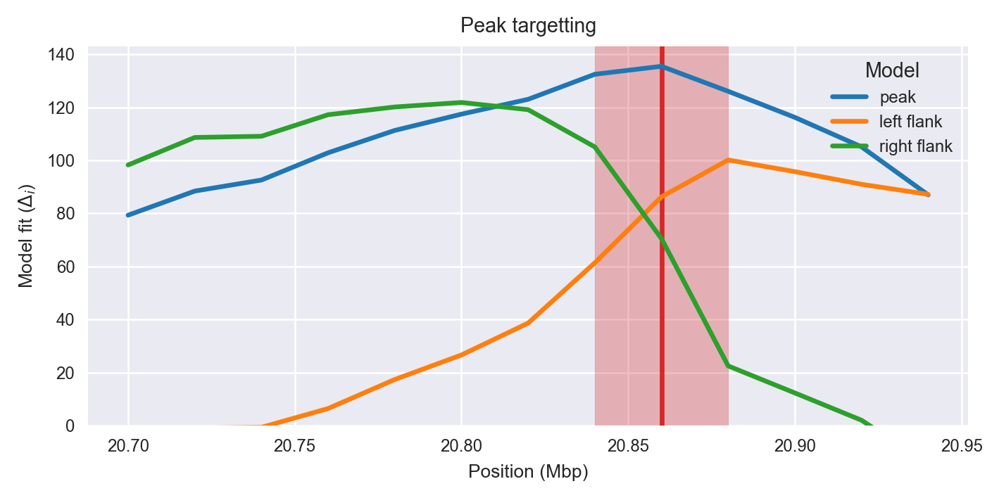

find the next peak
next peak: 2350 38.1634
all done


In [20]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=6, gmap=gmap['3'], fitters=[skewed_gauss_fitter, skewed_exp_fitter], show_plots=True, 
                           statistic_label='H12', log_file=None)
peaks = list(peaks)

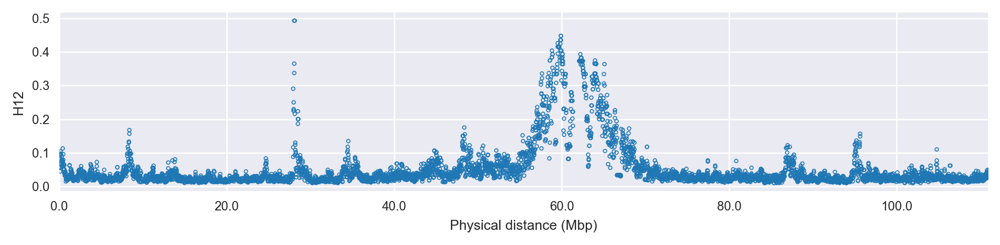

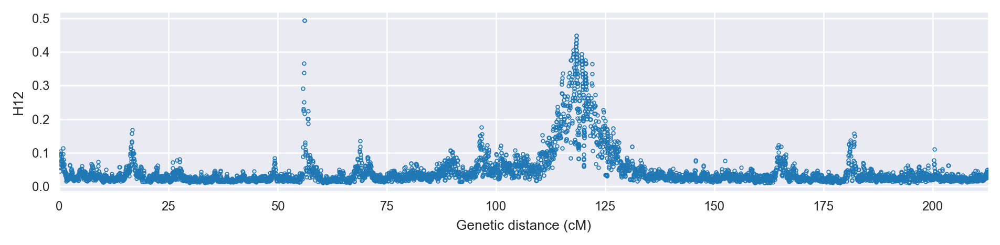

In [22]:
starts, ends, values, percentiles = peakfit.extract_windowed_values(df_h12, seqid=('2R', '2L'), genome=genome, values_col='AOM', seqid_col='chrom', starts_col='start', ends_col='stop')
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12');
peakfit.plot_windowed_values(starts, ends, values, ylabel='H12', gmap=gmap['2']);
centers = np.arange(1, ends[-1], 20000)

scan progress 0 2e-06
scan progress 100 4.00000199985
scan progress 200 8.00000200041
scan progress 300 12.000002001
scan progress 400 16.0000020015
scan progress 500 20.0000019985
scan progress 600 24.0000019955
scan progress 700 28.0000019925
scan progress 800 32.0000019896
scan progress 900 36.0000019937
scan progress 1000 40.0000019978
scan progress 1100 44.0000020019
scan progress 1200 48.000002006
scan progress 1300 52.0000020101
scan progress 1400 56.0000020142
scan progress 1500 60.0000020183
scan progress 1600 64.0000020224
scan progress 1700 68.0000020123
scan progress 1800 72.0000020023
scan progress 1900 76.0000019922
scan progress 2000 80.0000019821
scan progress 2100 84.000001972
scan progress 2200 88.0000019619
scan progress 2300 92.0000019518
scan progress 2400 96.0000019417
scan progress 2500 100.000001932
scan progress 2600 104.000001921
scan progress 2700 108.000001911
scan progress 2800 112.000001901
scan progress 2900 116.000001891
scan progress 3000 118.477165885


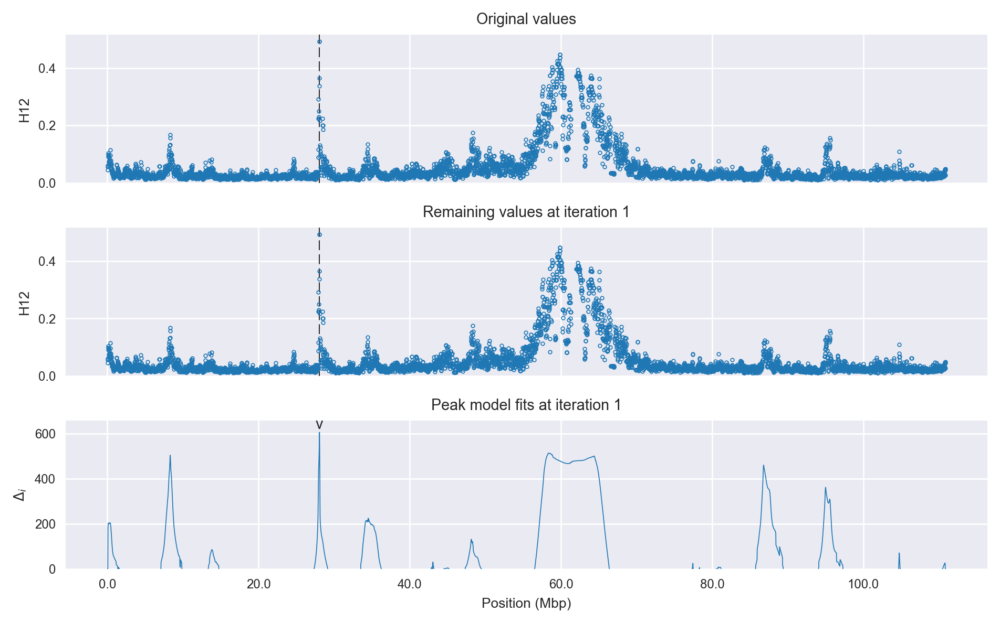

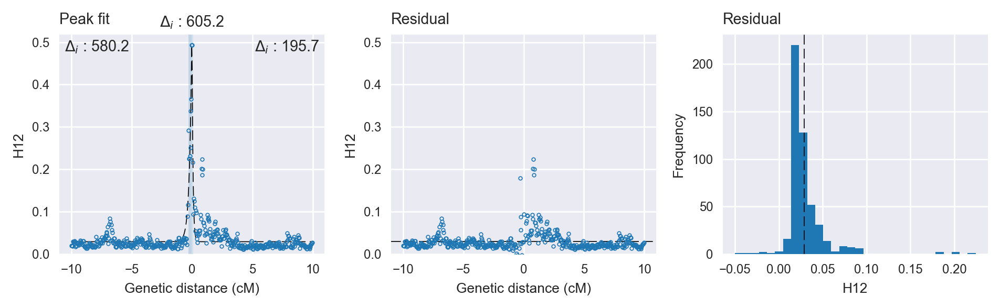

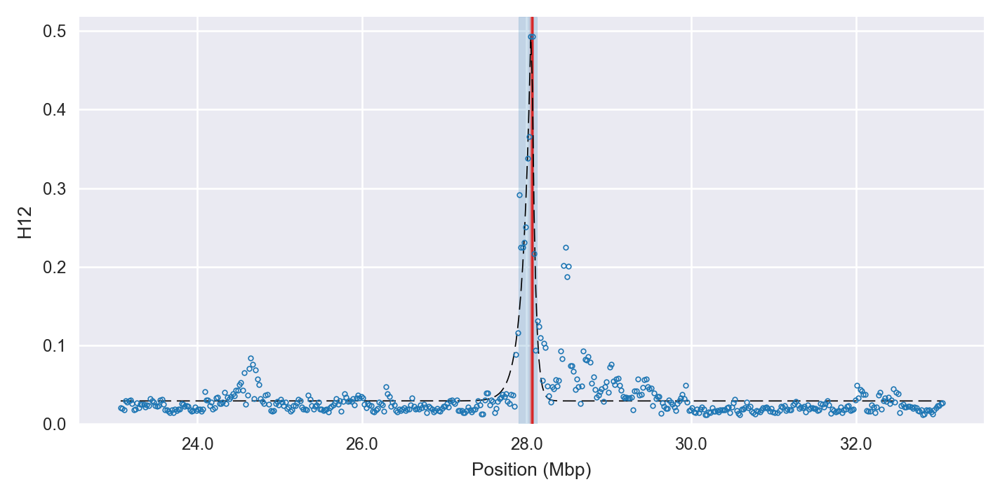

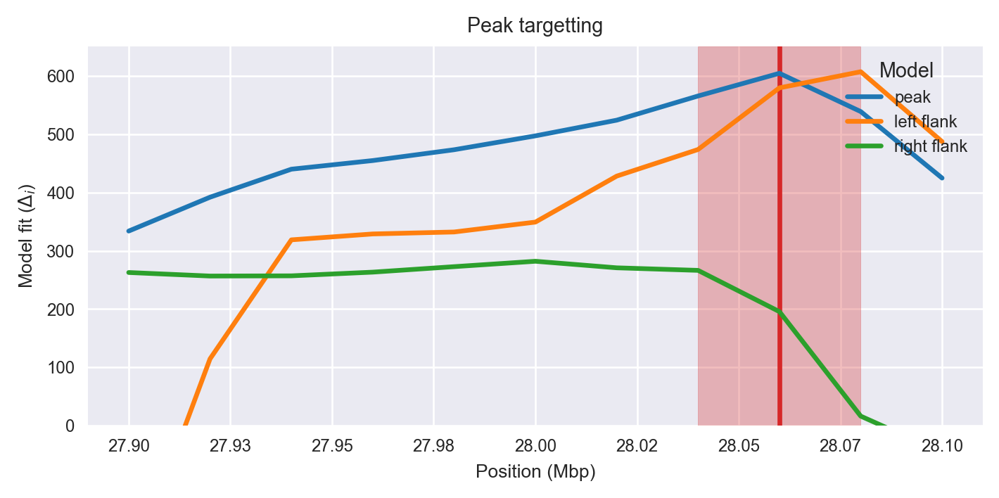

find the next peak
next peak: 2919 513.096
Iteration 2
Peak center (index, location): 2919, 58380001.0
Delta AIC: 513.1
Flank delta AICs: 101.1, 228.1
find limits of peak
peak limits: 57480001 66025105 2874 3303
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 70
    # data points      = 659
    # variables        = 4
    chi-square         = 3.599
    reduced chi-square = 0.005
    Akaike info crit   = -3425.410
    Bayesian info crit = -3407.447
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.21586472 +/- 0.007827 (3.63%) (init= 0.5)
    sigma:       1.99999999 +/- 0.009481 (0.47%) (init= 0.5)
    skew:       -0.99999998 +/- 0.015351 (1.54%) (init= 0)
    baseline:    0.09563365 +/- 0.005285 (5.53%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, baseline)       = -0.526 
    C(sigma, baseline)           = -

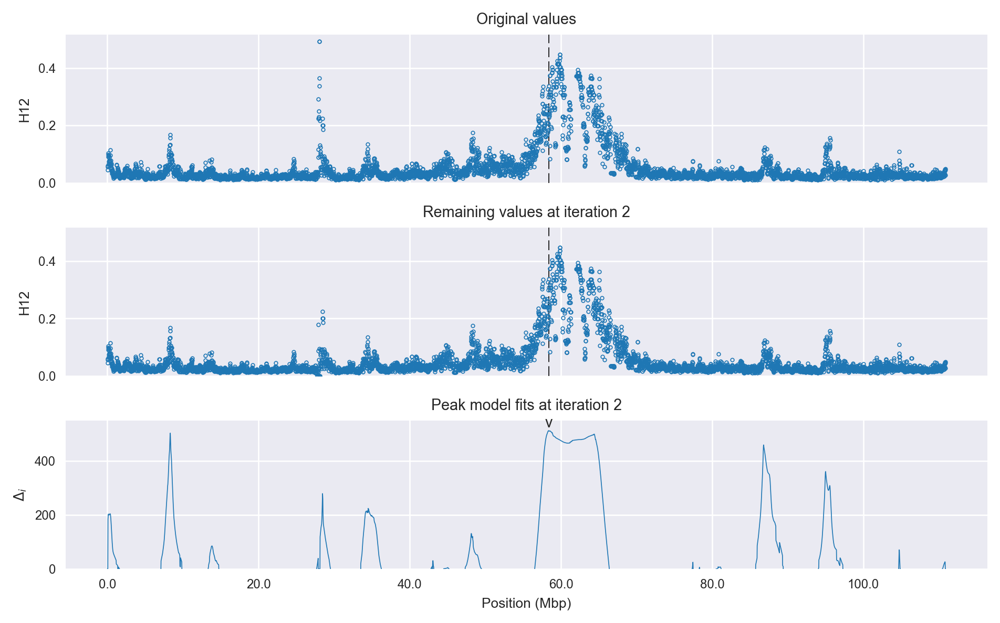

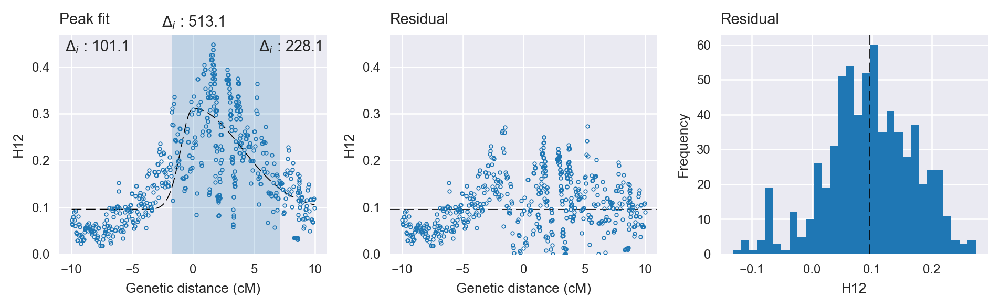

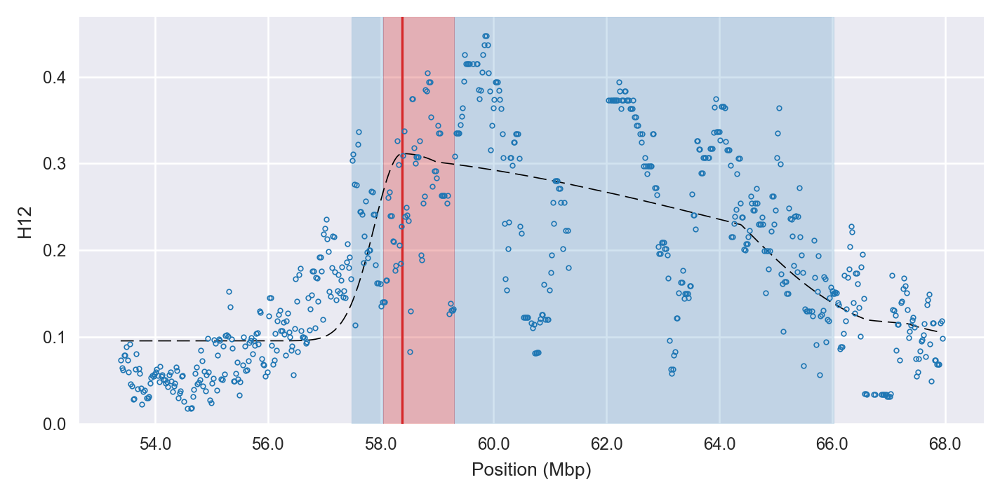

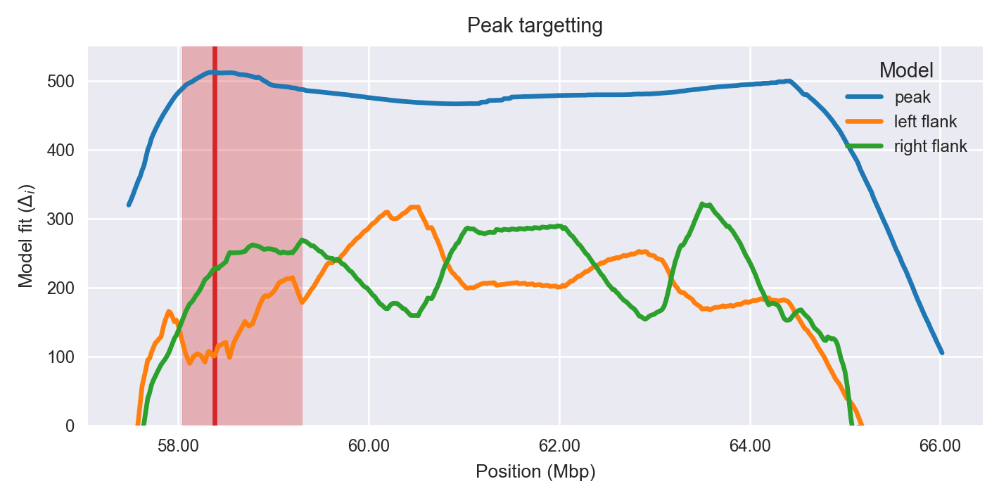

find the next peak
next peak: 416 504.017
Iteration 3
Peak center (index, location): 416, 8320001.0
Delta AIC: 504.0
Flank delta AICs: 282.9, 271.7
find limits of peak
peak limits: 7900001 8700000 395 436
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 33
    # data points      = 483
    # variables        = 4
    chi-square         = 0.061
    reduced chi-square = 0.000
    Akaike info crit   = -4327.443
    Bayesian info crit = -4310.723
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.10853333 +/- 0.004568 (4.21%) (init= 0.5)
    decay:       0.49010821 +/- 0.030949 (6.31%) (init= 0.5)
    skew:        0.06877197 +/- 0.060669 (88.22%) (init= 0)
    baseline:    0.02739973 +/- 0.000575 (2.10%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.667 
    C(decay, baseline)           =

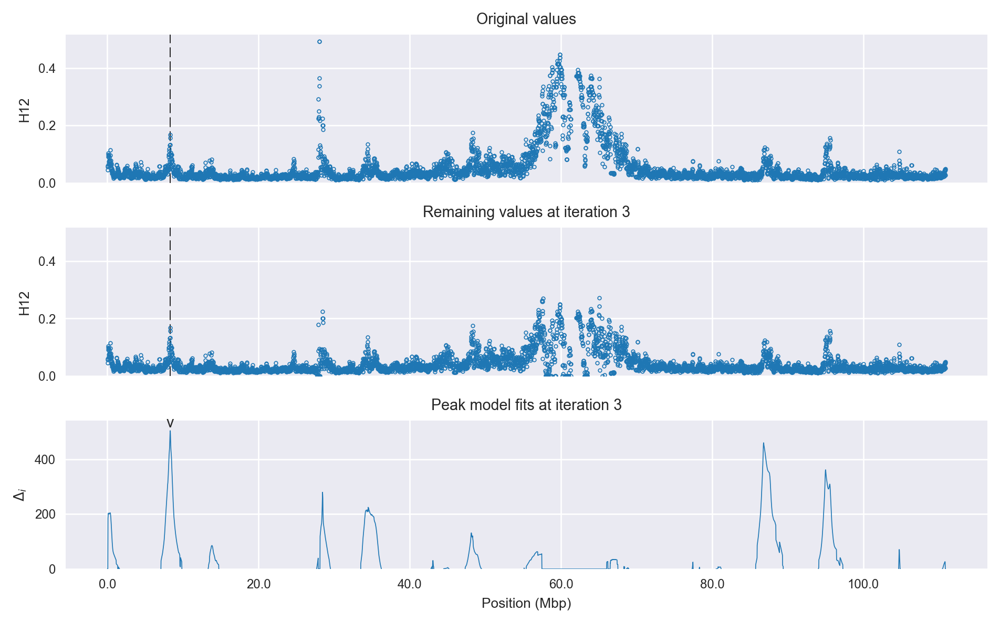

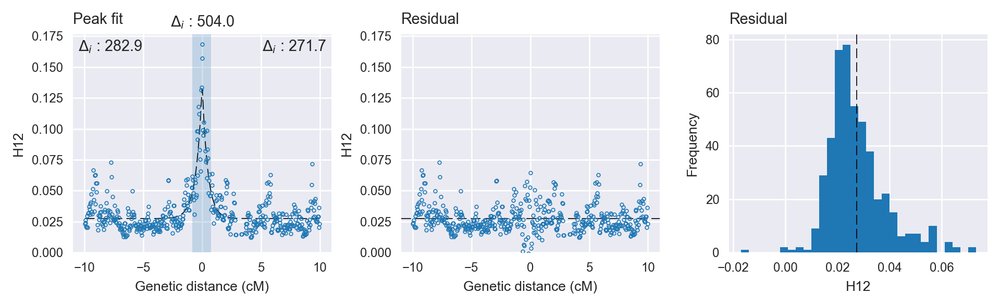

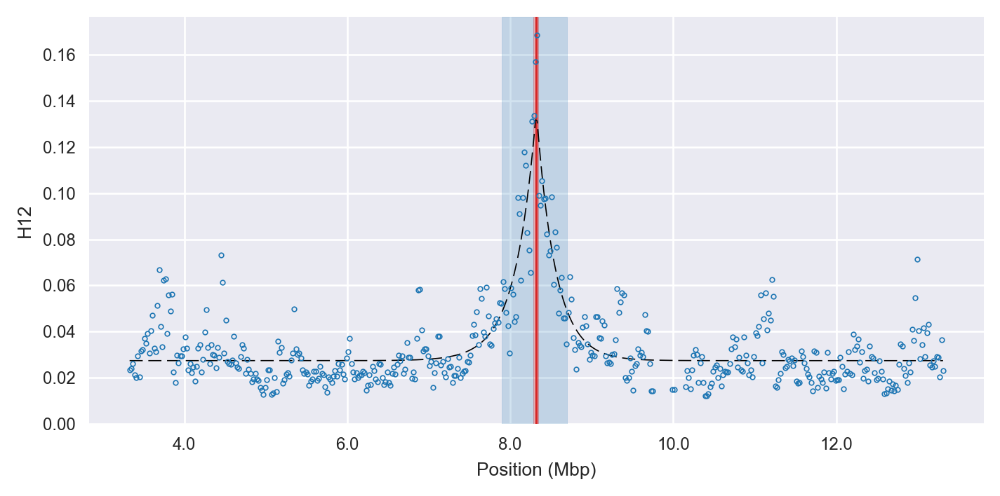

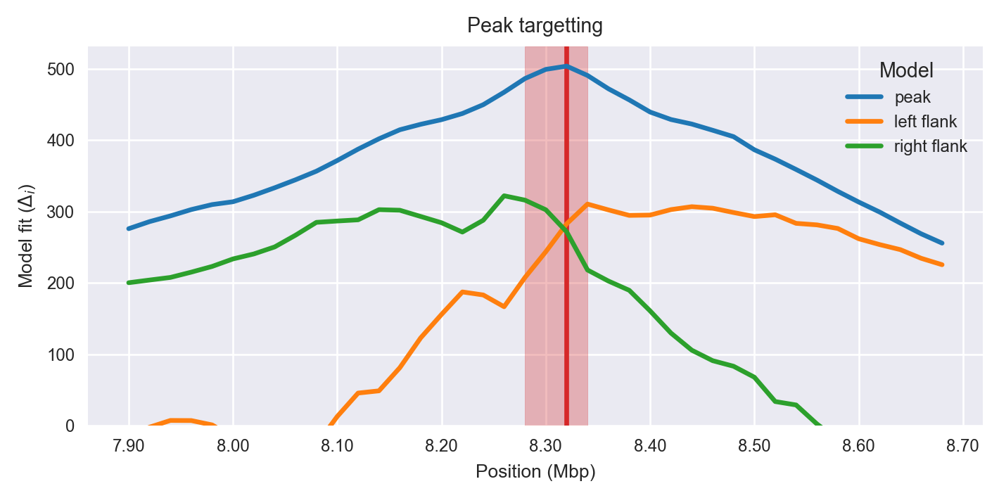

find the next peak
next peak: 4340 459.993
Iteration 4
Peak center (index, location): 4340, 86800001.0
Delta AIC: 460.0
Flank delta AICs: 194.1, 240.5
find limits of peak
peak limits: 86505106 88005105 4326 4402
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 48
    # data points      = 492
    # variables        = 4
    chi-square         = 0.063
    reduced chi-square = 0.000
    Akaike info crit   = -4399.237
    Bayesian info crit = -4382.443
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.07489004 +/- 0.003351 (4.47%) (init= 0.5)
    decay:       0.74021153 +/- 0.058724 (7.93%) (init= 0.5)
    skew:       -0.99999999 +/- 0.025945 (2.59%) (init= 0)
    baseline:    0.02496898 +/- 0.000647 (2.59%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.562 
    C(decay, baseline)      

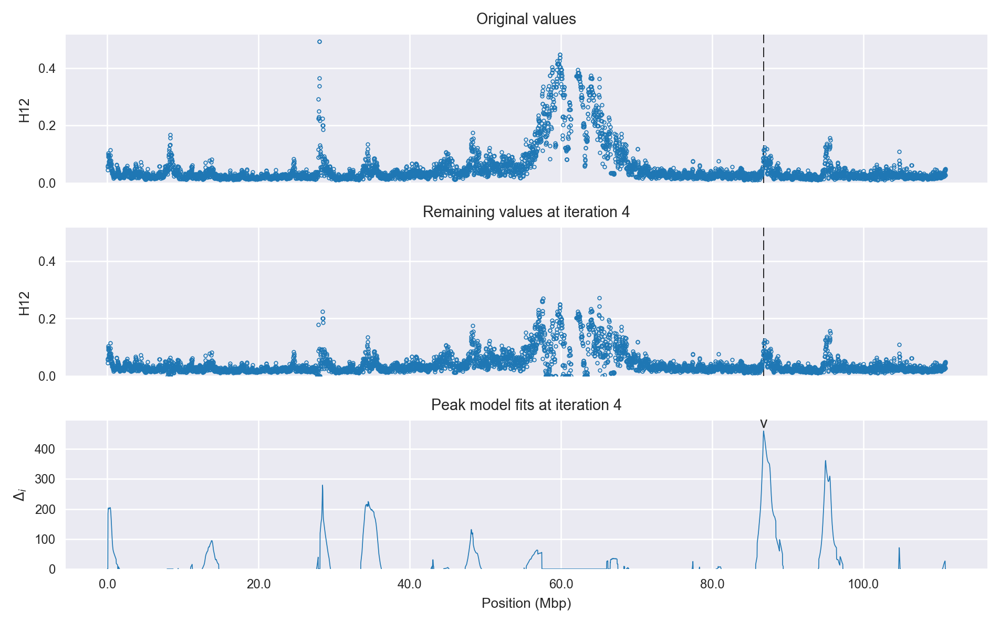

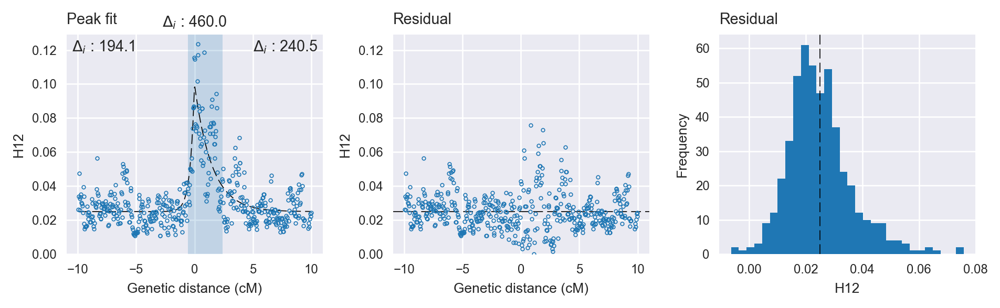

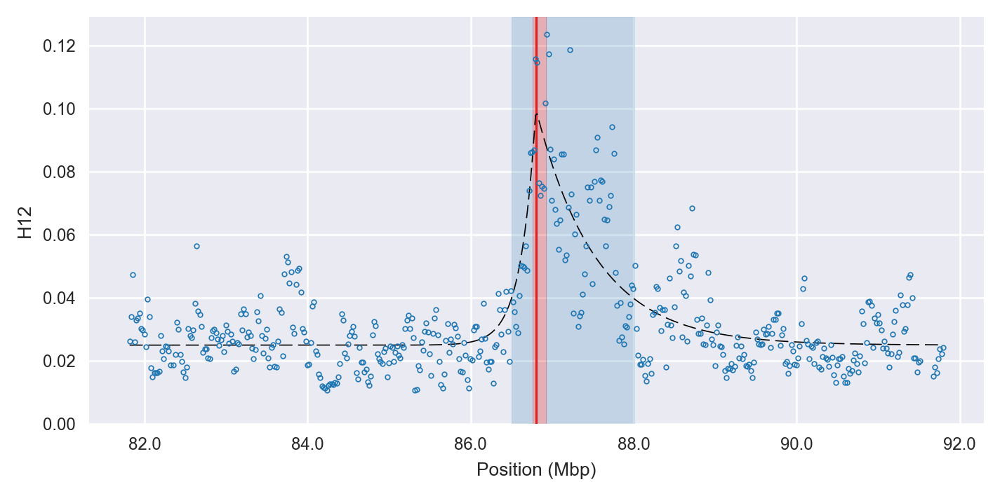

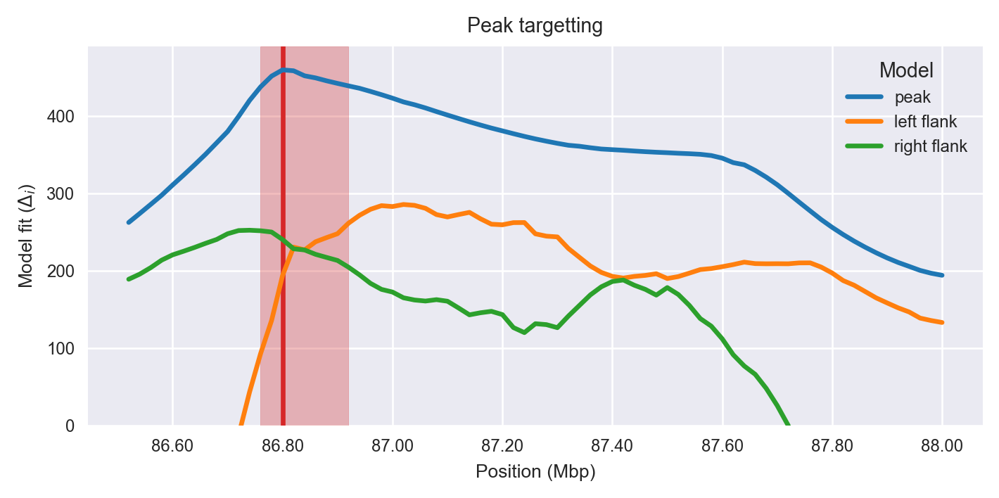

find the next peak
next peak: 4750 362.583
Iteration 5
Peak center (index, location): 4750, 95000001.0
Delta AIC: 362.6
Flank delta AICs: 250.7, 164.6
find limits of peak
peak limits: 94765106 95945105 4739 4799
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 54
    # data points      = 489
    # variables        = 4
    chi-square         = 0.099
    reduced chi-square = 0.000
    Akaike info crit   = -4150.608
    Bayesian info crit = -4133.839
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.08972328 +/- 0.004760 (5.31%) (init= 0.5)
    decay:       0.57755684 +/- 0.052864 (9.15%) (init= 0.5)
    skew:       -0.99999999 +/- 0.038233 (3.82%) (init= 0)
    baseline:    0.02389523 +/- 0.000769 (3.22%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.579 
    C(decay, skew)          

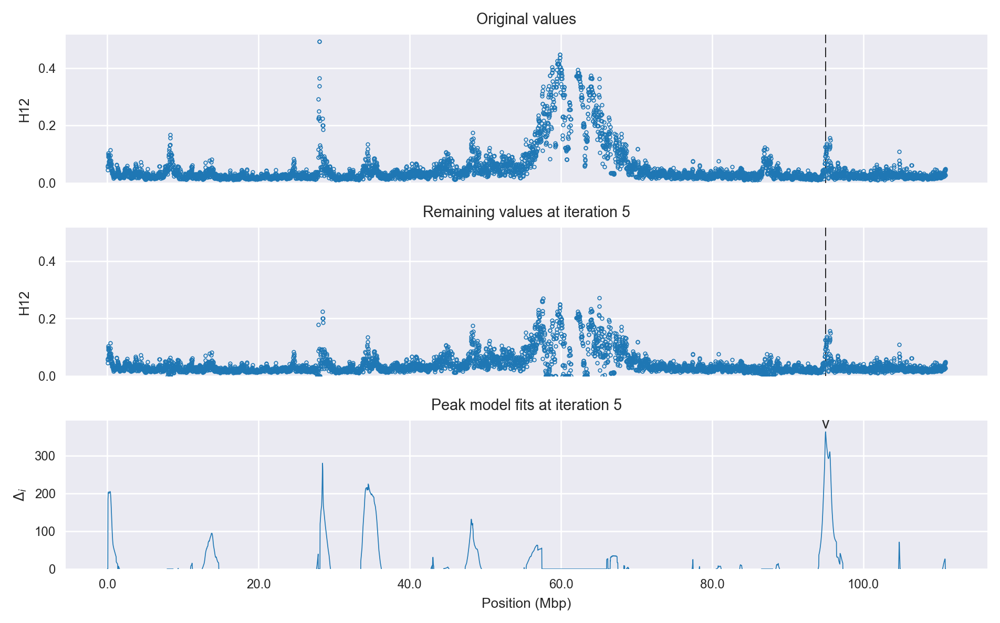

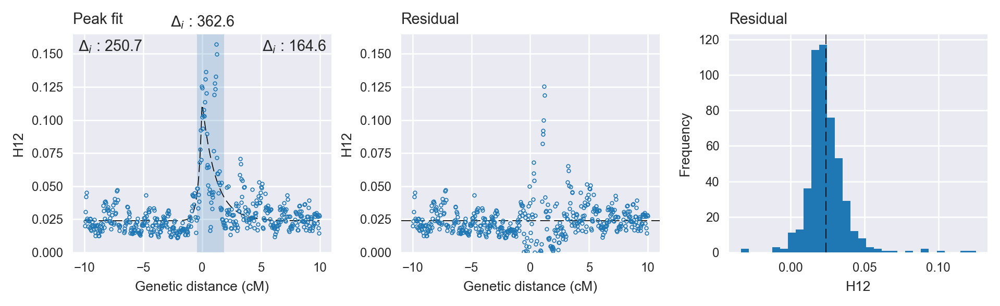

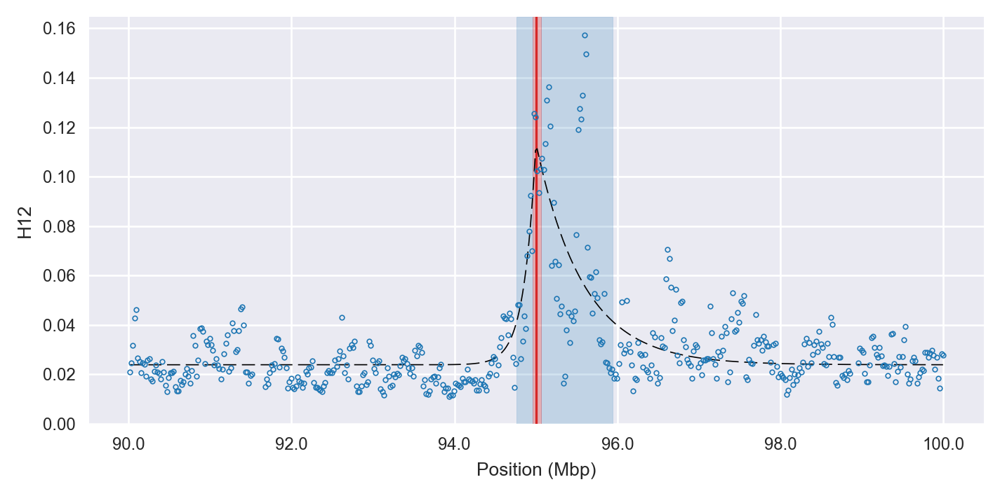

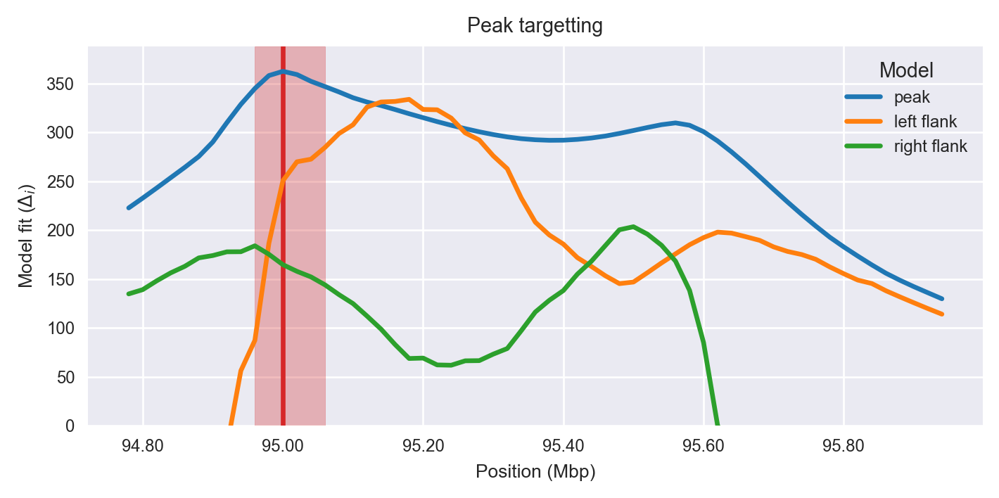

find the next peak
next peak: 1423 279.691
Iteration 6
Peak center (index, location): 1423, 28460001.0
Delta AIC: 279.7
Flank delta AICs: 97.3, 266.9
find limits of peak
peak limits: 28400001 28640000 1420 1433
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 158
    # data points      = 499
    # variables        = 4
    chi-square         = 0.133
    reduced chi-square = 0.000
    Akaike info crit   = -4098.722
    Bayesian info crit = -4081.872
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.20303844 +/- 0.012857 (6.33%) (init= 0.5)
    decay:       0.12525355 +/- 0.011890 (9.49%) (init= 0.5)
    skew:       -0.66854529 +/- 0.097936 (14.65%) (init= 0)
    baseline:    0.02637124 +/- 0.000755 (2.86%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.682 
    C(decay, skew)         

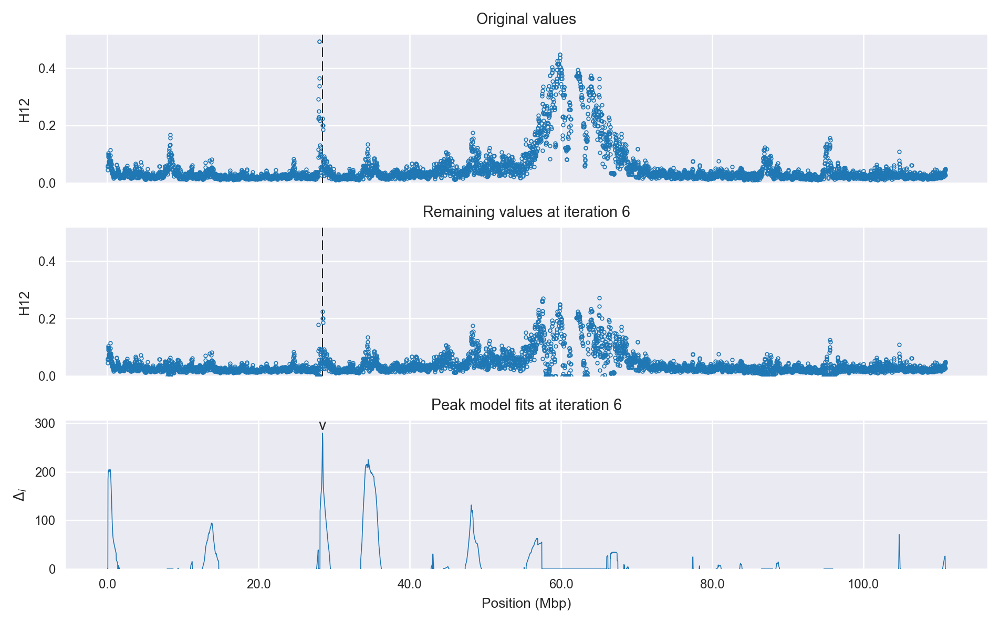

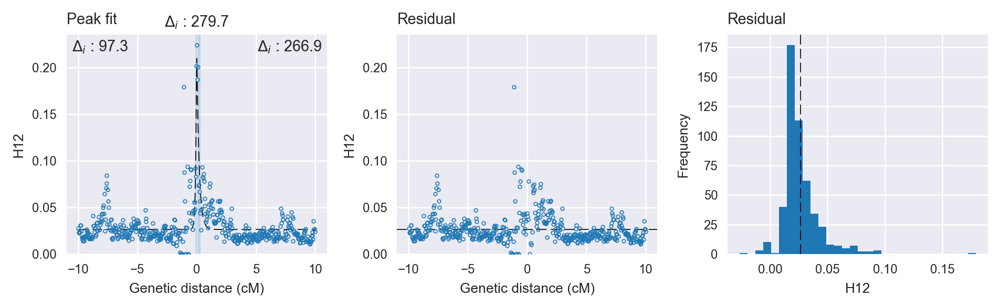

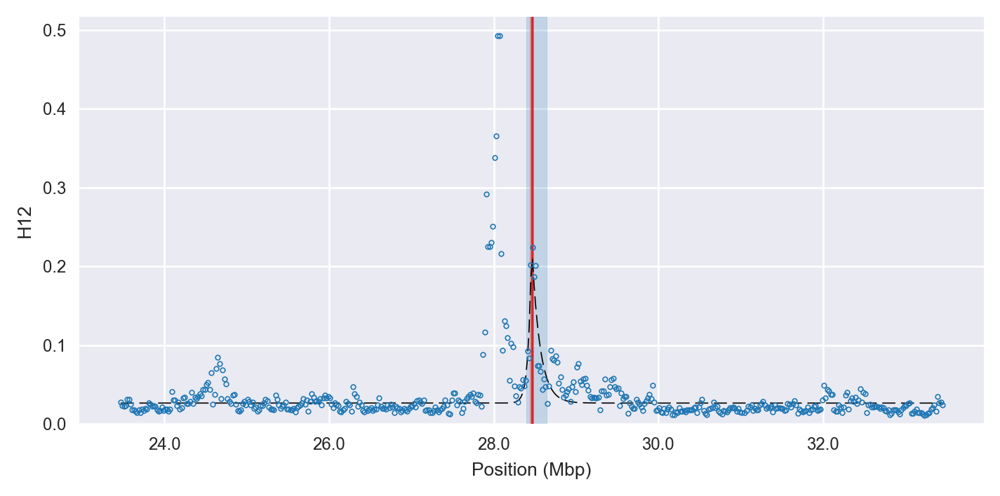

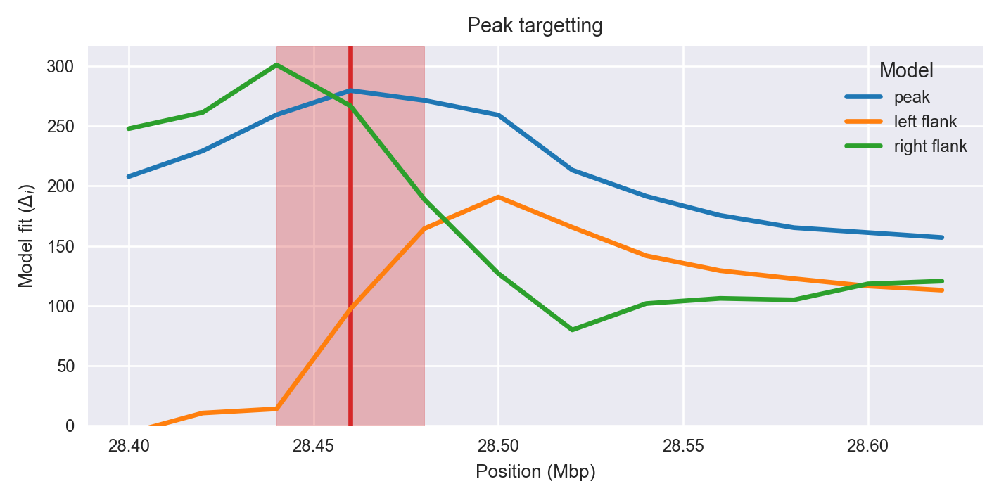

find the next peak
next peak: 1725 224.803
Iteration 7
Peak center (index, location): 1725, 34500001.0
Delta AIC: 224.8
Flank delta AICs: 190.7, 56.5
find limits of peak
peak limits: 33600001 36140000 1680 1808
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 118
    # data points      = 497
    # variables        = 4
    chi-square         = 0.077
    reduced chi-square = 0.000
    Akaike info crit   = -4353.588
    Bayesian info crit = -4336.754
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.03392538 +/- 0.001989 (5.87%) (init= 0.5)
    sigma:       1.36073295 +/- 0.100307 (7.37%) (init= 0.5)
    skew:       -0.43164802 +/- 0.080652 (18.68%) (init= 0)
    baseline:    0.02362850 +/- 0.000711 (3.01%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, baseline)           = -0.401 
    C(amplitude, sigma)          = 

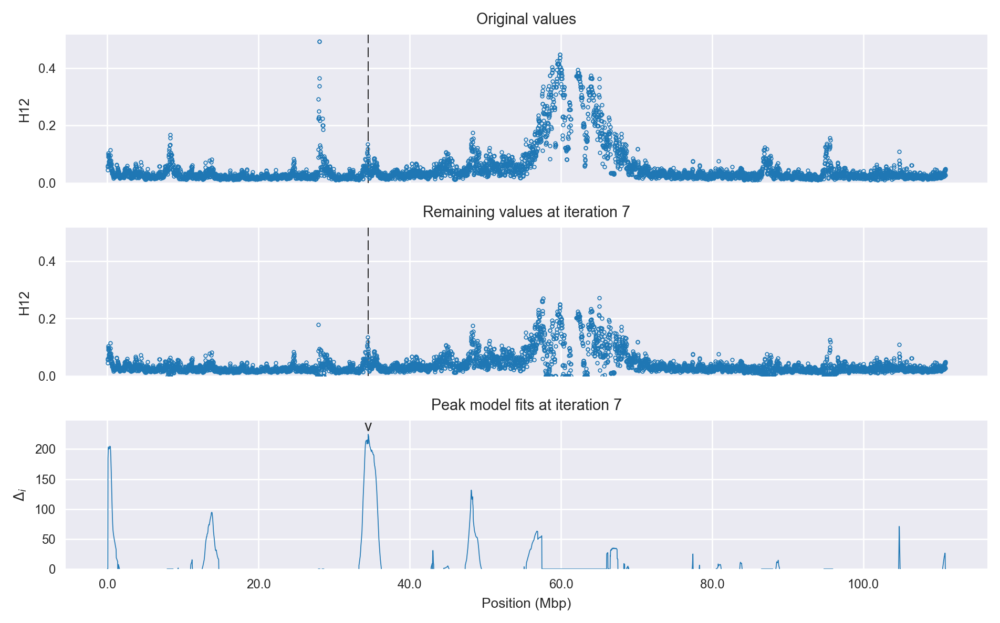

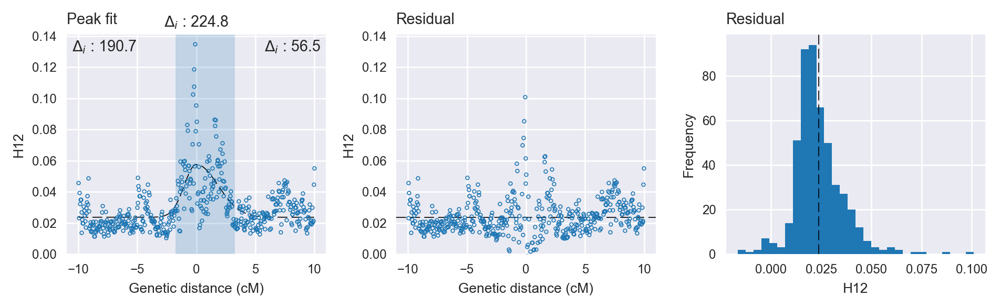

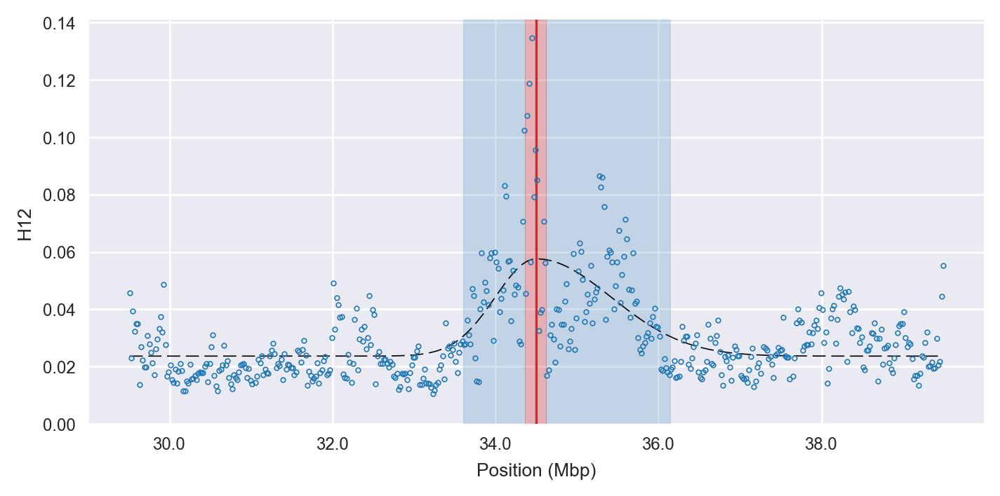

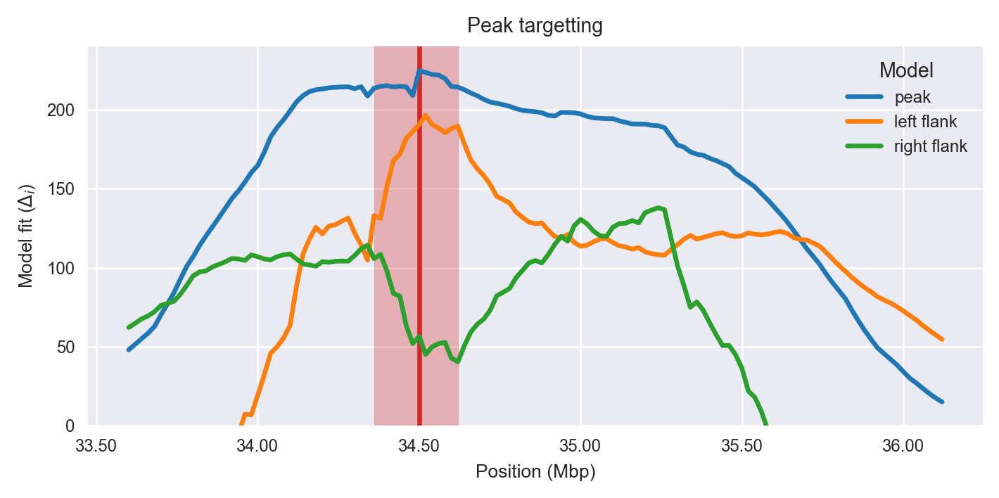

find the next peak
next peak: 17 205.003
Iteration 8
Peak center (index, location): 17, 340001.0
Delta AIC: 205.0
Flank delta AICs: 2.6, 112.4
find limits of peak
peak limits: 20001 620000 1 32
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 33
    # data points      = 264
    # variables        = 4
    chi-square         = 0.036
    reduced chi-square = 0.000
    Akaike info crit   = -2338.237
    Bayesian info crit = -2323.934
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.05166687 +/- 0.003629 (7.02%) (init= 0.5)
    sigma:       0.51459053 +/- 0.107180 (20.83%) (init= 0.5)
    skew:        0.77325380 +/- 0.259810 (33.60%) (init= 0)
    baseline:    0.03062770 +/- 0.000784 (2.56%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               =  0.837 
    C(amplitu

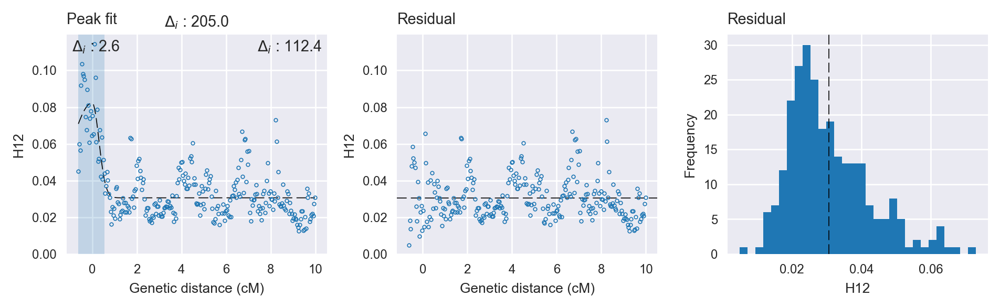

find the next peak
next peak: 2407 131.629
Iteration 8
Peak center (index, location): 2407, 48140001.0
Delta AIC: 131.6
Flank delta AICs: 38.6, 65.7
find limits of peak
peak limits: 48000001 48740000 2400 2438
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_exponential_peak)
[[Fit Statistics]]
    # function evals   = 64
    # data points      = 485
    # variables        = 4
    chi-square         = 0.222
    reduced chi-square = 0.000
    Akaike info crit   = -3722.110
    Bayesian info crit = -3705.373
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.08957517 +/- 0.009069 (10.13%) (init= 0.5)
    decay:       0.36326043 +/- 0.063050 (17.36%) (init= 0.5)
    skew:       -0.99999402 +/- 0.188376 (18.84%) (init= 0)
    baseline:    0.05064029 +/- 0.001077 (2.13%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, decay)          = -0.597 
    C(decay, skew)         

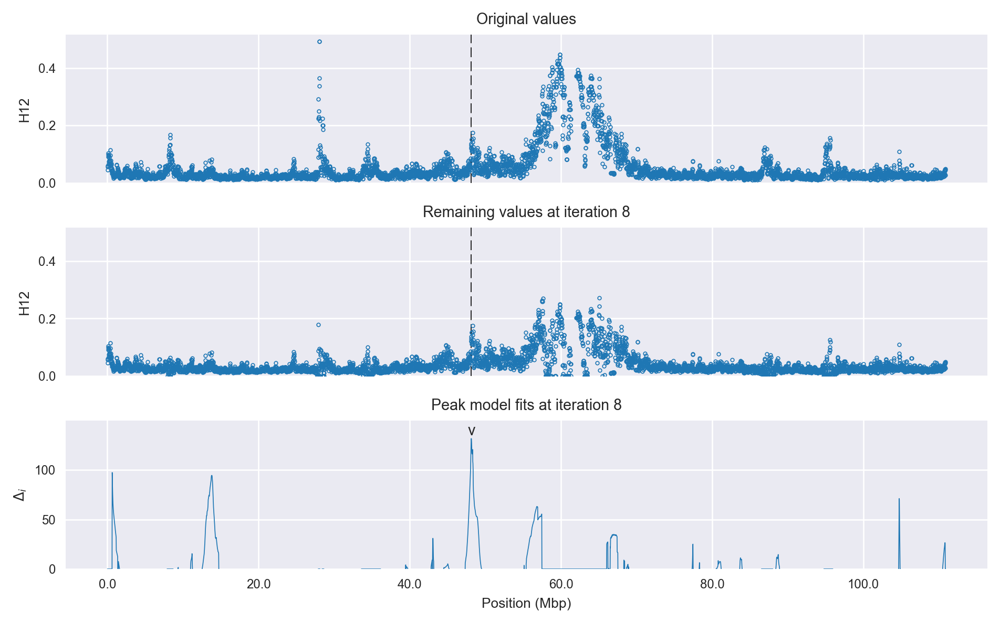

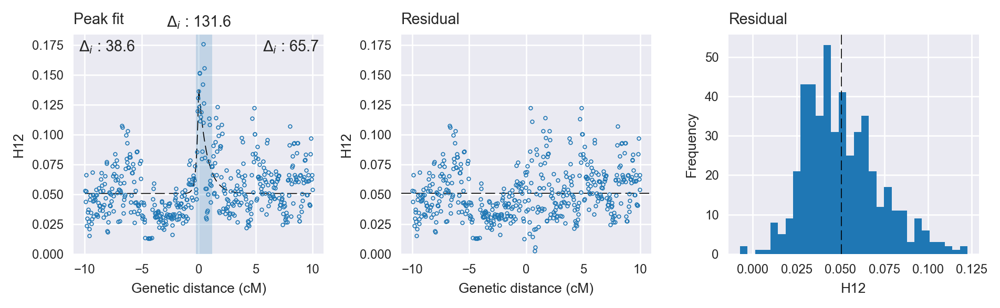

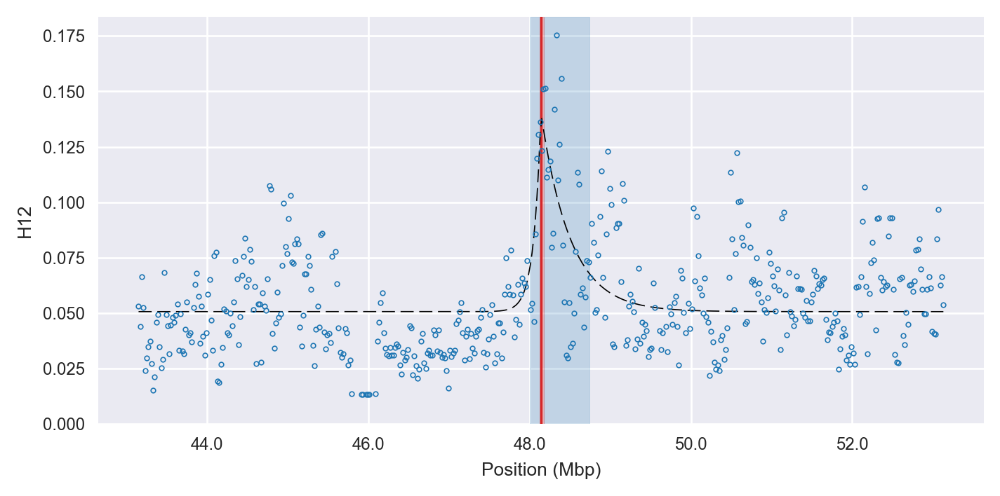

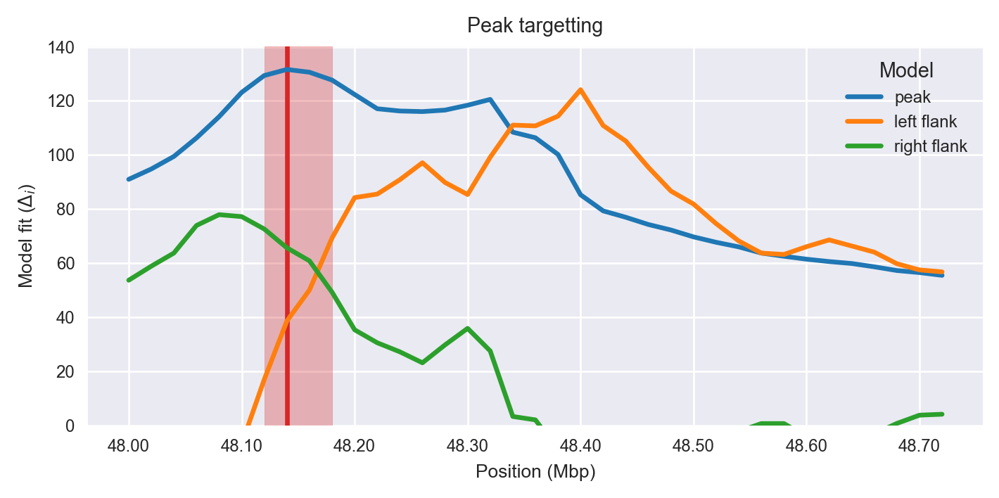

find the next peak
next peak: 32 97.3557
Iteration 9
Peak center (index, location): 32, 640001.0
Delta AIC: 97.4
Flank delta AICs: -9.7, -55.4
find limits of peak
peak limits: 20001 920000 1 47
check flank fits
POOR FLANK: SKIPPING PEAK
plot some diagnostics for the peak fit
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 71
    # data points      = 279
    # variables        = 4
    chi-square         = 0.058
    reduced chi-square = 0.000
    Akaike info crit   = -2359.788
    Bayesian info crit = -2345.263
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.03410105 +/- 0.003652 (10.71%) (init= 0.5)
    sigma:       0.62129765 +/- 0.126891 (20.42%) (init= 0.5)
    skew:        0.99999989 +/- 0.239467 (23.95%) (init= 0)
    baseline:    0.03037894 +/- 0.000959 (3.16%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(amplitude, sigma)          = -0.599 
    C(sigma,

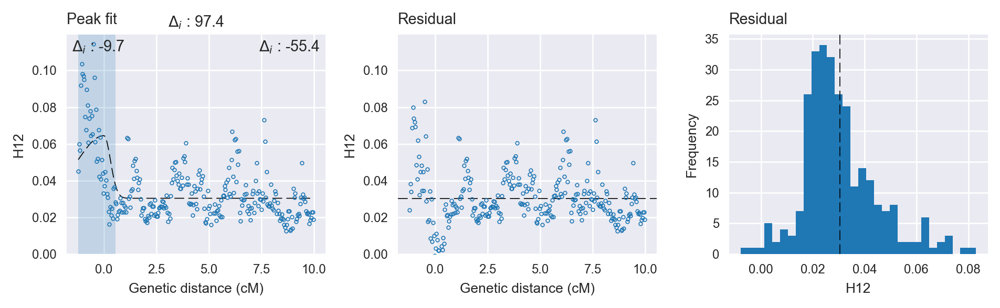

find the next peak
next peak: 691 94.4539
Iteration 9
Peak center (index, location): 691, 13820001.0
Delta AIC: 94.5
Flank delta AICs: 31.9, 34.6
find limits of peak
peak limits: 12880001 14060000 644 704
check flank fits
FLANK OK: PROCESSING PEAK
[[Model]]
    Model(skewed_gaussian)
[[Fit Statistics]]
    # function evals   = 45
    # data points      = 483
    # variables        = 4
    chi-square         = 0.043
    reduced chi-square = 0.000
    Akaike info crit   = -4496.387
    Bayesian info crit = -4479.667
[[Variables]]
    center:      0 (fixed)
    amplitude:   0.02163806 +/- 0.002180 (10.08%) (init= 0.5)
    sigma:       0.52399766 +/- 0.072522 (13.84%) (init= 0.5)
    skew:        0.99999977 +/- 0.014137 (1.41%) (init= 0)
    baseline:    0.02371713 +/- 0.000476 (2.01%) (init= 0.05)
    ceiling:     1 (fixed)
    floor:       0 (fixed)
[[Correlations]] (unreported correlations are <  0.100)
    C(sigma, skew)               = -0.509 
    C(amplitude, sigma)          = -0.439

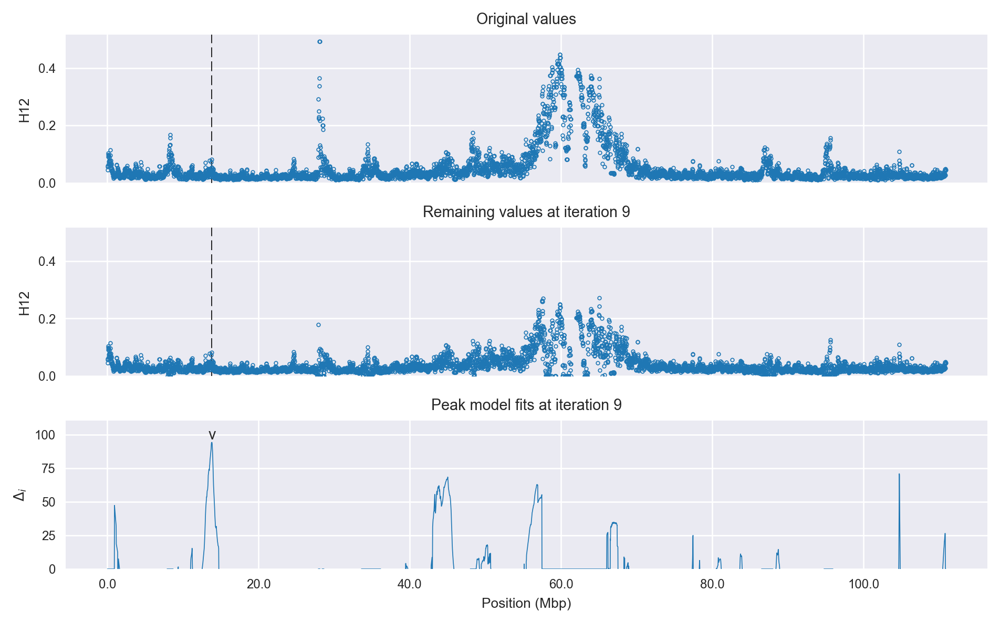

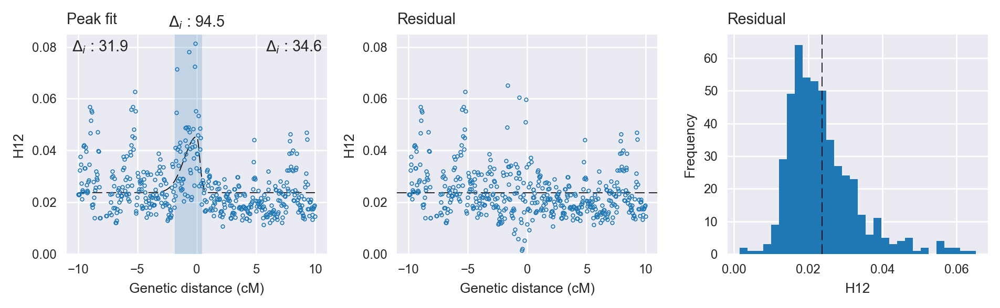

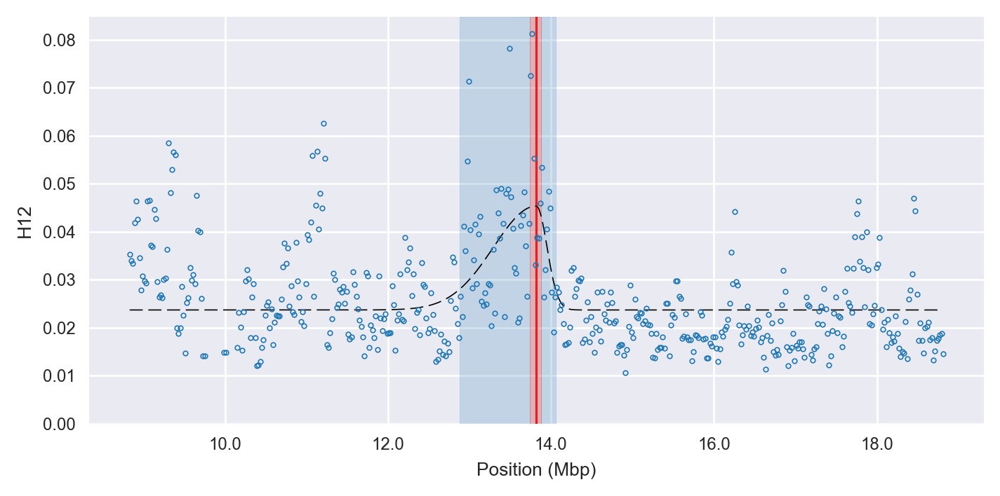

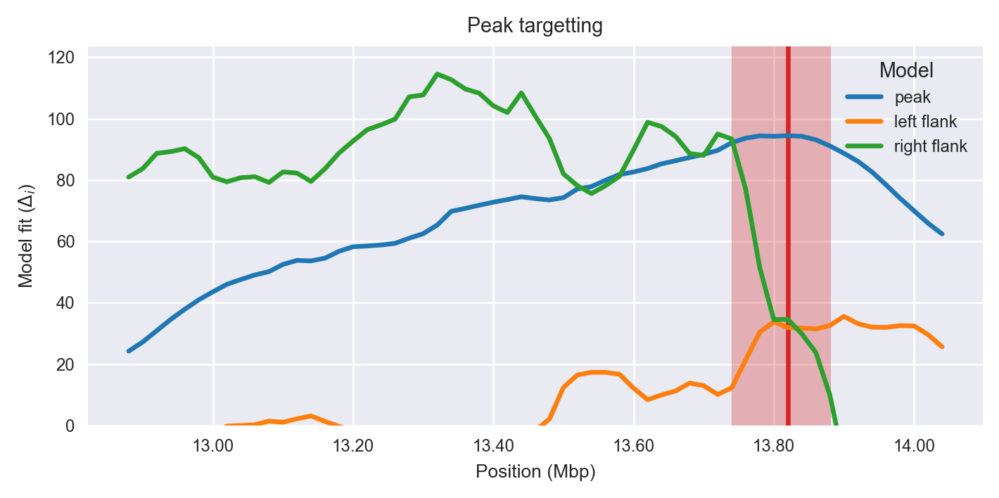

find the next peak
next peak: 5237 71.0616
all done


In [24]:
peaks = peakfit.find_peaks(starts=starts, ends=ends, values=values, percentiles=percentiles, centers=centers, 
                           gflank=10, gmap=gmap['2'], fitters=[skewed_gauss_fitter, skewed_exp_fitter], show_plots=True, 
                           statistic_label='H12', log_file=None)
peaks = list(peaks)